# 컨볼루션 신경망(Convolution Neural Networks, CNN) Summary

- 완전 연결 네트워크의 문제점으로부터 시작
  - 매개변수의 폭발적인 증가
  - `공간 추론의 부족: 픽셀 사이의 근접성 개념이 완전 연결 계층(Fully-Connected Layer)에서는 손실됨`
- 동물의 시각피질(visual cortex, 視覺皮質)의 구조에서 영감을 받아 만들어진 딥러닝 신경망 모델
- 시각피질의 신경세포
  - 시야 내의 특정 영역에 대한 자극만 수용
  - 수용장(receptive field, 受容場)
  - 해당 영역의 특정 특징에 대해서만 반응
- 시각 자극이 1차 시각피질을 통해서 처리된 다음, 2차 시각피질을 경유하여, 3차 시각피질 등 여러 영역을 통과하여 계층적인 정보처리
- 정보가 계층적으로 처리되어 가면서 점차 추상적인 특징이 추출되어 시각 인식
- 동물의 계층적 특징 추출과 시각인식 체계를 참조하여 만들어진 모델
  - 전반부 : 컨볼루션 연산을 수행하여 특징 추출
  - 후반부 : 특징을 이용하여 분류
- `영상분류, 문자 인식 등 인식문제에 높은 성능`

```
<~~~ Note ~~~>
- 완전 연결 네트워크 : Dense로 연결된 네트워크
- 시각피질의 신경세포 중 수용장의 기능을 유사하게 만든 것이 CNN
- 정보가 계층적으로 처리되는 방식
- CNN : conv layer + clf
```

  <img src="https://upload.wikimedia.org/wikipedia/commons/6/63/Typical_cnn.png">

## 1. 컨볼루션 연산 (Convolution Operation)

```
<~~~ Note ~~~>
- filter = kernel : Conv2D의 인수로 사용함
```

- 필터(filter) 연산
  - 입력 데이터에 필터를 통한 어떠한 연산을 진행
  - 필터에 대응하는 원소끼리 곱하고, 그 합을 구함
  - 연산이 완료된 결과 데이터를 **특징 맵(feature map)**이라 부름

- 필터(filter)
  - 커널(kernel)이라고도 함
  - 이미지 처리에서 사용하는 '이미지 필터'와 비슷한 개념
  - 필터의 사이즈는 거의 항상 홀수
    - `짝수이면 패딩이 비대칭이 되어버림`
    - 왼쪽, 오른쪽을 다르게 주어야함
    - 중심위치가 존재, 즉 구별된 하나의 픽셀(중심 픽셀)이 존재
  - 필터의 학습 파라미터 개수는 입력 데이터의 크기와 상관없이 일정  
  - 과적합을 방지할 수 있음

<img src="https://theano-pymc.readthedocs.io/en/latest/_images/numerical_padding_strides.gif">

- 연산 시각화
   - Input을 Kernel이 돌아다니면서 새로운 행렬을 만듦

<img src="https://www.researchgate.net/profile/Ihab_S_Mohamed/publication/324165524/figure/fig3/AS:611103423860736@1522709818959/An-example-of-convolution-operation-in-2D-2.png" width="500">

- 일반적으로, 합성곱 연산을 한 후의 데이터 사이즈

  $\quad (n-f+1) \times (n-f+1)$

  $n$: 입력 데이터의 크기  
  $f$: 필터(커널)의 크기

  <img src="https://miro.medium.com/max/1400/1*Fw-ehcNBR9byHtho-Rxbtw.gif" width="400">

- 위 예에서 입력 데이터 크기($n$)는 5, 필터의 크기($k$)는 3이므로 출력 데이터의 크기는 $(5 - 3 + 1) = 3$

## CNN 구현해 보기

### 샘플 이미지 로드

In [1]:
import tensorflow as tf
tf.__version__

'2.10.0'

In [2]:
from sklearn.datasets import load_sample_image
from tensorflow.keras.layers import Conv2D

In [3]:
%matplotlib inline

uint8
(427, 640, 3)


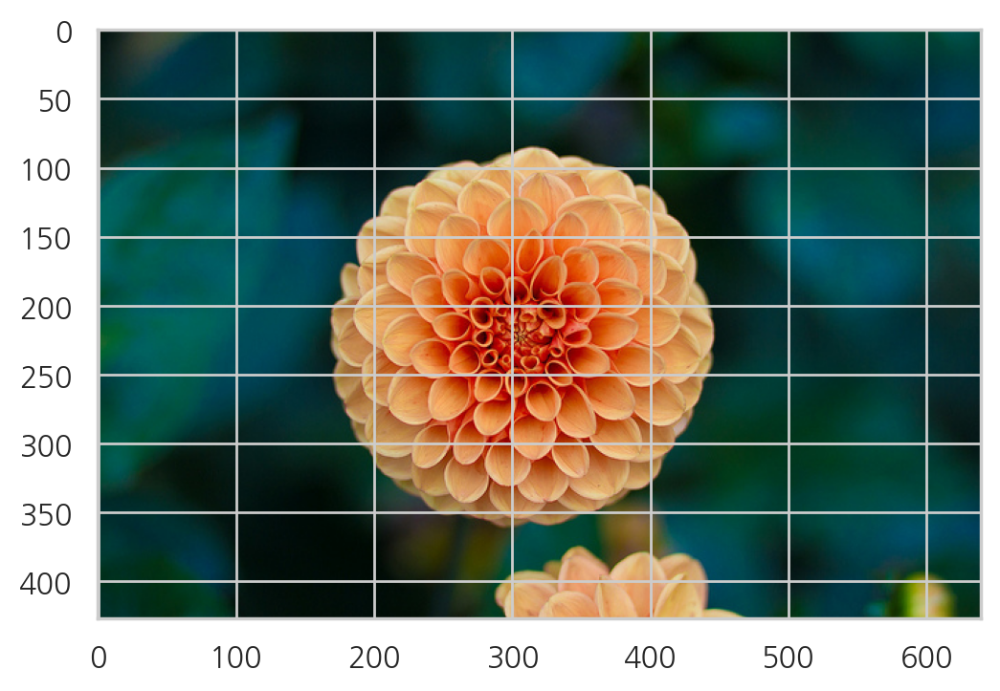

In [4]:
flower = load_sample_image("flower.jpg")

print(flower.dtype)
print(flower.shape)

plt.imshow(flower)
plt.show() ; 

uint8
(427, 640, 3)


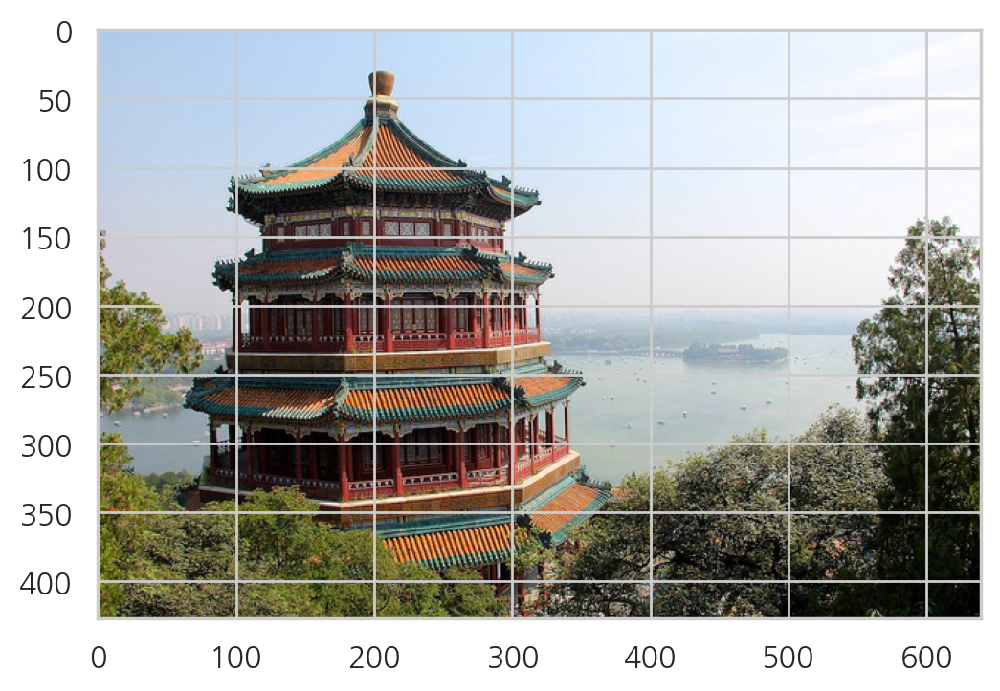

In [5]:
china = load_sample_image("china.jpg")

print(china.dtype)
print(china.shape)

plt.imshow(china)
plt.show() ; 

### image normalization

float64
(427, 640, 3)


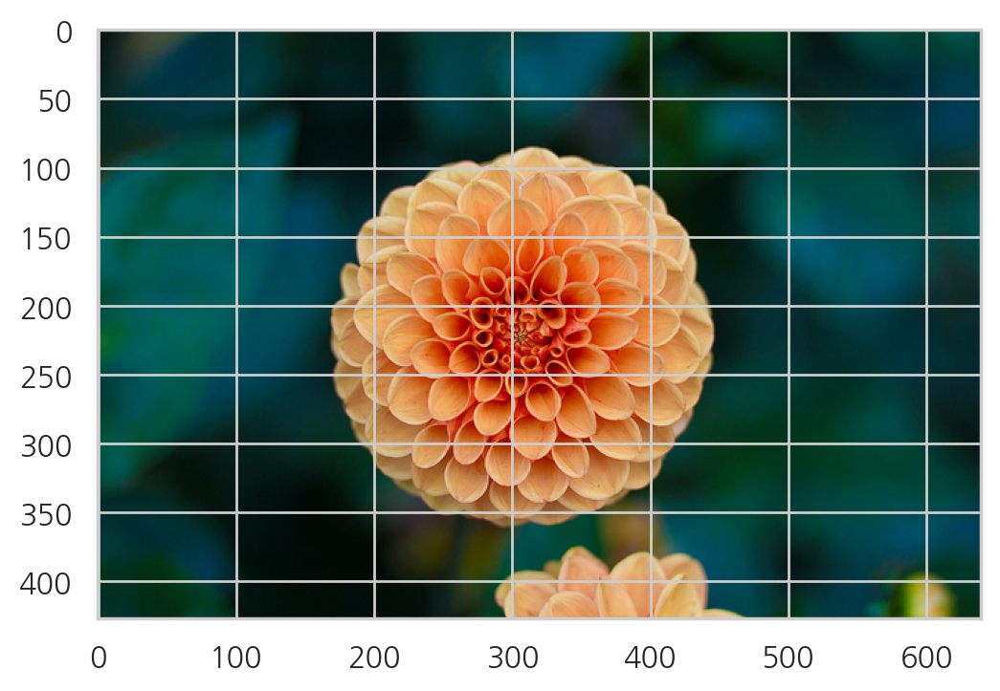

In [6]:
flower = load_sample_image("flower.jpg") / 255.0

print(flower.dtype)
print(flower.shape)

plt.imshow(flower)
plt.show() ; 

float64
(427, 640, 3)


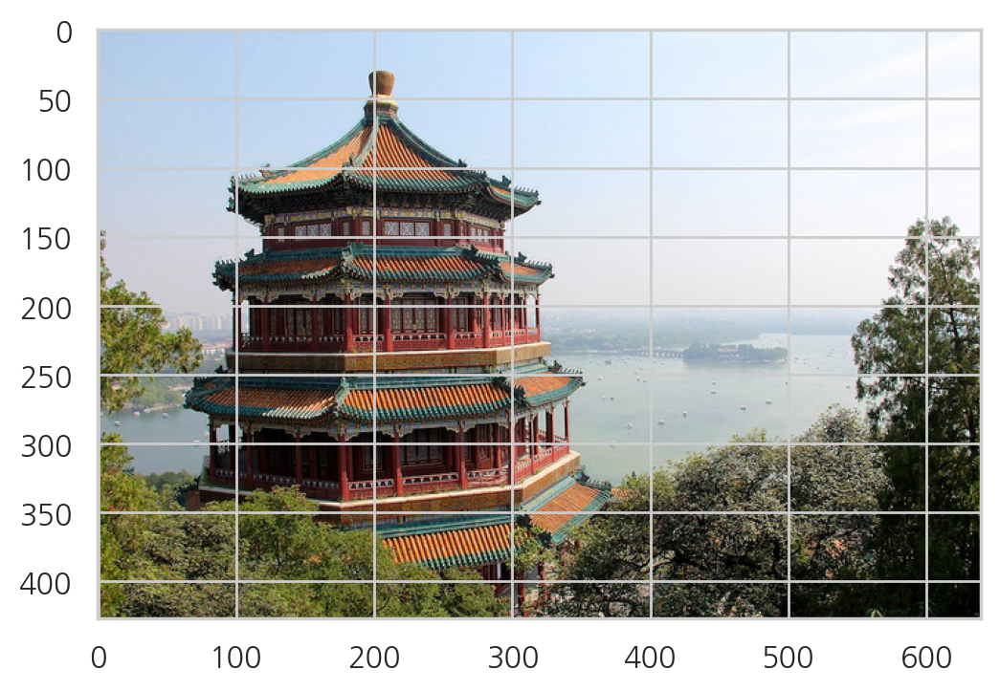

In [7]:
china = load_sample_image("china.jpg") / 255.0

print(china.dtype)
print(china.shape)

plt.imshow(china)
plt.show() ; 

### image batch

In [12]:
# 두 개 이미지를 하나의 배열에 저장
images = np.array([china, flower])
batch_size, height, width, channels = images.shape

# 이미지 갯수, 이미지 높이, 폭, 채널수
print(batch_size, height, width, channels)

2 427 640 3


In [13]:
images.shape

(2, 427, 640, 3)

### CNN의 filter 구현

In [16]:
filters = np.zeros(shape=(7, 7, channels, 2), dtype=np.float32)
# 제로텐서에 특정갑으로 1을 저장 : filter 생성
filters[:, 3, :, 0] = 1
filters[3, :, :, 1] = 1

filters.shape

(7, 7, 3, 2)

In [18]:
conv = Conv2D(filters=16, kernel_size=3, activation="relu")
conv

## 2. 패딩(Padding)과 스트라이드(Stride)

- 필터(커널) 사이즈과 함께 입력 이미지와 출력 이미지의 사이즈를 결정하기 위해 사용
- 사용자가 결정할 수 있음


### 2-1. 패딩(Padding)

- 입력 데이터의 주변을 특정 값으로 채우는 기법
  - 주로 0으로 많이 채움

  <img src="https://miro.medium.com/max/395/1*1okwhewf5KCtIPaFib4XaA.gif" width="300">

- 출력 데이터의 크기

  $\quad (n+2p-f+1) \times (n+2p-f+1)$

  - 위 그림에서, 입력 데이터의 크기($n$)는 5, 필터의 크기($f$)는 3, 패딩값($p$)은 2이므로 출력 데이터의 크기는 ($5 + 2\times 1 - 3 + 1) = 5$

- `valid`
  - 패딩을 주지 않음
  - `padding=0`은 0으로 채워진 테두리가 아니라 패딩을 주지 않는다는 의미
  - `0으로 채우는 것이 아니라 아예 패딩을 사용하지 않음`
- `same`
  - 패딩을 주어 입력 이미지의 크기와 연산 후의 이미지 크기를 같도록 유지
  - 만약, 필터(커널)의 크기가 $k$ 이면, 패딩의 크기는 $p = \frac{k-1}{2}$ (단, stride=1)

### 2-2. 스트라이드(Stride)

- `필터를 적용하는 간격을 의미`
- 아래 예제 그림은 간격이 2

  <img src="https://miro.medium.com/max/294/1*BMngs93_rm2_BpJFH2mS0Q.gif">

### 출력 데이터의 크기

  $\qquad OH = \frac{H + 2P - FH}{S} + 1 $
  
  $\qquad OW = \frac{W + 2P - FW}{S} + 1 $

  - 입력 크기 : $(H, W)$
  - 필터 크기 : $(FH, FW)$
  - 출력 크기 : $(OH, OW)$
  - 패딩, 스트라이드 : $P, S$

- 위 식의 값에서 $\frac{H + 2P - FH}{S}$ 또는 $\frac{W + 2P - FW}{S}$가 `정수로 나누어 떨어지는 값이어야 함`
- 정수로 나누어 떨어지지 않으면, 패딩, 스트라이드 값을 조정하여 정수로 나누어 떨어지게 해야함
  
  

### CNN 테스트
- 출력크기는 정수로 떨어져야 한다. 
- input 데이터의 크기, filter의 크기, kernel size, padding, strides 값을 계산
- 이것을 쉽게 할 수 있도록, padding="same", strides=1을 적용하면 알아서 처리해준다.

In [20]:
conv = Conv2D(filters=16, kernel_size=3, padding="same", strides=1, activation="relu")
conv

## 3. 풀링(Pooling)

- 필터(커널) 사이즈 내에서 특정 값을 추출하는 과정

### 3-1. 맥스 풀링(Max Pooling)

- 가장 많이 사용되는 방법
- `해당 영역에서 가장 큰 값을 추출한다.`
- 출력 데이터의 사이즈 계산은 컨볼루션 연산과 동일

  $\quad OH = \frac{H + 2P - FH}{S} + 1 $
  
  $\quad OW = \frac{W + 2P - FW}{S} + 1 $

- 일반적으로 stride=2, kernel_size=2 를 통해 특징맵의 `크기를 절반으로 줄이는 역할`
- 모델이 물체의 주요한 특징을 학습할 수 있도록 해주며, 컨볼루션 신경망이 이동 불변성 특성을 가지게 해줌
- 예를 들어, 아래의 그림에서 초록색 사각형 안에 있는 2와 8의 위치를 바꾼다해도 맥스 풀링 연산은 8을 추출
- `모델의 파라미터 개수를 줄여주고, 연산 속도를 빠르게 함`

  <img src="https://cs231n.github.io/assets/cnn/maxpool.jpeg" width="600">

### 샘플이미지와 MaxPooling의 관계 구현
- 입력데이터가 conv와 maxpool을 거치면서 어떻게 변하는지 확인

In [8]:
from tensorflow.keras.layers import MaxPool2D

In [9]:
flower = load_sample_image('flower.jpg') / 255.0
print(flower.shape)
flower = np.expand_dims(flower, axis=0)
print(flower.shape)

conv = Conv2D(filters=32, kernel_size=3, 
               strides=1, padding="same", activation="relu")(flower)
maxpool = MaxPool2D(pool_size=2)(conv)
print(maxpool.shape)

(427, 640, 3)
(1, 427, 640, 3)
(1, 213, 320, 32)


### conv, maxpool을 거친 이미지 확인
- 32개의 필터 각각 입력 이미지의 어떤 특징값들이 있다.

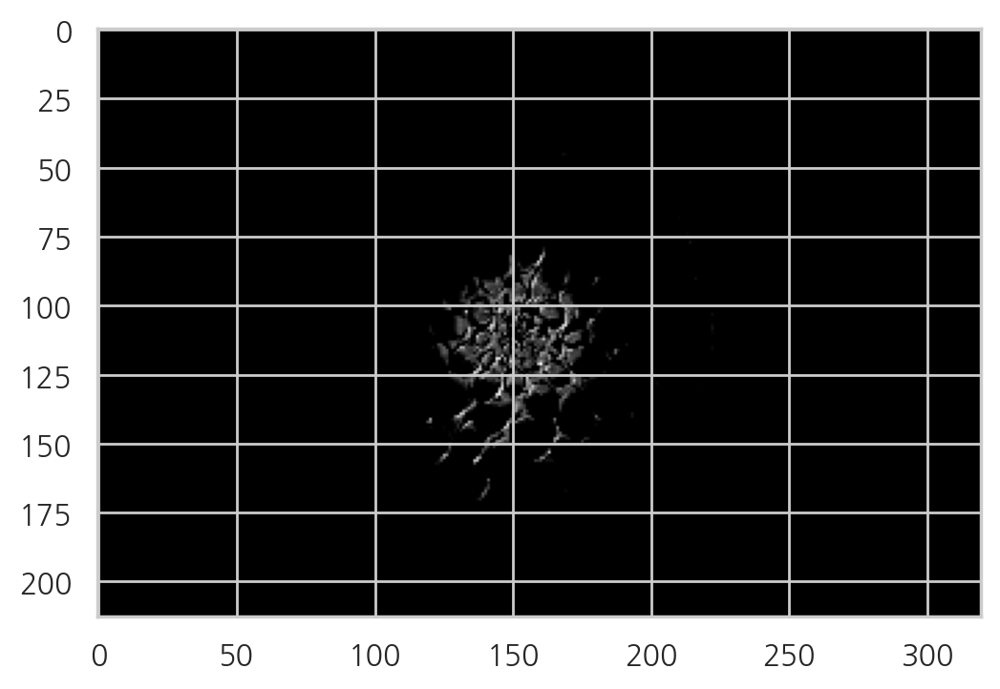

In [10]:
plt.imshow(maxpool[0, :, :, 0], cmap="gray")
plt.show() ; 

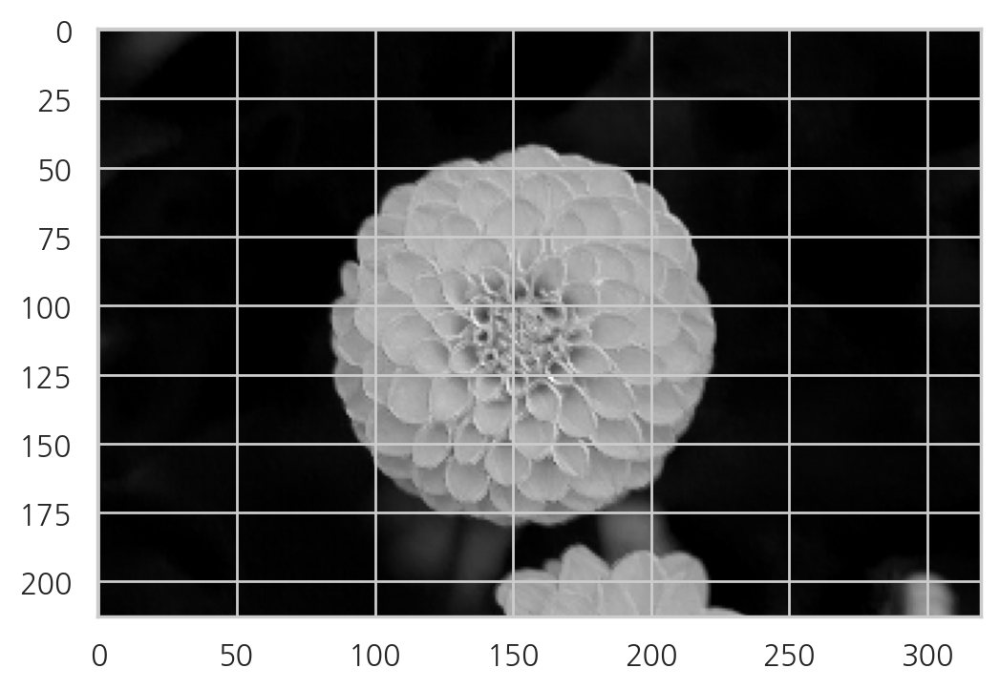

In [11]:
plt.imshow(maxpool[0, :, :, 10], cmap="gray")
plt.show() ; 

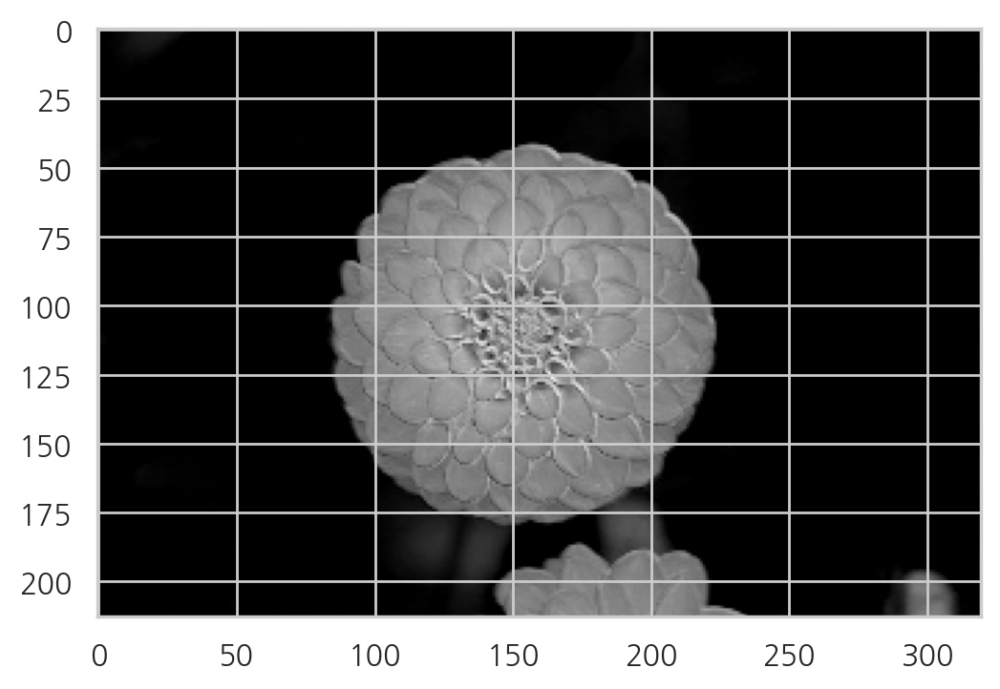

In [12]:
plt.imshow(maxpool[0, :, :, 20], cmap="gray")
plt.show() ; 

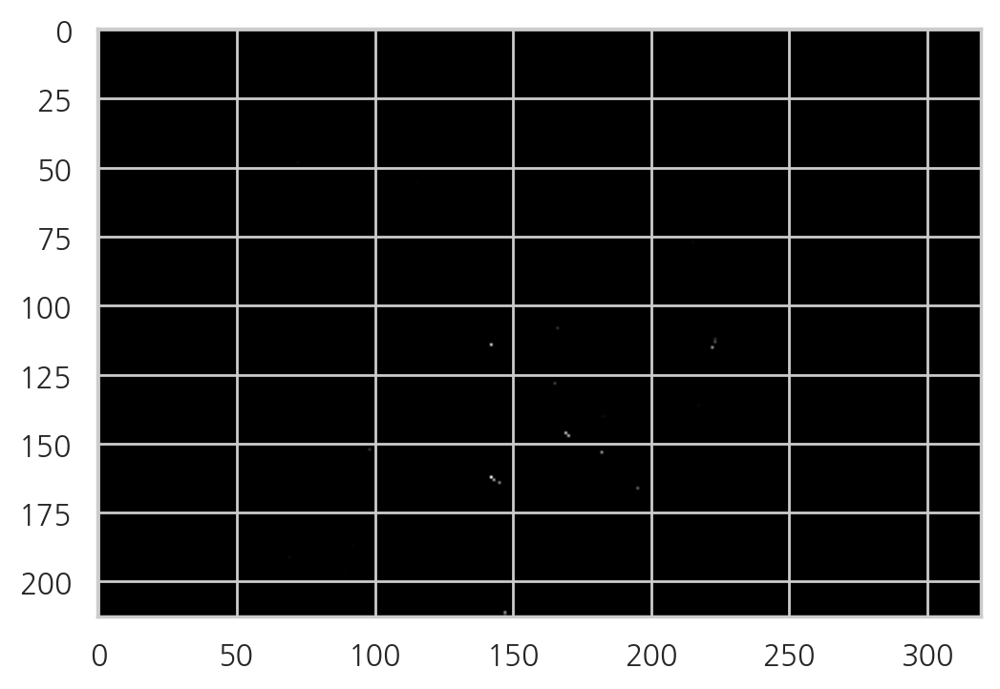

In [13]:
plt.imshow(maxpool[0, :, :, 30], cmap="gray")
plt.show() ; 

### 3-2. 평균 풀링(Avg Pooling)

- 필터 내의 있는 픽셀값의 평균을 구하는 과정
- `과거에 많이 사용, 요즘은 잘 사용되지 않음`
- 맥스풀링과 마찬가지로 stride=2, kernel_size=2 를 통해 특징 맵의 사이즈를 줄이는 역할

  <img src="https://www.researchgate.net/profile/Juan_Pedro_Dominguez-Morales/publication/329885401/figure/fig21/AS:707709083062277@1545742402308/Average-pooling-example.png" width="600">


### average pooling

In [14]:
from tensorflow.keras.layers import AvgPool2D

In [15]:
print(flower.shape)

conv = Conv2D(filters=32, kernel_size=3, strides=1, padding="same", 
              activation="relu")(flower)
pooling = AvgPool2D(pool_size=2)(conv)
print(pooling.shape)

(1, 427, 640, 3)
(1, 213, 320, 32)


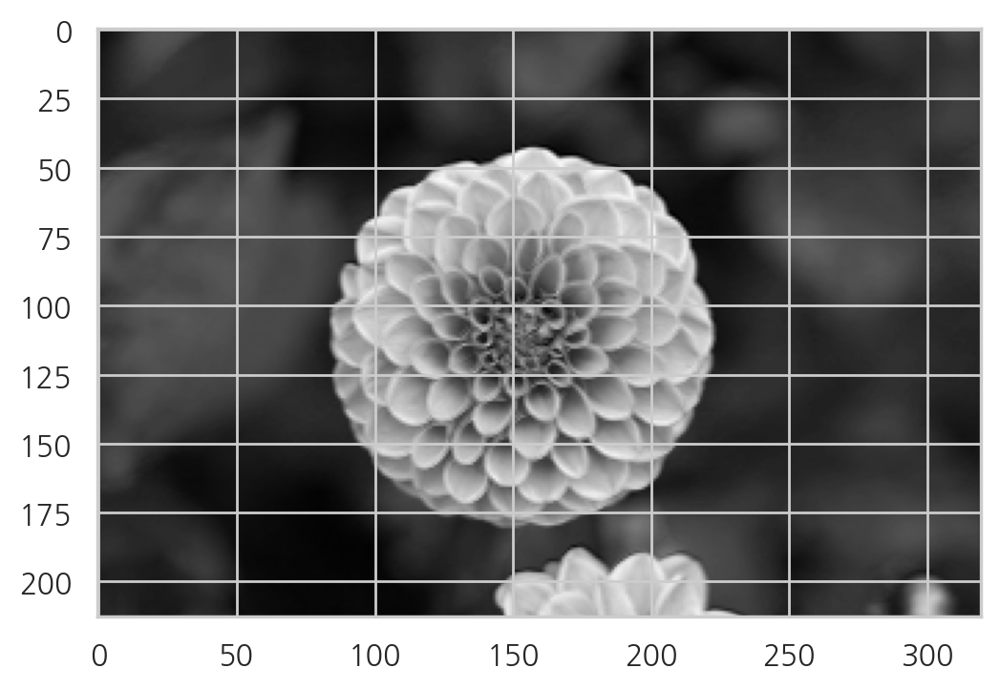

In [16]:
plt.imshow(pooling[0, :, :, 0], cmap="gray")
plt.show() ; 

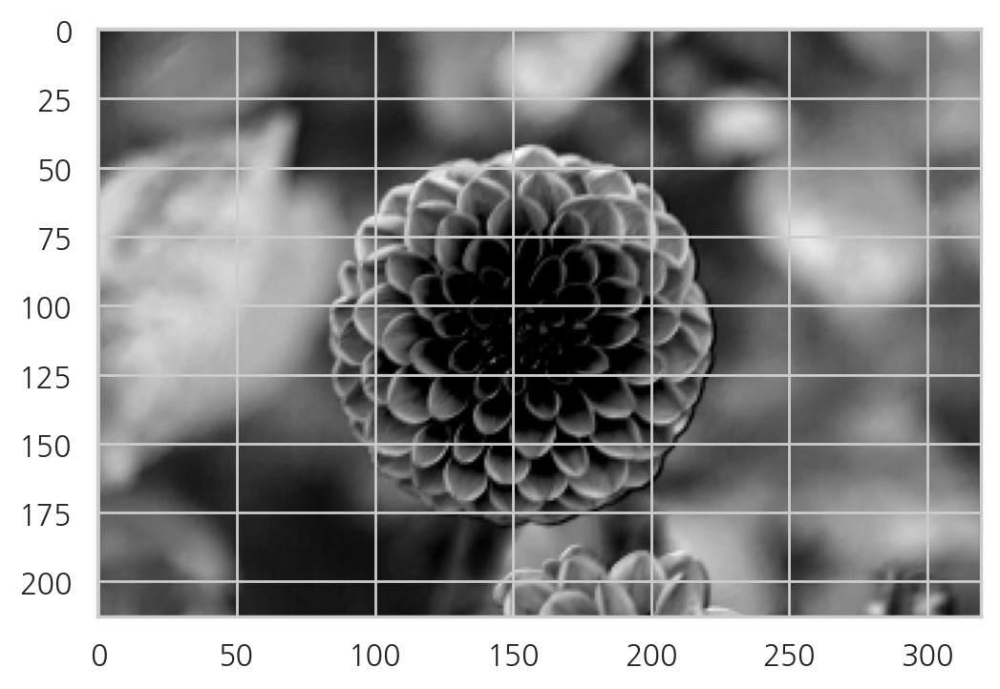

In [17]:
plt.imshow(pooling[0, :, :, 7], cmap="gray")
plt.show() ; 

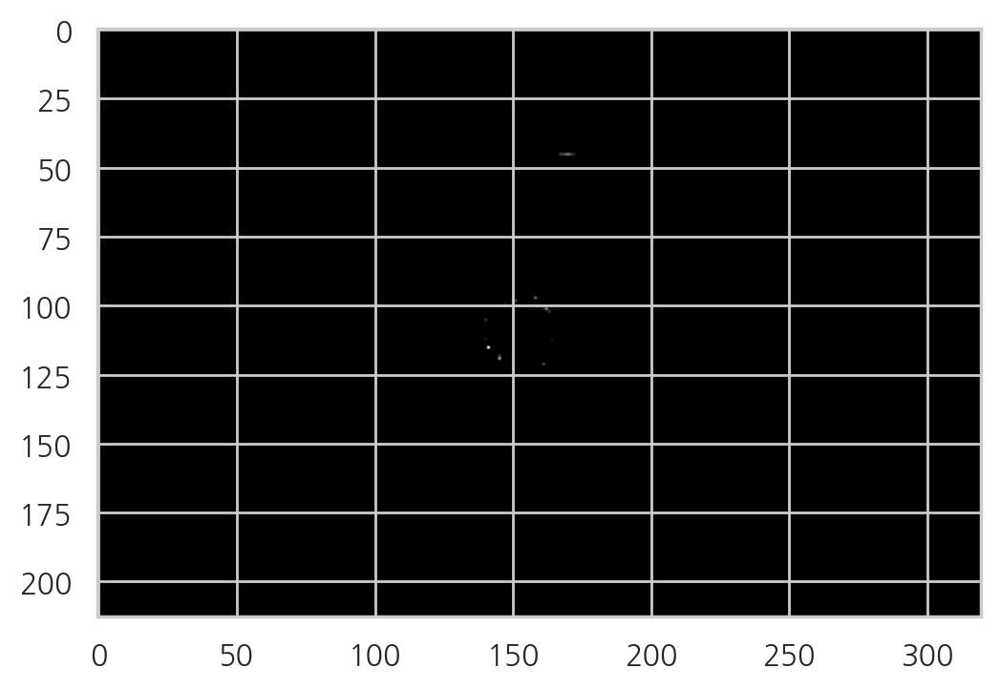

In [18]:
plt.imshow(pooling[0, :, :, 18], cmap="gray")
plt.show() ; 

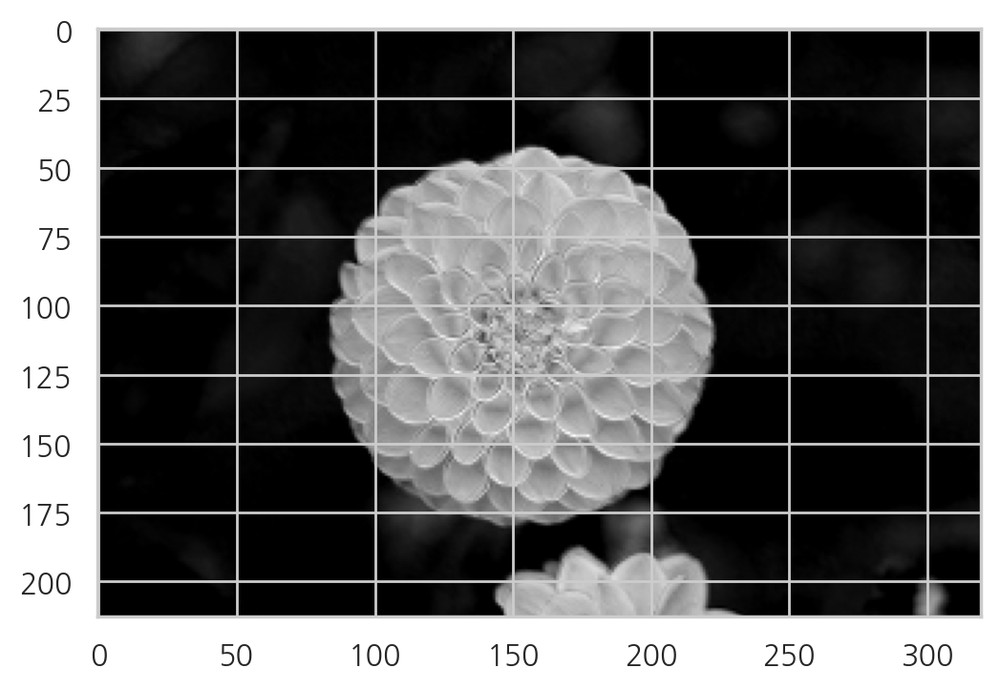

In [19]:
plt.imshow(pooling[0, :, :, 25], cmap="gray")
plt.show() ; 

### 3-3. 전역 평균 풀링(Global Avg Pooling)

- 특징 맵 각각의 평균값을 출력하는 것이므로, 특성맵에 있는 대부분의 정보를 잃음
- `출력층에는 유용할 수 있음`

In [20]:
from tensorflow.keras.layers import GlobalAvgPool2D

In [21]:
print(flower.shape)

conv = Conv2D(filters=32, kernel_size=3, strides=1, padding="same", 
              activation="relu")(flower)
# GAvgPool은 인수가 없음
pooling = GlobalAvgPool2D()(conv)
print(pooling.shape)

(1, 427, 640, 3)
(1, 32)


## 4. 완전 연결 계층(Fully-Connected Layer)

- 입력으로 받은 텐서를 1차원으로 평면화(flatten) 함
- `밀집 계층(Dense Layer)라고도 함`
- 일반적으로 분류기로서 네트워크의 마지막 계층에서 사용
   - 컨볼루션 레이어 이후 분류 레이어

In [51]:
from tensorflow.keras.layers import Dense

In [52]:
output_size = 64
fc = Dense(units=output_size, activation="relu")
fc

## 5. 유효 수용 영역(ERF, Effective Receptive Field)

- 입력 이미지에서 거리가 먼 요소를 상호 참조하여 결합하여 네트워크 능력에 영향을 줌
- 입력 이미지의 영역을 정의해 주어진 계층을 위한 뉴런의 활성화에 영향을 미침
- 한 계층의 필터 크기나 윈도우 크기로 불리기 때문에 `RF(receptive field, 수용 영역)이라는 용어를 흔히 볼 수 있음`

  <img src="https://wiki.math.uwaterloo.ca/statwiki/images/8/8c/understanding_ERF_fig0.png">

- RF의 중앙에 위치한 픽셀은 주변에 있는 픽셀보다 더 높은 가중치를 가짐
  - 중앙부에 위치한 픽셀은 여러 개의 계층을 전파한 값
  - 중앙부에 있는 픽셀은 주변에 위치한 픽셀보다 더 많은 정보를 가짐

- `가우시안 분포를 따름`

  <img src="https://www.researchgate.net/publication/316950618/figure/fig4/AS:495826810007552@1495225731123/The-receptive-field-of-each-convolution-layer-with-a-3-3-kernel-The-green-area-marks.png">

## 6. CNN 모델 학습 실험

### 6-1. MNIST (LeNet)
```
<Note>
- LeNet 은 CNN 모델의 초창기 모델
- MNIST 문제 해결하기 위해 만들어지기 시작
```

- Yann LeCun 등의 제안(1998)
- 5 계층 구조: Conv-Pool-Conv- Pool-Conv-FC-FC(SM)
- 입력 : 32x32 필기체 숫자 영상 (MNIST 데이터)
- 풀링 : 가중치x(2x2블록의 합) + 편차항  
- 시그모이드 활성화 함수 사용
- 성능: 오차율 0.95%(정확도: 99.05%)

  <img src="https://miro.medium.com/max/4308/1*1TI1aGBZ4dybR6__DI9dzA.png">
  <center>[LeNet-5 구조]</center>

### 모듈 임포트

In [1]:
import tensorflow as tf
tf.__version__

'2.10.0'

In [2]:
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPooling2D
from tensorflow.keras.callbacks import EarlyStopping, TensorBoard

### 데이터 로드 및 전처리

In [3]:
from tensorflow.keras.datasets import mnist

(X_train, y_train), (X_test, y_test) = mnist.load_data()

X_train.shape, y_train.shape, X_test.shape, y_test.shape

((60000, 28, 28), (60000,), (10000, 28, 28), (10000,))

### input data size setting

In [4]:
X_train, X_test = X_train[:, :, :, np.newaxis], X_test[:, :, :, np.newaxis]

X_train.shape, X_test.shape

((60000, 28, 28, 1), (10000, 28, 28, 1))

### train, test data normarlization

In [5]:
X_train, X_test = X_train / 255.0, X_test / 255.0

### plot error
- 알 수 없는 이유로 이미지를 불러온 후, model을 생성하면 jupyter notebook의 kernel이 죽는다.
- 메모리 문제이거나 뭔가 내부 프로세스가 잘 못 된거 같다.

In [6]:
%matplotlib inline

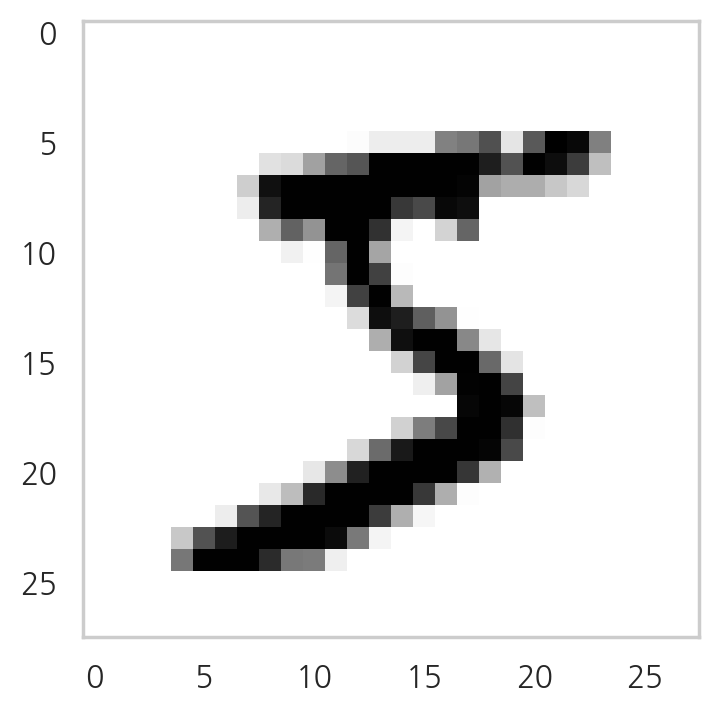

In [7]:
plt.figure(figsize=(4, 4))
plt.imshow(X_train[0], cmap=plt.cm.binary)
plt.grid(False)
plt.show() ; 

### 모델 구성 및 컴파일
- 클래스 형태로 구성

In [10]:
# tesorflow의 Model을 상속받는다.

class LeNetModel(Model) : 
    
    def __init__(self, num_classes) : 
        super(LeNetModel, self).__init__()
        self.conv1 = Conv2D(8, kernel_size=(5, 5), padding="same", activation="relu")
        self.max_pool = MaxPooling2D(pool_size=(2, 2))
        self.conv2 = Conv2D(16, kernel_size=(5, 5), activation="relu")
        self.flatten = Flatten()
        self.dense1 = Dense(160, activation="relu")
        self.dense2 = Dense(80, activation="relu")
        self.dense3 = Dense(num_classes, activation="softmax")
        
    def call(self, inputs) : 
        x = self.max_pool(self.conv1(inputs))
        x = self.max_pool(self.conv2(x))
        x = self.flatten(x)
        x = self.dense3(self.dense2(self.dense1(x)))
        
        return x

In [11]:
num_classes = 10

model = LeNetModel(num_classes)
model

### 모델 학습 및 평가

In [12]:
model.compile(loss="sparse_categorical_crossentropy",
              optimizer="sgd",
              metrics=["accuracy"])

In [13]:
callbacks = [EarlyStopping(patience=3, monitor="val_loss"),
             TensorBoard(log_dir="./logs")]

model.fit(X_train, y_train,
          epochs=30,
          batch_size=100,
          validation_data=(X_test, y_test),
          callbacks=callbacks)

Epoch 1/30
600/600 [==============================] - 20s 32ms/step - loss: 0.9669 - accuracy: 0.7104 - val_loss: 0.2937 - val_accuracy: 0.9128
Epoch 2/30
600/600 [==============================] - 26s 43ms/step - loss: 0.2569 - accuracy: 0.9227 - val_loss: 0.1832 - val_accuracy: 0.9446
Epoch 3/30
600/600 [==============================] - 16s 26ms/step - loss: 0.1750 - accuracy: 0.9469 - val_loss: 0.1382 - val_accuracy: 0.9589
Epoch 4/30
600/600 [==============================] - 17s 29ms/step - loss: 0.1358 - accuracy: 0.9593 - val_loss: 0.1183 - val_accuracy: 0.9643
Epoch 5/30
600/600 [==============================] - 17s 28ms/step - loss: 0.1139 - accuracy: 0.9655 - val_loss: 0.0886 - val_accuracy: 0.9721
Epoch 6/30
600/600 [==============================] - 24s 39ms/step - loss: 0.0998 - accuracy: 0.9696 - val_loss: 0.0867 - val_accuracy: 0.9718
Epoch 7/30
600/600 [==============================] - 16s 27ms/step - loss: 0.0896 - accuracy: 0.9726 - val_loss: 0.0720 - val_accuracy:

### 텐서보드 확인

In [14]:
%load_ext tensorboard

In [15]:
%tensorboard --logdir logs

### 6-2. Fashion MNIST

<img src="https://www.tensorflow.org/tutorials/keras/classification_files/output_oZTImqg_CaW1_0.png?hl=ko" width="500">

### 모듈 임포트

In [2]:
import tensorflow as tf

tf.__version__

'2.10.0'

In [3]:
from tensorflow.keras import Model
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Dense, Flatten, Conv2D, MaxPooling2D, Dropout
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import EarlyStopping

### 데이터 로드 및 전처리

In [53]:
from tensorflow.keras.datasets.fashion_mnist import load_data

(X_train, y_train), (X_test, y_test) = load_data()

X_train, X_test = X_train[:, :, :, np.newaxis], X_test[:, :, :, np.newaxis]
X_train, X_test = X_train / 255.0, X_test / 255.0

print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(60000, 28, 28, 1)
(60000,)
(10000, 28, 28, 1)
(10000,)


### 이미지 확인

In [5]:
%matplotlib inline

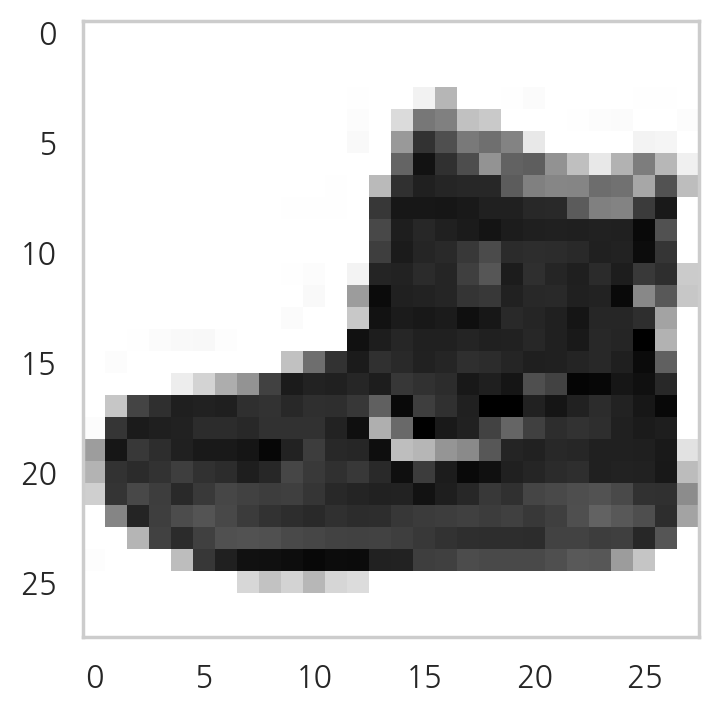

In [6]:
plt.imshow(X_train[0], cmap="binary")
plt.grid(False)
plt.show() ; 

### 모델 구성 및 학습
- 임의의 모델

In [7]:
def build_model() : 
    model = Sequential()
    
    input_ = Input(shape=(28, 28, 1))
    conv = Conv2D(filters=32, kernel_size=(3, 3))(input_)
    conv = Conv2D(filters=64, kernel_size=(3, 3))(conv)
    conv = Conv2D(filters=64, kernel_size=(3, 3))(conv)
    
    flatten = Flatten()(conv)
    dense = Dense(128, activation="relu")(flatten)
    dense = Dense(64, activation="relu")(dense)
    output_ = Dense(10, activation="softmax")(dense)
    
    model = Model(inputs=[input_], outputs=[output_])
    model.compile(loss="sparse_categorical_crossentropy",
                  optimizer="adam",
                  metrics=["acc"])
    
    return model

### plot 오류 해결
- 특정 라이브러리를 여러 라이브러리들이 각각 불러오는 과정에서 중복 오류가 남

In [8]:
import os

os.environ["KMP_DUPLICATE_LIB_OK"] = "True"
os.getenv("KMP_DUPLICATE_LIB_OK")

'True'

In [9]:
model_1 = build_model()
model_1.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 28, 28, 1)]       0         
                                                                 
 conv2d (Conv2D)             (None, 26, 26, 32)        320       
                                                                 
 conv2d_1 (Conv2D)           (None, 24, 24, 64)        18496     
                                                                 
 conv2d_2 (Conv2D)           (None, 22, 22, 64)        36928     
                                                                 
 flatten (Flatten)           (None, 30976)             0         
                                                                 
 dense (Dense)               (None, 128)               3965056   
                                                                 
 dense_1 (Dense)             (None, 64)                8256  

In [11]:
%time

cb = [EarlyStopping(patience=5, monitor="val_loss")]

hist_1 = model_1.fit(X_train, y_train,
                     epochs=30,
                     batch_size=128,
                     validation_split=0.3,
                     callbacks=cb) 

CPU times: total: 0 ns
Wall time: 0 ns
Epoch 1/30
329/329 [==============================] - 39s 118ms/step - loss: 0.4962 - acc: 0.8229 - val_loss: 0.4010 - val_acc: 0.8517
Epoch 2/30
329/329 [==============================] - 42s 127ms/step - loss: 0.3458 - acc: 0.8725 - val_loss: 0.3608 - val_acc: 0.8677
Epoch 3/30
329/329 [==============================] - 50s 152ms/step - loss: 0.2862 - acc: 0.8945 - val_loss: 0.3570 - val_acc: 0.8708
Epoch 4/30
329/329 [==============================] - 45s 137ms/step - loss: 0.2396 - acc: 0.9109 - val_loss: 0.4084 - val_acc: 0.8693
Epoch 5/30
329/329 [==============================] - 44s 133ms/step - loss: 0.2027 - acc: 0.9246 - val_loss: 0.4158 - val_acc: 0.8687
Epoch 6/30
329/329 [==============================] - 46s 138ms/step - loss: 0.1759 - acc: 0.9336 - val_loss: 0.4228 - val_acc: 0.8727
Epoch 7/30
329/329 [==============================] - 49s 148ms/step - loss: 0.1589 - acc: 0.9417 - val_loss: 0.4553 - val_acc: 0.8696
Epoch 8/30
329/3

### 모델 결과 확인
- loss와 val_loss, acc와 val_acc가 간격이 넓어지면 과적합이라고 볼 수 있다. 

In [12]:
hist_1.history.keys()

dict_keys(['loss', 'acc', 'val_loss', 'val_acc'])

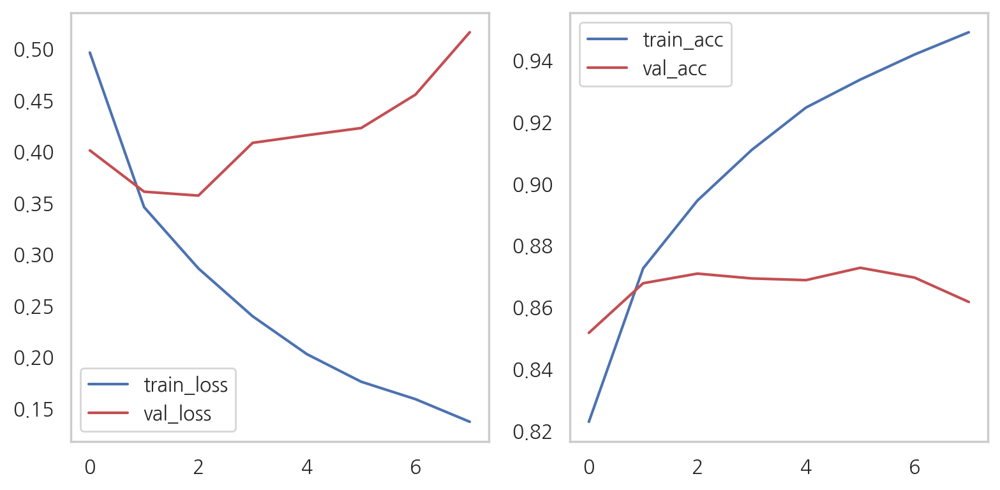

In [13]:
plt.figure(figsize=(8, 4))
plt.subplot(1, 2, 1)
plt.plot(hist_1.history["loss"], "b-", label="train_loss")
plt.plot(hist_1.history["val_loss"], "r-", label="val_loss")
plt.grid(False)
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(hist_1.history["acc"], "b-", label="train_acc")
plt.plot(hist_1.history["val_acc"], "r-", label="val_acc")
plt.grid(False)
plt.legend()

plt.tight_layout()
plt.show() ; 

In [14]:
eval_score = model_1.evaluate(X_test, y_test)

print(f"Test Loss : {eval_score[0]}")
print(f"Test Accs : {eval_score[1]}")

313/313 [==============================] - 4s 13ms/step - loss: 0.5523 - acc: 0.8547
Test Loss : 0.5522531867027283
Test Accs : 0.8547000288963318


### 모델 구성 및 학습: 과대적합 방지
- MaxPooling2D()와 Dropout() 레이어를 추가
   - 학습 파라미터의 수가 작아짐
   - 성능은 낮지만 과적합이 방지됨 : validation loss가 현저히 줄어듦
- train 보다 validation score가 더 높게 나옴   

In [20]:
def build_model2() : 
    model = Sequential()
    
    input_ = Input(shape=(28, 28, 1))
    output = Conv2D(filters=32, kernel_size=(3, 3))(input_)
    output = MaxPooling2D(pool_size=(2, 2))(output)
    output = Dropout(0.4)(output)
    output = Conv2D(filters=64, kernel_size=(3, 3))(output)
    output = MaxPooling2D(pool_size=(2, 2))(output)
    output = Dropout(0.4)(output)
    output = Conv2D(filters=64, kernel_size=(3, 3))(output)
    output = MaxPooling2D(pool_size=(2, 2))(output)
    output = Dropout(0.4)(output)
    output = Flatten()(output)
    output = Dense(128, activation="relu")(output)
    output = Dropout(0.4)(output)
    output = Dense(64, activation="relu")(output)
    output = Dropout(0.5)(output)
    output_ = Dense(10, activation="softmax")(output)
    
    model = Model(inputs=[input_], outputs=[output_])
    model.compile(loss="sparse_categorical_crossentropy",
                  optimizer="adam",
                  metrics=["acc"])
    
    return model

In [22]:
model_2 = build_model2()
model_2.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 28, 28, 1)]       0         
                                                                 
 conv2d_10 (Conv2D)          (None, 26, 26, 32)        320       
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 13, 13, 32)       0         
 2D)                                                             
                                                                 
 dropout_10 (Dropout)        (None, 13, 13, 32)        0         
                                                                 
 conv2d_11 (Conv2D)          (None, 11, 11, 64)        18496     
                                                                 
 max_pooling2d_8 (MaxPooling  (None, 5, 5, 64)         0         
 2D)                                                       

In [23]:
hist_2 = model_2.fit(X_train, y_train,
                     epochs=40,
                     batch_size=128,
                     validation_split=0.3)

Epoch 1/40
329/329 [==============================] - 9s 26ms/step - loss: 1.3223 - acc: 0.5056 - val_loss: 0.6730 - val_acc: 0.7519
Epoch 2/40
329/329 [==============================] - 9s 26ms/step - loss: 0.8152 - acc: 0.7084 - val_loss: 0.6297 - val_acc: 0.7581
Epoch 3/40
329/329 [==============================] - 9s 26ms/step - loss: 0.7328 - acc: 0.7396 - val_loss: 0.5589 - val_acc: 0.7868
Epoch 4/40
329/329 [==============================] - 10s 31ms/step - loss: 0.6865 - acc: 0.7564 - val_loss: 0.5294 - val_acc: 0.7934
Epoch 5/40
329/329 [==============================] - 9s 26ms/step - loss: 0.6664 - acc: 0.7640 - val_loss: 0.5129 - val_acc: 0.8068
Epoch 6/40
329/329 [==============================] - 11s 33ms/step - loss: 0.6368 - acc: 0.7735 - val_loss: 0.5087 - val_acc: 0.8023
Epoch 7/40
329/329 [==============================] - 11s 33ms/step - loss: 0.6173 - acc: 0.7828 - val_loss: 0.5051 - val_acc: 0.8094
Epoch 8/40
329/329 [==============================] - 14s 43ms/ste

### 모델 결과 확인
- 앞의 모델보다 어느정도 과적합이 줄어든 것을 볼 수 있다. 

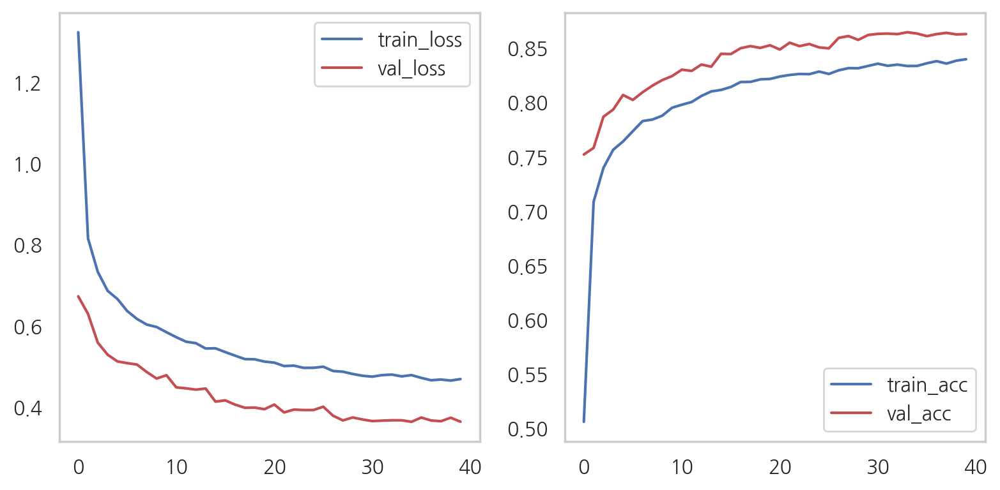

In [25]:
plt.figure(figsize=(8, 4))
plt.subplot(121)
plt.plot(hist_2.history["loss"], "b-", label="train_loss")
plt.plot(hist_2.history["val_loss"], "r-", label="val_loss")
plt.grid(False)
plt.legend()

plt.subplot(122)
plt.plot(hist_2.history["acc"], "b-", label="train_acc")
plt.plot(hist_2.history["val_acc"], "r-", label="val_acc")
plt.grid(False)
plt.legend()

plt.tight_layout()
plt.show() ;

In [29]:
model_2.evaluate(X_test, y_test)

313/313 [==============================] - 1s 3ms/step - loss: 0.3766 - acc: 0.8590


[0.3765832483768463, 0.859000027179718]

### 모델 성능 높이기: 레이어 추가
- 컨볼루션 레이어의 두께를 두껍게 : filters 증가
- 과적합 방지를 위한 레이터 추가 
   - BatchNormalization() : Conv2D() 레이어 바로 다음에 배치한다.
   - Dropout()
   - MaxPooling2D()
- val_loss가 줄어들면서 val_acc가 0.90까지 올라간다. 
- CNN 모델의 레이어 구성은 최소한 이러한 패턴을 유지해야 한다. 무작위로 여러 레이터를 마구 만들면 성능이 더 떨어지고 학습시간이 길어진다.


In [7]:
from tensorflow.keras.layers import BatchNormalization

In [8]:
def build_model3() : 
    model = Sequential()
    
    input_ = Input(shape=(28, 28, 1))
    output = Conv2D(filters=64, kernel_size=(3, 3), padding="same", activation="relu")(input_)
    output = BatchNormalization()(output)
    output = Conv2D(filters=64, kernel_size=(3, 3), padding="valid", activation="relu")(output)
    output = Dropout(0.5)(output)
    output = MaxPooling2D(pool_size=(2, 2))(output)
    
    output = Conv2D(filters=128, kernel_size=(3, 3), padding="same", activation="relu")(output)
    output = BatchNormalization()(output)
    output = Conv2D(filters=128, kernel_size=(3, 3), padding="valid", activation="relu")(output)
    output = Dropout(0.5)(output)
    output = MaxPooling2D(pool_size=(2, 2))(output)
    
    output = Conv2D(filters=256, kernel_size=(3, 3), padding="same", activation="relu")(output)
    output = BatchNormalization()(output)
    output = Conv2D(filters=256, kernel_size=(3, 3), padding="valid", activation="relu")(output)
    output = Dropout(0.5)(output)
    output = MaxPooling2D(pool_size=(2, 2))(output)
    
    output = Flatten()(output)
    output = Dense(512, activation="relu")(output)
    output = Dropout(0.5)(output)
    output = Dense(256, activation="relu")(output)
    output = Dropout(0.5)(output)
    output_ = Dense(10, activation="softmax")(output)
    
    model = Model(inputs=[input_], outputs=[output_])
    model.compile(loss="sparse_categorical_crossentropy",
                  optimizer="adam",
                  metrics=["acc"])
    
    return model

In [9]:
import os

os.environ["KMP_DUPLICATE_LIB_OK"] = "True"
os.getenv("KMP_DUPLICATE_LIB_OK")

'True'

In [10]:
model_3 = build_model3()
model_3.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 28, 28, 1)]       0         
                                                                 
 conv2d (Conv2D)             (None, 28, 28, 64)        640       
                                                                 
 batch_normalization (BatchN  (None, 28, 28, 64)       256       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 26, 26, 64)        36928     
                                                                 
 dropout (Dropout)           (None, 26, 26, 64)        0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 13, 13, 64)       0         
 )                                                           

#### 시간 오래걸림

In [11]:
hist_3 = model_3.fit(X_train, y_train,
                     epochs=25,
                     validation_split=0.3,
                     batch_size=128)

Epoch 1/25
329/329 [==============================] - 115s 346ms/step - loss: 0.7807 - acc: 0.7164 - val_loss: 2.2001 - val_acc: 0.1133
Epoch 2/25
329/329 [==============================] - 115s 349ms/step - loss: 0.4532 - acc: 0.8410 - val_loss: 1.1371 - val_acc: 0.6201
Epoch 3/25
329/329 [==============================] - 115s 349ms/step - loss: 0.3712 - acc: 0.8729 - val_loss: 0.5605 - val_acc: 0.8601
Epoch 4/25
329/329 [==============================] - 123s 374ms/step - loss: 0.3301 - acc: 0.8834 - val_loss: 0.8977 - val_acc: 0.7806
Epoch 5/25
329/329 [==============================] - 123s 374ms/step - loss: 0.3098 - acc: 0.8918 - val_loss: 0.7361 - val_acc: 0.8229
Epoch 6/25
329/329 [==============================] - 117s 356ms/step - loss: 0.2958 - acc: 0.8984 - val_loss: 0.5602 - val_acc: 0.8462
Epoch 7/25
329/329 [==============================] - 119s 363ms/step - loss: 0.2744 - acc: 0.9029 - val_loss: 0.4707 - val_acc: 0.8671
Epoch 8/25
329/329 [============================

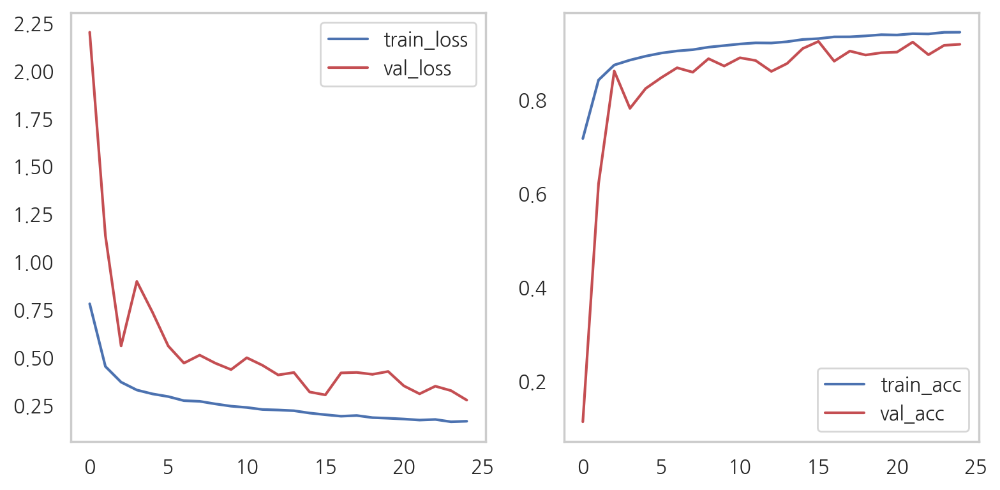

In [12]:
plt.figure(figsize=(8, 4))
plt.subplot(121)
plt.plot(hist_3.history["loss"], "b-", label="train_loss")
plt.plot(hist_3.history["val_loss"], "r-", label="val_loss")
plt.grid(False)
plt.legend()

plt.subplot(122)
plt.plot(hist_3.history["acc"], "b-", label="train_acc")
plt.plot(hist_3.history["val_acc"], "r-", label="val_acc")
plt.grid()
plt.legend()

plt.tight_layout()
plt.show() ;

### seaborn 스타일 그래프

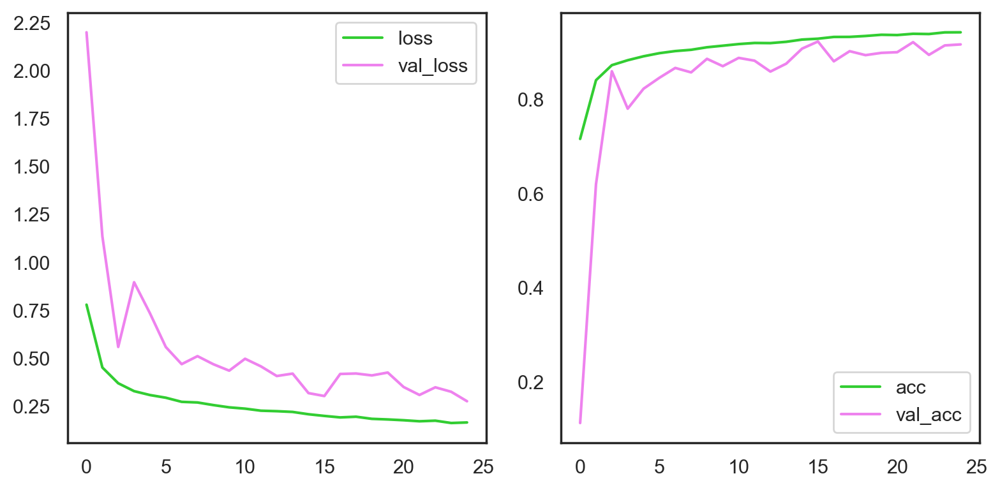

In [13]:
hist_3_temp_df = pd.DataFrame(hist_3.history)
sns.set_style("white")

plt.figure(figsize=(8, 4))
plt.subplot(121)
sns.lineplot(
    data=hist_3_temp_df[["loss", "val_loss"]],
    palette=["limegreen", "violet"],
    dashes=False
)

plt.subplot(122)
sns.lineplot(
    data=hist_3_temp_df[["acc", "val_acc"]],
    palette=["limegreen", "violet"],
    dashes=False
) 

plt.tight_layout()
plt.show() ; 

In [14]:
eval_score = model_3.evaluate(X_test, y_test)

print(f"Test Loss : {eval_score[0]}")
print(f"Test Accs : {eval_score[1]}")

313/313 [==============================] - 7s 22ms/step - loss: 0.2786 - acc: 0.9139
Test Loss : 0.2786087989807129
Test Accs : 0.9139000177383423


### 모델 성능 높이기: 이미지 보강(Image Augmentation)

- 참고
   - 증강 데이터의 좀 오래 된 방법 : https://blog.keras.io/building-powerful-image-classification-models-using-very-little-data.html
   - 증강 데이터의 최신 방법 : https://keras.io/guides/transfer_learning/

```
<Note>
- 두터운 conv 모델을 만들고 학습시킨 결과가 과적합은 낮으나 정확도가 떨어질때 데이터 자체를 증강시키는 방법
- 모델 성능을 높이기 위해 데이터 자체를 늘린다.
- 이미지 제너레이터를 사용해서 비슷한 이미지를 만들 수 있다. 
```

In [15]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [18]:
image_generator = ImageDataGenerator(
    rotation_range=10,
    zoom_range=0.2,
    shear_range=0.6,
    width_shift_range=0.2,
    height_shift_range=0.2,
    horizontal_flip=True,
    vertical_flip=False
)

augment_size = 200

print(X_train.shape[0])
print(X_train.shape)

60000
(60000, 28, 28, 1)


### image generator
- flow() : 증강 데이터 배치 생성
- np.tile(A, rep) : A 배열을 rep 만큼 반복해서 재배열 생성, rep은 행렬
   - np.tile(X_train[0].reshape(28*28*1), augment_size).reshape(-1, 28, 28, 1)
   - 첫번째 이미지 사이즈를 열벡터로 만들고, 이 열벡터를 augment_size=200 만큼 반복하여 이어붙인다. 이것을 다시 reshape(-1, 28, 28, 1)로 만들면 (200, 28, 28, 1) 사이즈인 배열이 된다.
   - 즉 첫번째 이미지를 200개로 증강시킨 것.

In [38]:
x_augment = image_generator.flow(
    x=np.tile(X_train[0].reshape(28*28*1), augment_size).reshape(-1, 28, 28, 1),
    y=np.zeros(augment_size), 
    batch_size=augment_size, 
    shuffle=False).next()[0]

x_augment.shape

(200, 28, 28, 1)

### 증강 된 학습 데이터 1 번 이미지

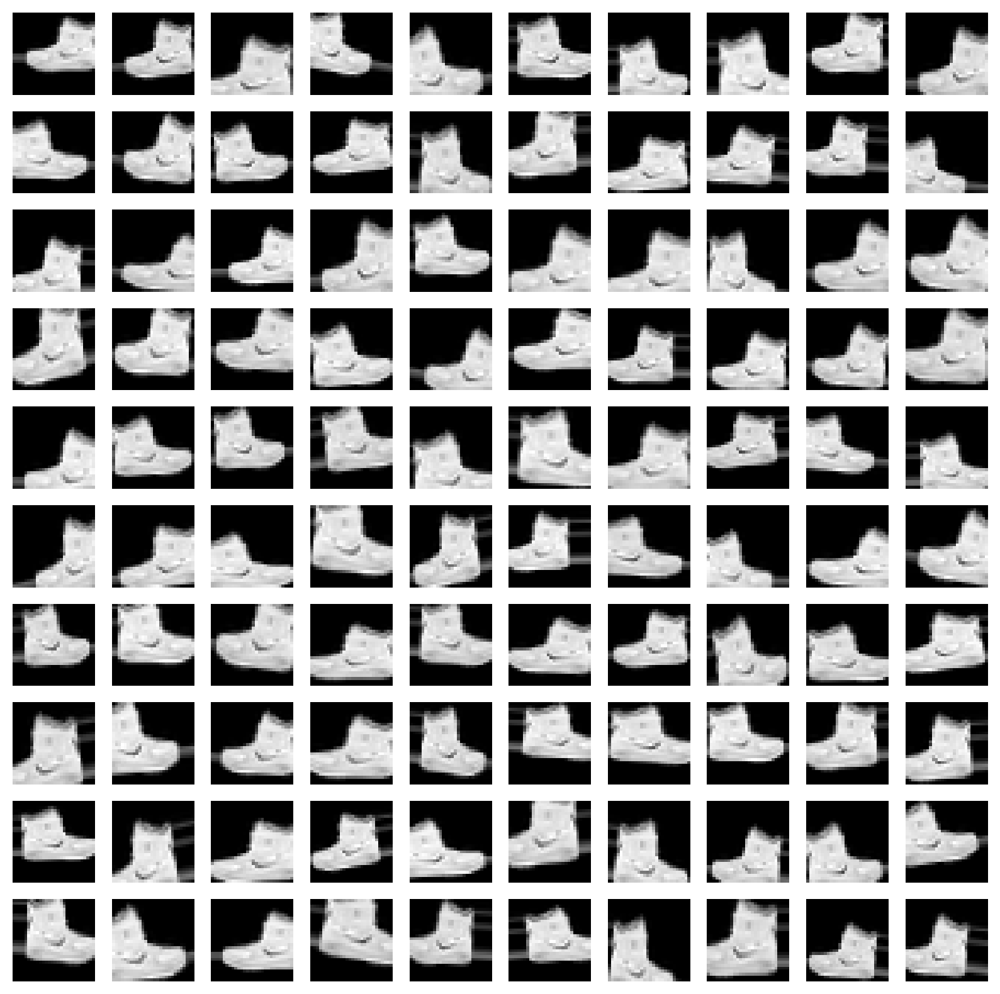

In [41]:
plt.figure(figsize=(10, 10))
for i in range(1, 101) : 
    plt.subplot(10, 10, i)
    plt.imshow(x_augment[i-1].reshape(28, 28), cmap="gray")
    plt.grid(False)
    plt.axis("off")

In [32]:
print(X_train[0].shape)
print(np.tile(X_train[0].reshape(28*28*1), augment_size).reshape(-1, 28, 28, 1).shape)

(28, 28, 1)
(200, 28, 28, 1)


In [29]:
np.tile(X_train[0].reshape(28*28*1), augment_size).reshape(-1, 28, 28, 1).shape

(200, 28, 28, 1)

In [26]:
np.tile(X_train[0].reshape(28*28*1), augment_size).shape

(156800,)

In [27]:
28 * 28 * 200

156800

In [19]:
a = np.array([1, 2, 3])
np.tile(a, 2)

array([1, 2, 3, 1, 2, 3])

In [23]:
np.tile(a, (3, 1))

array([[1, 2, 3],
       [1, 2, 3],
       [1, 2, 3]])

In [20]:
b = np.array([[1, 2], [3, 4]])
np.tile(b, 2)

array([[1, 2, 1, 2],
       [3, 4, 3, 4]])

In [21]:
np.tile(b, (3, 1))

array([[1, 2],
       [3, 4],
       [1, 2],
       [3, 4],
       [1, 2],
       [3, 4]])

In [22]:
np.tile(b, (3, 2))

array([[1, 2, 1, 2],
       [3, 4, 3, 4],
       [1, 2, 1, 2],
       [3, 4, 3, 4],
       [1, 2, 1, 2],
       [3, 4, 3, 4]])

### 3만개 증강 데이터 추가

In [42]:
image_generator = ImageDataGenerator(
    rotation_range=15,
    zoom_range=0.1,
    shear_range=0.6,
    width_shift_range=0.1,
    height_shift_range=0.1,
    horizontal_flip=True,
    vertical_flip=False
)

augment_size = 30000

In [54]:
# 60000개 인덱스 중 30000만개 뽑기

random_mask = np.random.randint(X_train.shape[0], size=augment_size)
random_mask.shape

(30000,)

In [55]:
# augment할 랜덤으로 뽑은 인덱스 3만개에 해당하는 학습 데이터 선택

X_augmented = X_train[random_mask].copy()
y_augmented = y_train[random_mask].copy()

In [56]:
X_augmented.shape, y_augmented.shape

((30000, 28, 28, 1), (30000,))

In [57]:
# 랜덤으로 선택한 학습 데이터를 각각 3만개로 증강
x_augmented = image_generator.flow(
    x=X_augmented,
    y=np.zeros(augment_size),
    batch_size=augment_size,
    shuffle=False).next()[0]

# 증강 된 데이터와 기존 X_train 병합
X_train = np.concatenate((X_train, X_augmented))
y_train = np.concatenate((y_train, y_augmented))

print(X_train.shape)
print(y_train.shape)

(90000, 28, 28, 1)
(90000,)


### build_model3 으로 모델 생성

In [58]:
model_4 = build_model3()
model_4.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 28, 28, 1)]       0         
                                                                 
 conv2d_6 (Conv2D)           (None, 28, 28, 64)        640       
                                                                 
 batch_normalization_3 (Batc  (None, 28, 28, 64)       256       
 hNormalization)                                                 
                                                                 
 conv2d_7 (Conv2D)           (None, 26, 26, 64)        36928     
                                                                 
 dropout_5 (Dropout)         (None, 26, 26, 64)        0         
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 13, 13, 64)       0         
 2D)                                                       

### 시간 오래 걸림

In [59]:
hist_4 = model_4.fit(X_train, y_train,
                     epochs=40,
                     batch_size=128,
                     validation_split=0.3)

Epoch 1/40
493/493 [==============================] - 155s 313ms/step - loss: 0.6920 - acc: 0.7506 - val_loss: 1.8637 - val_acc: 0.2989
Epoch 2/40
493/493 [==============================] - 166s 336ms/step - loss: 0.3864 - acc: 0.8652 - val_loss: 0.8272 - val_acc: 0.7749
Epoch 3/40
493/493 [==============================] - 163s 331ms/step - loss: 0.3299 - acc: 0.8851 - val_loss: 0.6284 - val_acc: 0.8590
Epoch 4/40
493/493 [==============================] - 165s 335ms/step - loss: 0.3045 - acc: 0.8947 - val_loss: 0.5312 - val_acc: 0.8699
Epoch 5/40
493/493 [==============================] - 165s 334ms/step - loss: 0.2784 - acc: 0.9036 - val_loss: 0.5478 - val_acc: 0.8449
Epoch 6/40
493/493 [==============================] - 166s 336ms/step - loss: 0.2630 - acc: 0.9092 - val_loss: 0.6126 - val_acc: 0.8349
Epoch 7/40
493/493 [==============================] - 168s 340ms/step - loss: 0.2529 - acc: 0.9132 - val_loss: 0.4213 - val_acc: 0.8949
Epoch 8/40
493/493 [============================

### 컨볼루션 레이어를 고도화하고, 증강 데이터를 사용
- 과적합이 어느정도 낮아졌고 정확도가 높아졌다.

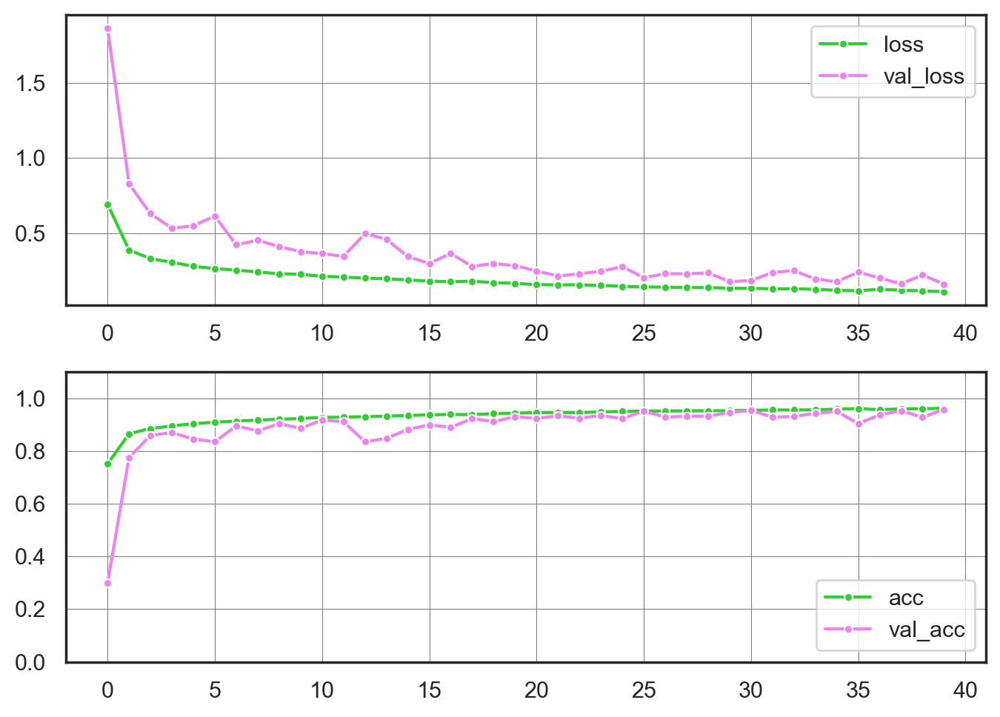

In [80]:
hist_4_temp_df = pd.DataFrame(hist_4.history)
sns.set_style("white")

plt.figure(figsize=(7, 5))
plt.subplot(211)
sns.lineplot(
    data=hist_4_temp_df[["loss", "val_loss"]],
    palette=["limegreen", "violet"],
    dashes=False,
    markers=["o"],
    markersize=4
)
plt.grid(color="gray", lw=0.4)

plt.subplot(212)
sns.lineplot(
    data=hist_4_temp_df[["acc", "val_acc"]],
    palette=["limegreen", "violet"],
    dashes=False,
    markers=["o"], 
    markersize=4
) 
plt.grid(color="gray", lw=0.4)
plt.ylim(0.0, 1.1)

plt.tight_layout()
plt.show() ; 

In [62]:
eval_score = model_4.evaluate(X_test, y_test)

print(f"Test Loss : {eval_score[0]}")
print(f"Test Accs : {eval_score[1]}")

313/313 [==============================] - 6s 21ms/step - loss: 0.2470 - acc: 0.9211
Test Loss : 0.24702255427837372
Test Accs : 0.9211000204086304


## 6-3. CIFAR-10

* CIFAR-10
  - 10개의 클래스로 구분된 32 x 32 사물 사진을 모은 데이터셋
  - 50,000개의 학습데이터, 10,000개의 테스트 데이터로 구성
  - 데이터 복잡도가 MNIST보다 훨씬 높은 특징이 있음
    - 단순한 신경망으로 특징을 검출하기 어려움


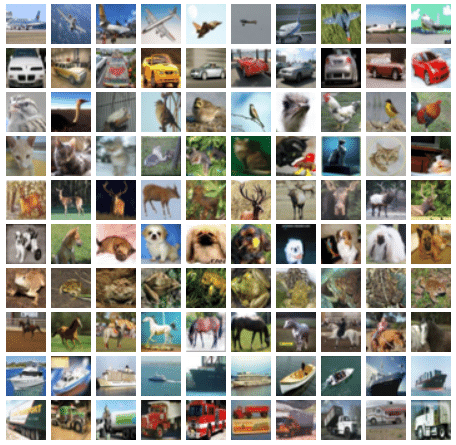

### 모듈 임포트

In [2]:
import tensorflow as tf
from tensorflow.keras.datasets import cifar10
from tensorflow.keras.layers import (Conv2D, MaxPool2D, Dense, Flatten, Input,
                                     Dropout, BatchNormalization)
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.utils import to_categorical

from sklearn.model_selection import train_test_split

### 데이터 로드 및 전처리

In [3]:
(X_train_full, y_train_full), (X_test, y_test) = cifar10.load_data()

print(X_train_full.shape, y_train_full.shape)
print(X_test.shape, y_test.shape)

(50000, 32, 32, 3) (50000, 1)
(10000, 32, 32, 3) (10000, 1)


#### 라벨 확인

In [4]:
print(y_test[6])

[1]


In [8]:
label_mapper = {
    0: "airplane", 
    1: "automobile", 
    2: "bird",      
    3: "cat",        
    4: "deer",       
    5: "dog",        
    6: "frog",       
    7: "horse",      
    8: "ship",       
    9: "truck"
}

label_mapper

{0: 'airplane',
 1: 'automobile',
 2: 'bird',
 3: 'cat',
 4: 'deer',
 5: 'dog',
 6: 'frog',
 7: 'horse',
 8: 'ship',
 9: 'truck'}

### 샘플 데이터 확인

In [5]:
random_idx = np.random.randint(len(X_train_full), size=9)
random_idx

array([47254,  4285,  7091, 26457, 45940, 30002, 23030, 48485, 42461])

In [6]:
%matplotlib inline

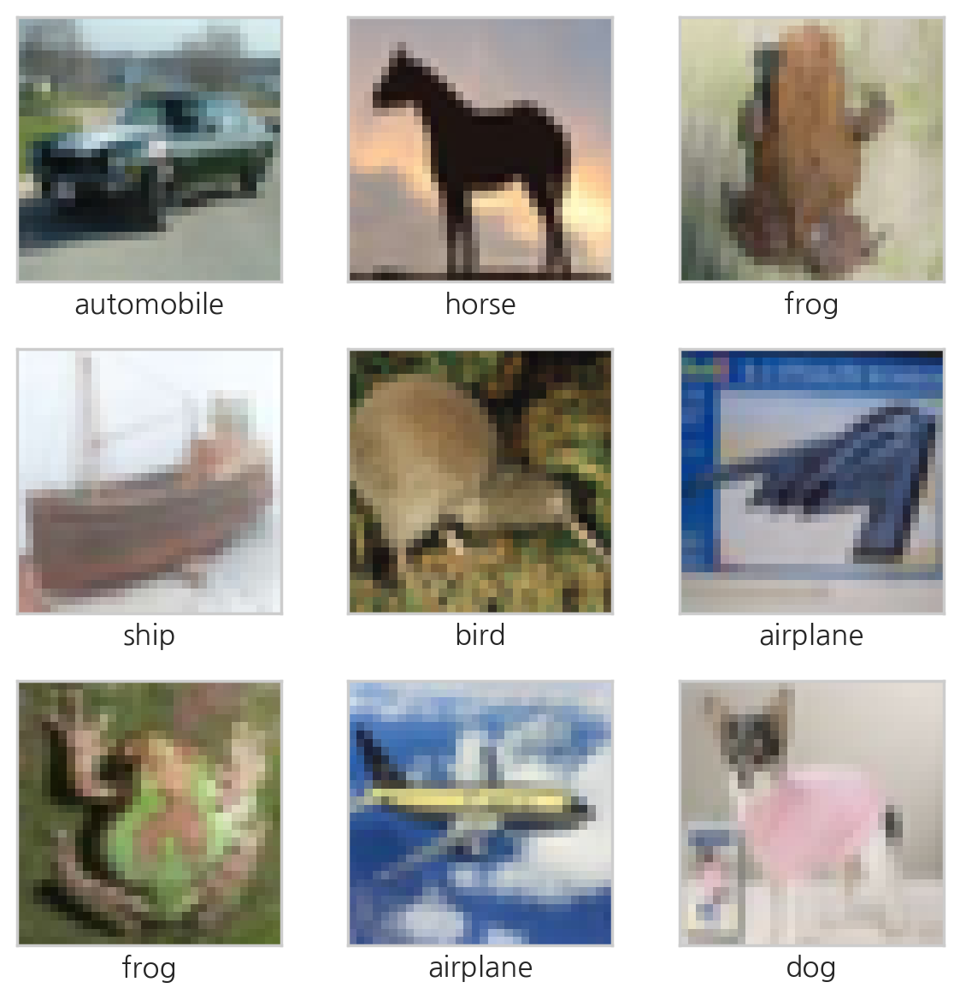

In [10]:
plt.figure(figsize=(6, 6))
for i, idx in enumerate(random_idx) : 
    plt.subplot(3, 3, i + 1)
    plt.imshow(X_train_full[idx])
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.xlabel(label_mapper[y_train_full[idx][0]]) # y_train[10]은 np 배열

plt.tight_layout()
plt.show() ; 

### 데이터 구분과 전처리
- X_train_full, X_test 를 정규화
- X_train_full 에서 train 데이터와 validation 데이터로 구분

In [16]:
# shape 순서대로 압축해서 np.mean, np.std를 구한다.
# (50000, 32, 32, 3) - > axis=(0, 1, 2) - > (3, )

X_mean = np.mean(X_train_full, axis=(0, 1, 2))
X_std = np.std(X_train_full, axis=(0, 1, 2))

X_train_full = (X_train_full - X_mean) / X_std
X_test = (X_test - X_mean) / X_std

X_train, X_val, y_train, y_val = train_test_split(X_train_full, 
                                                  y_train_full,
                                                  test_size=0.2,
                                                  random_state=111)

print(X_train.shape, y_train.shape)
print(X_val.shape, y_val.shape)

(40000, 32, 32, 3) (40000, 1)
(10000, 32, 32, 3) (10000, 1)


### tensor의 np.mean()을 구할 때 axis 순서별 형태의 변화

In [17]:
print(f"~~~ X_train_full ~~~")
print(f"full shape : {X_train_full.shape}")
print(f"mean axis=0 shape : {np.mean(X_train_full, axis=(0)).shape}")
print(f"mean axis=0,1 shape : {np.mean(X_train_full, axis=(0, 1)).shape}")
print(f"mean axis=0,1,2 shape : {np.mean(X_train_full, axis=(0, 1, 2)).shape}")
print(f"mean axis=0,1,2,3 shape : {np.mean(X_train_full, axis=(0, 1, 2, 3)).shape}")

~~~ X_train_full ~~~
full shape : (50000, 32, 32, 3)
mean axis=0 shape : (32, 32, 3)
mean axis=0,1 shape : (32, 3)
mean axis=0,1,2 shape : (3,)
mean axis=0,1,2,3 shape : ()


### 모델 구성 및 학습

In [11]:
from tensorflow.keras.optimizers import Adam

In [62]:
def model_build() : 
    
    model = Sequential()
    input_ = Input(shape=(32, 32, 3))
    output = Conv2D(filters=32, kernel_size=(3, 3), 
                    padding="same", activation="relu")(input_)
    output = MaxPool2D(pool_size=(2, 2), strides=(2, 2), padding="same")(output)
    
    output = Conv2D(filters=64, kernel_size=(3, 3), 
                    padding="same", activation="relu")(output)
    output = MaxPool2D(pool_size=(2, 2), strides=(2, 2), padding="same")(output)
    
    output = Conv2D(filters=128, kernel_size=(3, 3), 
                    padding="same", activation="relu")(output)
    output = MaxPool2D(pool_size=(2, 2), strides=(2, 2), padding="same")(output)
    
    output = Flatten()(output)
    output = Dense(256, activation="relu")(output)
    output = Dense(128, activation="relu")(output)
    output_ = Dense(10, activation="softmax")(output)
    
    model = Model(inputs=[input_], outputs=[output_])
    
    model.compile(loss="sparse_categorical_crossentropy",
                  optimizer=Adam(learning_rate=1e-4),
                  metrics=["acc"])
    
    return model

In [63]:
model = model_build()
model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 32, 32, 3)]       0         
                                                                 
 conv2d_9 (Conv2D)           (None, 32, 32, 32)        896       
                                                                 
 max_pooling2d_9 (MaxPooling  (None, 16, 16, 32)       0         
 2D)                                                             
                                                                 
 conv2d_10 (Conv2D)          (None, 16, 16, 64)        18496     
                                                                 
 max_pooling2d_10 (MaxPoolin  (None, 8, 8, 64)         0         
 g2D)                                                            
                                                                 
 conv2d_11 (Conv2D)          (None, 8, 8, 128)         7385

In [64]:
hist = model.fit(X_train, y_train,
                 epochs=30,
                 batch_size=256,
                 validation_data=(X_val, y_val))

Epoch 1/30
157/157 [==============================] - 16s 96ms/step - loss: 1.8446 - acc: 0.3472 - val_loss: 1.5805 - val_acc: 0.4303
Epoch 2/30
157/157 [==============================] - 17s 106ms/step - loss: 1.4716 - acc: 0.4797 - val_loss: 1.4222 - val_acc: 0.4877
Epoch 3/30
157/157 [==============================] - 15s 95ms/step - loss: 1.3505 - acc: 0.5242 - val_loss: 1.3225 - val_acc: 0.5266
Epoch 4/30
157/157 [==============================] - 16s 101ms/step - loss: 1.2713 - acc: 0.5527 - val_loss: 1.2834 - val_acc: 0.5382
Epoch 5/30
157/157 [==============================] - 15s 97ms/step - loss: 1.2167 - acc: 0.5751 - val_loss: 1.2023 - val_acc: 0.5753
Epoch 6/30
157/157 [==============================] - 16s 99ms/step - loss: 1.1582 - acc: 0.5946 - val_loss: 1.1705 - val_acc: 0.5892
Epoch 7/30
157/157 [==============================] - 17s 109ms/step - loss: 1.1154 - acc: 0.6133 - val_loss: 1.1447 - val_acc: 0.5984
Epoch 8/30
157/157 [==============================] - 16s 1

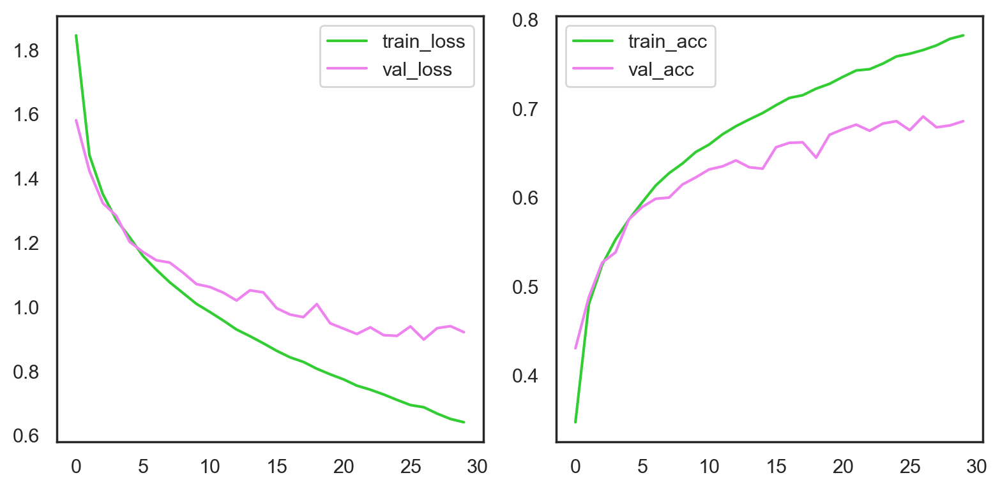

In [73]:
hist_temp_df = pd.DataFrame(hist.history)
hist_temp_df.rename(
    columns={"loss": "train_loss", "acc": "train_acc"}, inplace=True)
sns.set_style("white")

plt.figure(figsize=(8, 4))
plt.subplot(121)
g = sns.lineplot(
    data=hist_temp_df[["train_loss", "val_loss"]],
    palette=["limegreen", "violet"],
    dashes=False
)

plt.subplot(122)
sns.lineplot(
    data=hist_temp_df[["train_acc", "val_acc"]],
    palette=["limegreen", "violet"],
    dashes=False
) 

plt.tight_layout()
plt.show() ;

### 모델 구성 및 학습: 과대적합 방지


- 해당 모델은 성능이 좋지 않음
- 규제화, 드롭아웃 등 과대적합을 방지하는 기술 필요

In [76]:
def build_model2() : 
    model = Sequential()
    
    input_ = Input(shape=(32, 32, 3))
    output = Conv2D(filters=64, kernel_size=(3, 3), padding="same", activation="relu")(input_)
    output = BatchNormalization()(output)
    output = Conv2D(filters=64, kernel_size=(3, 3), padding="valid", activation="relu")(output)
    output = Dropout(0.5)(output)
    output = MaxPool2D(pool_size=(2, 2))(output)
    
    output = Conv2D(filters=128, kernel_size=(3, 3), padding="same", activation="relu")(output)
    output = BatchNormalization()(output)
    output = Conv2D(filters=128, kernel_size=(3, 3), padding="valid", activation="relu")(output)
    output = Dropout(0.5)(output)
    output = MaxPool2D(pool_size=(2, 2))(output)
    
    output = Conv2D(filters=256, kernel_size=(3, 3), padding="same", activation="relu")(output)
    output = BatchNormalization()(output)
    output = Conv2D(filters=256, kernel_size=(3, 3), padding="valid", activation="relu")(output)
    output = Dropout(0.5)(output)
    output = MaxPool2D(pool_size=(2, 2))(output)
    
    output = Flatten()(output)
    output = Dense(512, activation="relu")(output)
    output = Dropout(0.5)(output)
    output = Dense(256, activation="relu")(output)
    output = Dropout(0.5)(output)
    output_ = Dense(10, activation="softmax")(output)
    
    model = Model(inputs=[input_], outputs=[output_])
    model.compile(loss="sparse_categorical_crossentropy",
                  optimizer="adam",
                  metrics=["acc"])
    
    return model

In [77]:
model = build_model2()
model.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 32, 32, 3)]       0         
                                                                 
 conv2d_14 (Conv2D)          (None, 32, 32, 64)        1792      
                                                                 
 batch_normalization_1 (Batc  (None, 32, 32, 64)       256       
 hNormalization)                                                 
                                                                 
 conv2d_15 (Conv2D)          (None, 30, 30, 64)        36928     
                                                                 
 dropout_1 (Dropout)         (None, 30, 30, 64)        0         
                                                                 
 max_pooling2d_12 (MaxPoolin  (None, 15, 15, 64)       0         
 g2D)                                                      

#### 시간 오래 걸림

In [79]:
hist = model.fit(X_train, y_train,
                 epochs=50,
                 batch_size=512,
                 validation_data=(X_val, y_val))

Epoch 1/50
79/79 [==============================] - 121s 2s/step - loss: 1.7041 - acc: 0.3742 - val_loss: 2.4061 - val_acc: 0.1052
Epoch 2/50
79/79 [==============================] - 125s 2s/step - loss: 1.4301 - acc: 0.4897 - val_loss: 2.3670 - val_acc: 0.1709
Epoch 3/50
79/79 [==============================] - 124s 2s/step - loss: 1.2431 - acc: 0.5610 - val_loss: 2.7725 - val_acc: 0.1622
Epoch 4/50
79/79 [==============================] - 123s 2s/step - loss: 1.1025 - acc: 0.6187 - val_loss: 2.5956 - val_acc: 0.1383
Epoch 5/50
79/79 [==============================] - 125s 2s/step - loss: 1.0062 - acc: 0.6539 - val_loss: 2.3170 - val_acc: 0.2493
Epoch 6/50
79/79 [==============================] - 125s 2s/step - loss: 0.9012 - acc: 0.6901 - val_loss: 2.5556 - val_acc: 0.2367
Epoch 7/50
79/79 [==============================] - 122s 2s/step - loss: 0.8133 - acc: 0.7219 - val_loss: 2.4570 - val_acc: 0.2539
Epoch 8/50
79/79 [==============================] - 122s 2s/step - loss: 0.7470 - a

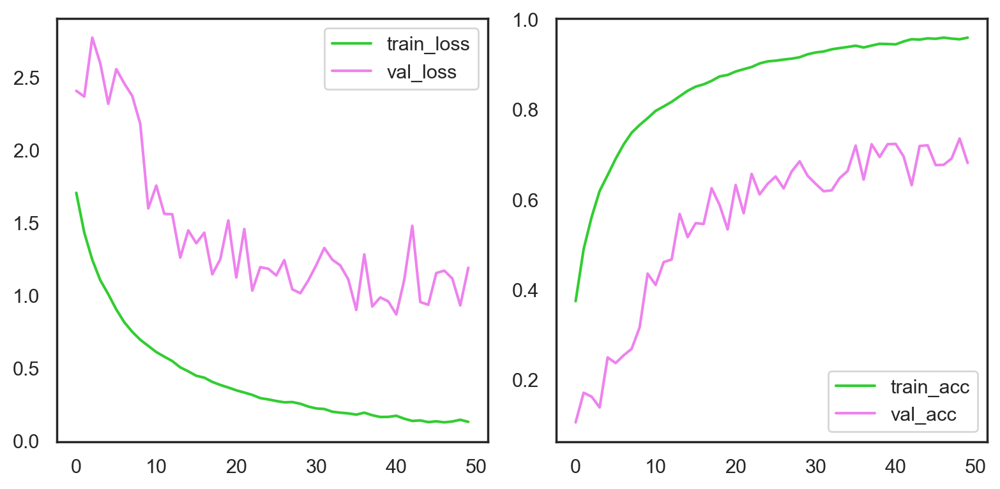

In [80]:
hist_temp_df = pd.DataFrame(hist.history)
hist_temp_df.rename(
    columns={"loss": "train_loss", "acc": "train_acc"}, inplace=True)
sns.set_style("white")

plt.figure(figsize=(8, 4))
plt.subplot(121)
g = sns.lineplot(
    data=hist_temp_df[["train_loss", "val_loss"]],
    palette=["limegreen", "violet"],
    dashes=False
)

plt.subplot(122)
sns.lineplot(
    data=hist_temp_df[["train_acc", "val_acc"]],
    palette=["limegreen", "violet"],
    dashes=False
) 

plt.tight_layout()
plt.show() ;

### 과적합을 낮추고 정확도를 높이기 위한 새로운 Conv 모델
- 가중치 정규화 기능 추가 : kernel_regularizer=l1_l2()
- Conv 레이어를 구성 할 때 어느정도 패턴을 유지해야 모델의 성능이 향상 되는 것 같다.
   - filters의 갯수도 마구잡이로 설정하는 것이 아니라 점차 증가하는 방향으로 설정 해야함 

In [21]:
from tensorflow.keras.regularizers import l1_l2

In [22]:
def build_model3() : 
    model = Sequential()
    
    input_ = Input(shape=(32, 32, 3))
    
    output = Conv2D(filters=56, kernel_size=(3, 3), kernel_regularizer=l1_l2(l1=0.0001, l2=0.0001),
                    padding="same", activation="relu")(input_)
    output = BatchNormalization()(output)
    output = MaxPool2D(pool_size=(2, 2), padding="same")(output)
    output = Conv2D(filters=112, kernel_size=(3, 3), kernel_regularizer=l1_l2(l1=0.0001, l2=0.0001), 
                    padding="same", activation="relu")(output)
    output = MaxPool2D(pool_size=(2, 2), padding="same")(output)
    output = Dropout(0.5)(output)
    
    output = Conv2D(filters=64, kernel_size=(3, 3), kernel_regularizer=l1_l2(l1=0.0001, l2=0.0001), 
                    padding="same", activation="relu")(input_)
    output = BatchNormalization()(output)
    output = MaxPool2D(pool_size=(2, 2), padding="same")(output)
    output = Conv2D(filters=128, kernel_size=(3, 3), kernel_regularizer=l1_l2(l1=0.0001, l2=0.0001), 
                    padding="same", activation="relu")(output)
    output = MaxPool2D(pool_size=(2, 2), padding="same")(output)
    output = Dropout(0.5)(output)
    
    output = Conv2D(filters=75, kernel_size=(3, 3), kernel_regularizer=l1_l2(l1=0.0001, l2=0.0001), 
                    padding="same", activation="relu")(input_)
    output = BatchNormalization()(output)
    output = MaxPool2D(pool_size=(2, 2), padding="same")(output)
    output = Conv2D(filters=150, kernel_size=(3, 3), kernel_regularizer=l1_l2(l1=0.0001, l2=0.0001), 
                    padding="same", activation="relu")(output)
    output = MaxPool2D(pool_size=(2, 2), padding="same")(output)
    output = Dropout(0.5)(output)
    
    output = Flatten()(output)
    output = Dense(150, activation="relu")(output)
    output = Dropout(0.35)(output)
    output = Dense(75, activation="relu")(output)
    output = Dropout(0.35)(output)
    output_ = Dense(10, activation="softmax")(output)
    
    model = Model(inputs=[input_], outputs=[output_])
    model.compile(loss="sparse_categorical_crossentropy",
                  optimizer=Adam(learning_rate=0.0015),
                  metrics=["acc"])
    
    return model

In [23]:
model = build_model3()
model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 32, 32, 3)]       0         
                                                                 
 conv2d_10 (Conv2D)          (None, 32, 32, 75)        2100      
                                                                 
 batch_normalization_5 (Batc  (None, 32, 32, 75)       300       
 hNormalization)                                                 
                                                                 
 max_pooling2d_10 (MaxPoolin  (None, 16, 16, 75)       0         
 g2D)                                                            
                                                                 
 conv2d_11 (Conv2D)          (None, 16, 16, 150)       101400    
                                                                 
 max_pooling2d_11 (MaxPoolin  (None, 8, 8, 150)        0   

In [24]:
hist = model.fit(X_train, 
                 y_train,
                 epochs=60,
                 batch_size=300,
                 validation_data=(X_val, y_val))

Epoch 1/60
134/134 [==============================] - 58s 426ms/step - loss: 2.2310 - acc: 0.2919 - val_loss: 2.2569 - val_acc: 0.4205
Epoch 2/60
134/134 [==============================] - 67s 501ms/step - loss: 1.7701 - acc: 0.4381 - val_loss: 1.8706 - val_acc: 0.5222
Epoch 3/60
134/134 [==============================] - 67s 498ms/step - loss: 1.5889 - acc: 0.4968 - val_loss: 1.5876 - val_acc: 0.5699
Epoch 4/60
134/134 [==============================] - 69s 512ms/step - loss: 1.4710 - acc: 0.5374 - val_loss: 1.3080 - val_acc: 0.6279
Epoch 5/60
134/134 [==============================] - 65s 487ms/step - loss: 1.3834 - acc: 0.5697 - val_loss: 1.2758 - val_acc: 0.6216
Epoch 6/60
134/134 [==============================] - 66s 489ms/step - loss: 1.3262 - acc: 0.5880 - val_loss: 1.2062 - val_acc: 0.6399
Epoch 7/60
134/134 [==============================] - 68s 505ms/step - loss: 1.2826 - acc: 0.6053 - val_loss: 1.1280 - val_acc: 0.6678
Epoch 8/60
134/134 [==============================] - 6

### 과적합과 성능이 어느정도 개선되었다.
- 성능을 높이기 위해 모델을 고도화하면 loss는 더 커지게 된다.


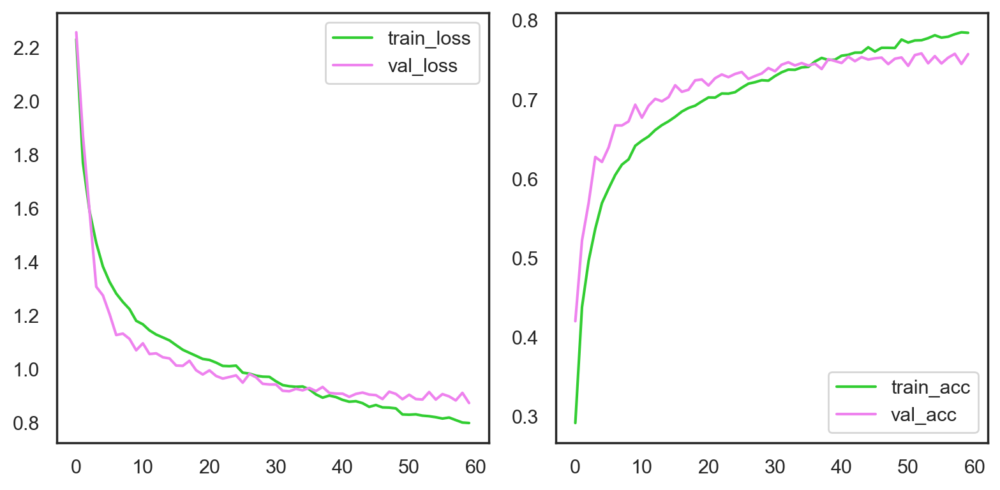

In [25]:
hist_temp_df = pd.DataFrame(hist.history)
hist_temp_df.rename(
    columns={"loss": "train_loss", "acc": "train_acc"}, inplace=True)
sns.set_style("white")

plt.figure(figsize=(8, 4))
plt.subplot(121)
g = sns.lineplot(
    data=hist_temp_df[["train_loss", "val_loss"]],
    palette=["limegreen", "violet"],
    dashes=False
)

plt.subplot(122)
sns.lineplot(
    data=hist_temp_df[["train_acc", "val_acc"]],
    palette=["limegreen", "violet"],
    dashes=False
) 

plt.tight_layout()
plt.show() ;

## 7. CNN 모델의 발전

* 1998: LeNet – Gradient-based Learning Applied to Document Recognition
* 2012: AlexNet – ImageNet Classification with Deep Convolutional Neural Network
* **2014: VggNet – Very Deep Convolutional Networks for Large-Scale Image Recognition**
* **2014: GooLeNet – Going Deeper with Convolutions**
* 2014: SppNet – Spatial Pyramid Pooling in Deep Convolutional Networks for Visual Recognition
* **2015: ResNet – Deep Residual Learning for Image Recognition**
* **2016: Xception – Xception: Deep Learning with Depthwise Separable Convolutions**
* **2017: MobileNet – MobileNets: Efficient Convolutional Neural Networks for Mobile Vision Application**
* **2017: DenseNet – Densely Connected Convolutional Networks**
* 2017: SeNet – Squeeze and Excitation Networks
* 2017: ShuffleNet – ShuffleNet: An Extremely Efficient Convolutional Neural Network for Mobile Devices
* **2018: NasNet – Learning Transferable Architectures for Scalable Image Recognition**
* 2018: Bag of Tricks – Bag of Tricks for Image Classification with Convolutional Neural Networks
* **2019: EfficientNet – EfficientNet: Rethinking Model Scaling for Convolutional Neural Networks**


### 7-1. VGGNet(Visual Geometry Group Net)

- 2014년 ILSVRC에서 2등 차지 (상위-5 오류율: 7.32%), 이 후의 수많은 연구에 영향을 미침

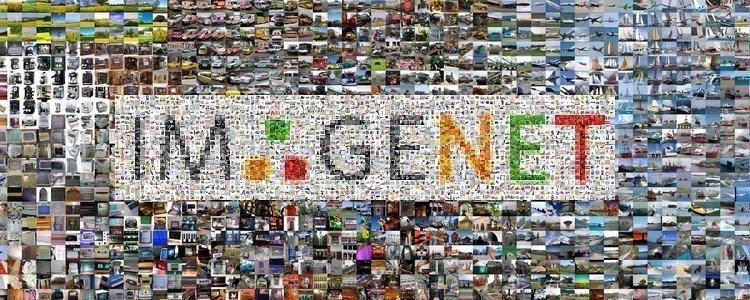

- 특징
  - 활성화 함수로 `ReLU` 사용, Dropout 적용
  - 합성곱과 풀링 계층으로 구성된 블록과 분류를 위한 완전 연결계층으로 결합된 전형적인 구조
  - `이미지 변환, 좌우 반전 등의 변환을 시도하여 인위적으로 데이터셋을 늘림` 
     - image augmentation
  - 몇 개의 합성곱 계층과 최대-풀링(MaxPooling) 계층이 따르는 5개의 블록과, 3개의 완전연결계층(학습 시, 드롭아웃 사용)으로 구성
  - 모든 합성곱과 최대-풀링 계층에 `padding='SAME'` 적용
  - 합성곱 계층에는 `stride=1`, 활성화 함수로 `ReLU` 사용
  - 특징 맵 깊이를 증가시킴
  - 척도 변경을 통한 데이터 보강(Data Augmentation)

- 기여
  - 3x3 커널을 갖는 두 합성곱 계층을 쌓은 스택이 5x5 커널을 갖는 하나의 합성곱 계층과 동일한 수용영역(ERF)을 가짐
  - 11x11 사이즈의 필터 크기를 가지는 AlexNet과 비교하여, 더 작은 합성곱 계층을 더 많이 포함해 더 큰 ERF를 얻음
  - 합성곱 계층의 개수가 많아지면, 매개변수 개수를 줄이고, 비선형성을 증가시킴

- VGG-16 모델(16개 층)

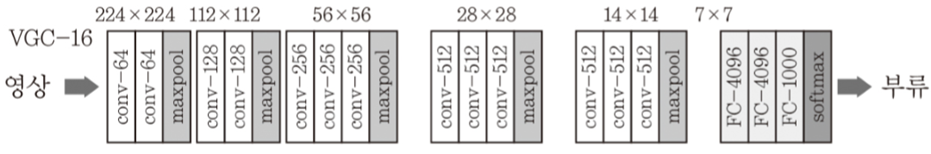

- VGG-19 모델(19개 층)  

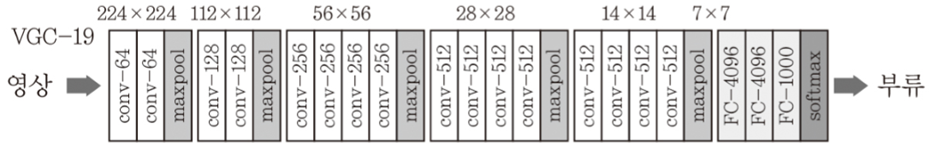

- ImageNet에서 훈련이 끝난 후 얻게된 매개변수 값 로딩
- 파라미터
    - 네트워크를 다시 처음부터 학습하고자 한다면 `weights=None`으로 설정, 케라스에서 무작위로 가중치를 설정함
    - `include_top=False`: VGG의 밀집 계층을 제외한다는 뜻
       - Dense layers 부분을 제외 함 (분류 레이어)
       - bottleneck features만 가져와서 분류는 따로 실험하면 메모리 사용을 더 효율적으로 할 수 있다고 함 (image augmentation 관련 keras 글)
    - 해당 네트워크의 출력은 합성곱/최대-풀링 블록의 특징맵이 됨
    - `pooling`: 특징맵을 반환하기 전에 적용할 선택적인 연산을 지정

In [233]:
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.vgg19 import (VGG19, 
                                                preprocess_input, 
                                                decode_predictions)

vggnet = VGG19(include_top=True, weights="imagenet",
               input_tensor=None, input_shape=None,
               pooling=None, classes=1000)

vggnet.summary()

Model: "vgg19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_13 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

* dog.jpg 
- https://as1.ftcdn.net/v2/jpg/02/70/25/48/1000_F_270254841_otSDX3fPBgcbCiUdir82QjgyF8XSQwD5.jpg

### 이미지 저장 위한 디렉토리 만들고 이미지 저장

In [29]:
!mkdir sample_images

In [30]:
!ls | grep "^sample"

sample_images


In [33]:
import wget

wget.__version__

'3.2'

In [41]:
img_url = "https://as1.ftcdn.net/v2/jpg/02/70/25/48/1000_F_270254841_otSDX3fPBgcbCiUdir82QjgyF8XSQwD5.jpg"
wget.download(img_url, out="./dog.jpg")

'./dog.jpg'

In [42]:
!mv ./dog.jpg ./sample_images/

In [43]:
!ls ./sample_images

dog.jpg


### 이미지 분류 예측

1/1 [==============================] - 0s 396ms/step
[[('n02107683', 'Bernese_mountain_dog', 0.94833297), ('n02107908', 'Appenzeller', 0.031748746), ('n02107574', 'Greater_Swiss_Mountain_dog', 0.011712548), ('n02108000', 'EntleBucher', 0.00720151), ('n02106166', 'Border_collie', 0.0004398743)]]


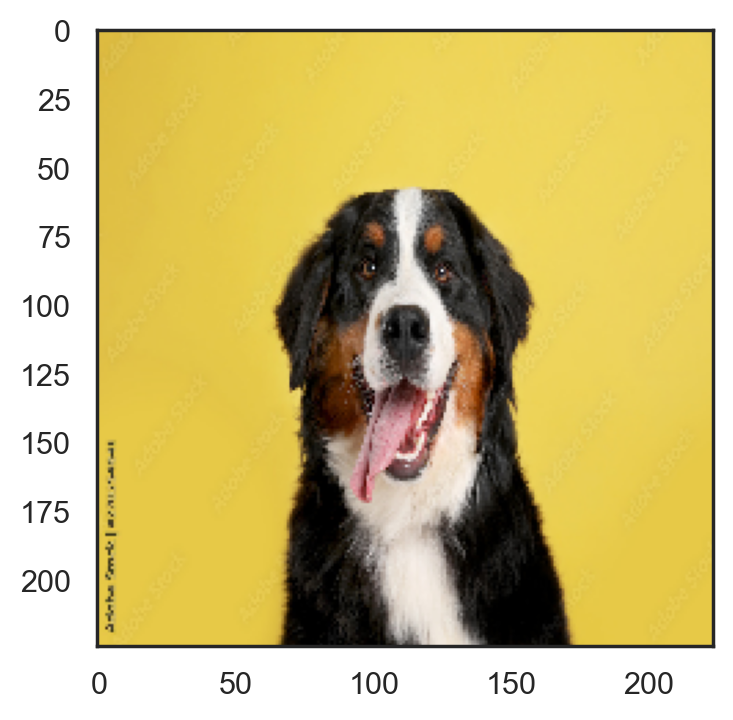

In [234]:
img = image.load_img("./sample_images/dog.jpg", target_size=(224, 224))
plt.imshow(img)

# img -> array
x = image.img_to_array(img)
# 모델에 사용하려면 맨 앞에 batch size 값을 넣어주어야 한다.
x = x.reshape((1, x.shape[0], x.shape[1], x.shape[2]))
x = preprocess_input(x)
preds = vggnet.predict(x)
print(decode_predictions(preds))

### 7-2. GoogLeNet, Inception

- VGGNet을 제치고 같은 해 분류 과제에서 1등을 차지
- `인셉션 블록`이라는 개념을 도입하여, **인셉션 네트워크(Inception Network)**라고도 불림

  <img src="https://miro.medium.com/max/2800/0*rbWRzjKvoGt9W3Mf.png">

- 특징
  - CNN 계산 용량을 최적화하는 것을 고려
  - 전형적인 합성곱, 풀링 계층으로 시작하고, 이 정보는 `9개의 인셉션 모듈 스택`을 통과 (해당 모듈을 하위 네트워크라고도 함)
  - 각 모듈에서 입력 특징 맵은 서로 다른 계층으로 구성된 `4개의 병렬 하위 블록`에 전달되고, 이를 서로 다시 연결
  - 모든 합성곱과 풀링 계층의 `padding`옵션은 `'SAME'`이며 `stride=1` 활성화 함수는 `ReLU` 사용

- 기여
  - 규모가 큰 블록과 병목(bottleneck features)을 보편화
  - 병목 계층으로 1x1 합성곱 계층 사용
  - 완전 연결 계층 대신 풀링 계층 사용
  - 중간 소실로 경사 소실 문제 해결

  <img src="https://norman3.github.io/papers/images/google_inception/f01.png">

In [235]:
from tensorflow.keras.applications.inception_v3 import (InceptionV3,
                                                        preprocess_input,
                                                        decode_predictions)

inception = InceptionV3(include_top=True, weights="imagenet",
                        input_tensor=None, input_shape=None,
                        pooling=None, classes=1000)

inception.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_14 (InputLayer)          [(None, 299, 299, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_110 (Conv2D)            (None, 149, 149, 32  864         ['input_14[0][0]']               
                                )                                                                 
                                                                                                  
 batch_normalization_104 (Batch  (None, 149, 149, 32  96         ['conv2d_110[0][0]']             
 Normalization)                 )                                                      

 conv2d_121 (Conv2D)            (None, 35, 35, 32)   6144        ['average_pooling2d_9[0][0]']    
                                                                                                  
 batch_normalization_109 (Batch  (None, 35, 35, 64)  192         ['conv2d_115[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 batch_normalization_111 (Batch  (None, 35, 35, 64)  192         ['conv2d_117[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 batch_normalization_114 (Batch  (None, 35, 35, 96)  288         ['conv2d_120[0][0]']             
 Normalization)                                                                                   
          

                                                                                                  
 conv2d_132 (Conv2D)            (None, 35, 35, 64)   18432       ['mixed1[0][0]']                 
                                                                                                  
 batch_normalization_126 (Batch  (None, 35, 35, 64)  192         ['conv2d_132[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activation_636 (Activation)    (None, 35, 35, 64)   0           ['batch_normalization_126[0][0]']
                                                                                                  
 conv2d_130 (Conv2D)            (None, 35, 35, 48)   13824       ['mixed1[0][0]']                 
                                                                                                  
 conv2d_13

                                                                                                  
 activation_643 (Activation)    (None, 17, 17, 96)   0           ['batch_normalization_133[0][0]']
                                                                                                  
 max_pooling2d_18 (MaxPooling2D  (None, 17, 17, 288)  0          ['mixed2[0][0]']                 
 )                                                                                                
                                                                                                  
 mixed3 (Concatenate)           (None, 17, 17, 768)  0           ['activation_640[0][0]',         
                                                                  'activation_643[0][0]',         
                                                                  'max_pooling2d_18[0][0]']       
                                                                                                  
 conv2d_14

 mixed4 (Concatenate)           (None, 17, 17, 768)  0           ['activation_644[0][0]',         
                                                                  'activation_647[0][0]',         
                                                                  'activation_652[0][0]',         
                                                                  'activation_653[0][0]']         
                                                                                                  
 conv2d_154 (Conv2D)            (None, 17, 17, 160)  122880      ['mixed4[0][0]']                 
                                                                                                  
 batch_normalization_148 (Batch  (None, 17, 17, 160)  480        ['conv2d_154[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activatio

 conv2d_164 (Conv2D)            (None, 17, 17, 160)  122880      ['mixed5[0][0]']                 
                                                                                                  
 batch_normalization_158 (Batch  (None, 17, 17, 160)  480        ['conv2d_164[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activation_668 (Activation)    (None, 17, 17, 160)  0           ['batch_normalization_158[0][0]']
                                                                                                  
 conv2d_165 (Conv2D)            (None, 17, 17, 160)  179200      ['activation_668[0][0]']         
                                                                                                  
 batch_normalization_159 (Batch  (None, 17, 17, 160)  480        ['conv2d_165[0][0]']             
 Normaliza

 activation_678 (Activation)    (None, 17, 17, 192)  0           ['batch_normalization_168[0][0]']
                                                                                                  
 conv2d_175 (Conv2D)            (None, 17, 17, 192)  258048      ['activation_678[0][0]']         
                                                                                                  
 batch_normalization_169 (Batch  (None, 17, 17, 192)  576        ['conv2d_175[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activation_679 (Activation)    (None, 17, 17, 192)  0           ['batch_normalization_169[0][0]']
                                                                                                  
 conv2d_171 (Conv2D)            (None, 17, 17, 192)  147456      ['mixed6[0][0]']                 
          

 Normalization)                                                                                   
                                                                                                  
 activation_687 (Activation)    (None, 17, 17, 192)  0           ['batch_normalization_177[0][0]']
                                                                                                  
 conv2d_180 (Conv2D)            (None, 17, 17, 192)  147456      ['mixed7[0][0]']                 
                                                                                                  
 conv2d_184 (Conv2D)            (None, 17, 17, 192)  258048      ['activation_687[0][0]']         
                                                                                                  
 batch_normalization_174 (Batch  (None, 17, 17, 192)  576        ['conv2d_180[0][0]']             
 Normalization)                                                                                   
          

 Normalization)                                                                                   
                                                                                                  
 conv2d_194 (Conv2D)            (None, 8, 8, 192)    245760      ['average_pooling2d_16[0][0]']   
                                                                                                  
 batch_normalization_180 (Batch  (None, 8, 8, 320)   960         ['conv2d_186[0][0]']             
 Normalization)                                                                                   
                                                                                                  
 activation_692 (Activation)    (None, 8, 8, 384)    0           ['batch_normalization_182[0][0]']
                                                                                                  
 activation_693 (Activation)    (None, 8, 8, 384)    0           ['batch_normalization_183[0][0]']
          

                                                                                                  
 activation_701 (Activation)    (None, 8, 8, 384)    0           ['batch_normalization_191[0][0]']
                                                                                                  
 activation_702 (Activation)    (None, 8, 8, 384)    0           ['batch_normalization_192[0][0]']
                                                                                                  
 activation_705 (Activation)    (None, 8, 8, 384)    0           ['batch_normalization_195[0][0]']
                                                                                                  
 activation_706 (Activation)    (None, 8, 8, 384)    0           ['batch_normalization_196[0][0]']
                                                                                                  
 batch_normalization_197 (Batch  (None, 8, 8, 192)   576         ['conv2d_203[0][0]']             
 Normaliza

* fish.jpg 
- https://as1.ftcdn.net/v2/jpg/02/74/21/30/1000_F_274213028_tdrmGFjaF5jTNxgEQKiWflEZzGTKlbLU.jpg

In [50]:
img_url = "https://as2.ftcdn.net/v2/jpg/02/77/82/85/1000_F_277828530_Lb7rC64X2qzcuzuvqxtHm1G6WYWJYW6j.jpg"
wget.download(img_url, out="./sample_images/fish_2.jpg")

'./sample_images/fish_2.jpg'

1/1 [==============================] - 1s 1s/step
[[('n01443537', 'goldfish', 0.99718285), ('n02701002', 'ambulance', 0.0005231627), ('n02422106', 'hartebeest', 7.815066e-05), ('n02977058', 'cash_machine', 4.243668e-05), ('n02927161', 'butcher_shop', 2.7947044e-05)]]


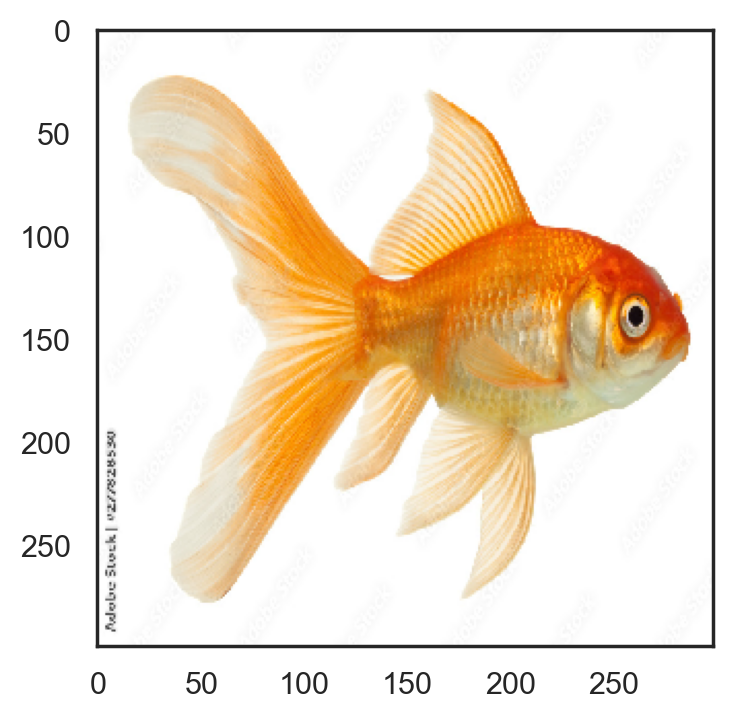

In [236]:
img = image.load_img("./sample_images/fish_2.jpg", target_size=(299, 299, 3))
plt.imshow(img)

x = image.img_to_array(img)
x = x.reshape((1, x.shape[0], x.shape[1], x.shape[2]))
x = preprocess_input(x)
preds = inception.predict(x)
print(decode_predictions(preds))

## 7-3. ResNet(Residual Net)

- 네트워크의 깊이가 깊어질수록 경사가 소실되거나 폭발하는 문제를 해결하고자 함
- 병목 합성곱 계층을 추가하거나 크기가 작은 커널을 사용
- `152개의 훈련가능한 계층을 수직으로 연결하여 구성`
- 모든 합성곱과 풀링 계층에서 패딩옵셥으로 `'SAME'`, `stride=1` 사용
- 3x3 합성곱 계층 다음마다 배치 정규화 적용, 1x1 합성곱 계층에는 활성화 함수가 존재하지 않음

  <img src="https://miro.medium.com/max/1200/1*6hF97Upuqg_LdsqWY6n_wg.png">

In [237]:
from tensorflow.keras.applications.resnet50 import (ResNet50, 
                                                    preprocess_input, 
                                                    decode_predictions)

resnet = ResNet50(include_top=True, weights="imagenet",
                  input_tensor=None, input_shape=None,
                  pooling=None, classes=1000)

resnet.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_15 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_15[0][0]']               
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

                                                                                                  
 conv2_block3_1_relu (Activatio  (None, 56, 56, 64)  0           ['conv2_block3_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv2_block3_2_conv (Conv2D)   (None, 56, 56, 64)   36928       ['conv2_block3_1_relu[0][0]']    
                                                                                                  
 conv2_block3_2_bn (BatchNormal  (None, 56, 56, 64)  256         ['conv2_block3_2_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv2_block3_2_relu (Activatio  (None, 56, 56, 64)  0           ['conv2_block3_2_bn[0][0]']      
 n)       

                                                                                                  
 conv3_block3_1_relu (Activatio  (None, 28, 28, 128)  0          ['conv3_block3_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv3_block3_2_conv (Conv2D)   (None, 28, 28, 128)  147584      ['conv3_block3_1_relu[0][0]']    
                                                                                                  
 conv3_block3_2_bn (BatchNormal  (None, 28, 28, 128)  512        ['conv3_block3_2_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv3_block3_2_relu (Activatio  (None, 28, 28, 128)  0          ['conv3_block3_2_bn[0][0]']      
 n)       

                                                                                                  
 conv4_block2_1_bn (BatchNormal  (None, 14, 14, 256)  1024       ['conv4_block2_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv4_block2_1_relu (Activatio  (None, 14, 14, 256)  0          ['conv4_block2_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_block2_2_conv (Conv2D)   (None, 14, 14, 256)  590080      ['conv4_block2_1_relu[0][0]']    
                                                                                                  
 conv4_block2_2_bn (BatchNormal  (None, 14, 14, 256)  1024       ['conv4_block2_2_conv[0][0]']    
 ization) 

 conv4_block5_1_conv (Conv2D)   (None, 14, 14, 256)  262400      ['conv4_block4_out[0][0]']       
                                                                                                  
 conv4_block5_1_bn (BatchNormal  (None, 14, 14, 256)  1024       ['conv4_block5_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv4_block5_1_relu (Activatio  (None, 14, 14, 256)  0          ['conv4_block5_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_block5_2_conv (Conv2D)   (None, 14, 14, 256)  590080      ['conv4_block5_1_relu[0][0]']    
                                                                                                  
 conv4_blo

                                                                  'conv5_block1_3_bn[0][0]']      
                                                                                                  
 conv5_block1_out (Activation)  (None, 7, 7, 2048)   0           ['conv5_block1_add[0][0]']       
                                                                                                  
 conv5_block2_1_conv (Conv2D)   (None, 7, 7, 512)    1049088     ['conv5_block1_out[0][0]']       
                                                                                                  
 conv5_block2_1_bn (BatchNormal  (None, 7, 7, 512)   2048        ['conv5_block2_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv5_block2_1_relu (Activatio  (None, 7, 7, 512)   0           ['conv5_block2_1_bn[0][0]']      
 n)       

* bee.jpg 
- https://as2.ftcdn.net/v2/jpg/00/81/02/05/1000_F_81020552_VdSuInR6zWrzFPmZCgmryxxqe05SXKes.jpg

In [54]:
img_url = "https://as2.ftcdn.net/v2/jpg/00/81/02/05/1000_F_81020552_VdSuInR6zWrzFPmZCgmryxxqe05SXKes.jpg"
wget.download(img_url, out="./sample_images/bee.jpg")

'./sample_images/bee.jpg'

1/1 [==============================] - 1s 1s/step
[[('n02206856', 'bee', 0.99673826), ('n02727426', 'apiary', 0.0020326895), ('n03530642', 'honeycomb', 0.00047204443), ('n07730033', 'cardoon', 0.00018919494), ('n02190166', 'fly', 0.00014135614)]]


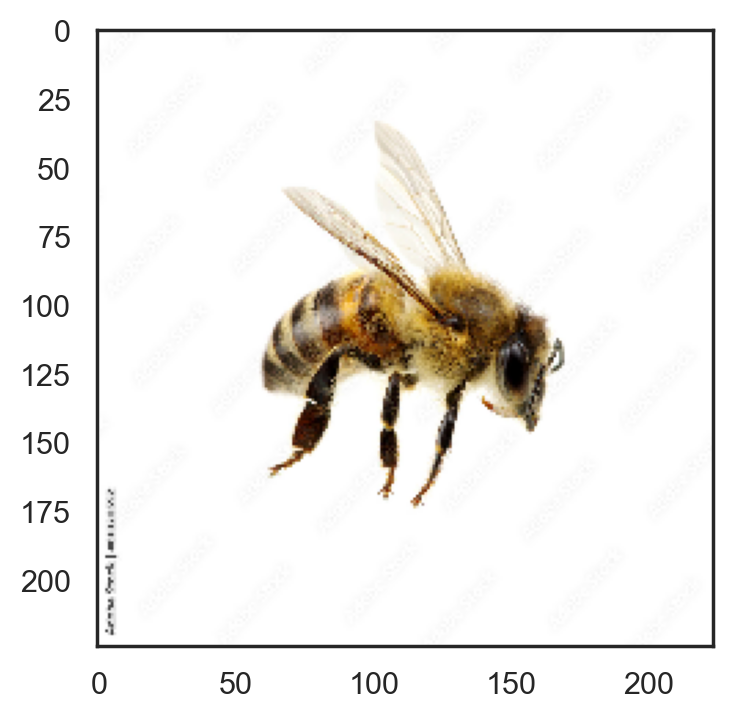

In [238]:
img = image.load_img("./sample_images/bee.jpg", target_size=(224, 224, 3))
plt.imshow(img)

x = image.img_to_array(img)
x = x.reshape((1, x.shape[0], x.shape[1], x.shape[2]))
x = preprocess_input(x)
preds = resnet.predict(x)
print(decode_predictions(preds))

### 7-4. Xception

* Inception module을 이용하여 `depthwise convolution` 적용

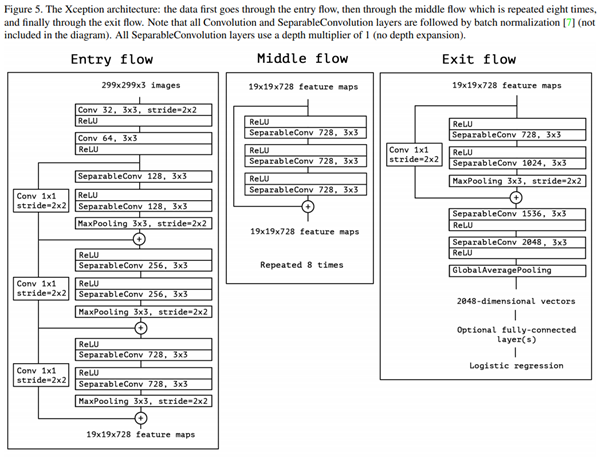

* 기존의 Conv layer에서 얻은 feature map을 각 채널별로 다른 Conv layer에 적용하여 feature map을 얻음

- RGB 채널을 각각 분리시키고 RGB 채널마다 다른 출력값을 만든 후 합하는 방식

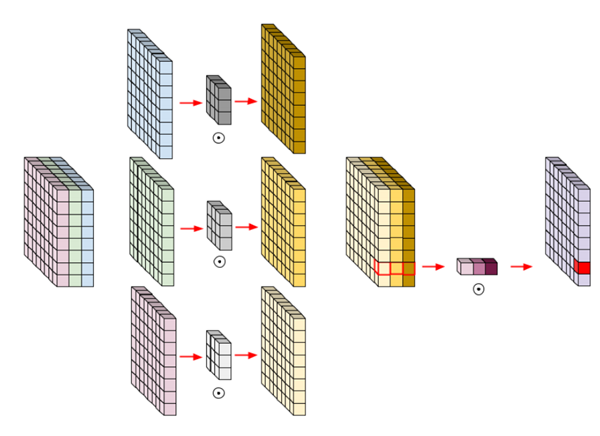

In [239]:
from tensorflow.keras.applications.xception import (Xception, 
                                                    preprocess_input,
                                                    decode_predictions)

xception = Xception(include_top=True, weights="imagenet",
                    input_tensor=None, input_shape=None,
                    pooling=None, classes=1000)

xception.summary()

Model: "xception"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_16 (InputLayer)          [(None, 299, 299, 3  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 149, 149, 32  864         ['input_16[0][0]']               
                                )                                                                 
                                                                                                  
 block1_conv1_bn (BatchNormaliz  (None, 149, 149, 32  128        ['block1_conv1[0][0]']           
 ation)                         )                                                          

 block4_sepconv1_bn (BatchNorma  (None, 37, 37, 728)  2912       ['block4_sepconv1[0][0]']        
 lization)                                                                                        
                                                                                                  
 block4_sepconv2_act (Activatio  (None, 37, 37, 728)  0          ['block4_sepconv1_bn[0][0]']     
 n)                                                                                               
                                                                                                  
 block4_sepconv2 (SeparableConv  (None, 37, 37, 728)  536536     ['block4_sepconv2_act[0][0]']    
 2D)                                                                                              
                                                                                                  
 block4_sepconv2_bn (BatchNorma  (None, 37, 37, 728)  2912       ['block4_sepconv2[0][0]']        
 lization)

 n)                                                                                               
                                                                                                  
 block7_sepconv1 (SeparableConv  (None, 19, 19, 728)  536536     ['block7_sepconv1_act[0][0]']    
 2D)                                                                                              
                                                                                                  
 block7_sepconv1_bn (BatchNorma  (None, 19, 19, 728)  2912       ['block7_sepconv1[0][0]']        
 lization)                                                                                        
                                                                                                  
 block7_sepconv2_act (Activatio  (None, 19, 19, 728)  0          ['block7_sepconv1_bn[0][0]']     
 n)                                                                                               
          

 block9_sepconv3_bn (BatchNorma  (None, 19, 19, 728)  2912       ['block9_sepconv3[0][0]']        
 lization)                                                                                        
                                                                                                  
 add_27 (Add)                   (None, 19, 19, 728)  0           ['block9_sepconv3_bn[0][0]',     
                                                                  'add_26[0][0]']                 
                                                                                                  
 block10_sepconv1_act (Activati  (None, 19, 19, 728)  0          ['add_27[0][0]']                 
 on)                                                                                              
                                                                                                  
 block10_sepconv1 (SeparableCon  (None, 19, 19, 728)  536536     ['block10_sepconv1_act[0][0]']   
 v2D)     

                                                                                                  
 block12_sepconv3_act (Activati  (None, 19, 19, 728)  0          ['block12_sepconv2_bn[0][0]']    
 on)                                                                                              
                                                                                                  
 block12_sepconv3 (SeparableCon  (None, 19, 19, 728)  536536     ['block12_sepconv3_act[0][0]']   
 v2D)                                                                                             
                                                                                                  
 block12_sepconv3_bn (BatchNorm  (None, 19, 19, 728)  2912       ['block12_sepconv3[0][0]']       
 alization)                                                                                       
                                                                                                  
 add_30 (A

* beaver.jpg 
- https://as2.ftcdn.net/v2/jpg/06/12/37/21/1000_F_612372173_F5mutrIK5gQiqpC5HyIAFgkOnk8pPZlL.webp

In [61]:
img_url = "https://as1.ftcdn.net/v2/jpg/02/61/86/68/1000_F_261866819_yxB3WW3erTY9c8iC00oSKSB94wBe3n5s.jpg"
wget.download(img_url, out="./sample_images/beaver_2.jpg")

'./sample_images/beaver_2.jpg'

1/1 [==============================] - 1s 1s/step
[[('n02363005', 'beaver', 0.9540222), ('n02444819', 'otter', 0.00680233), ('n02396427', 'wild_boar', 0.004971961), ('n01873310', 'platypus', 0.0017209008), ('n02442845', 'mink', 0.0016907504)]]


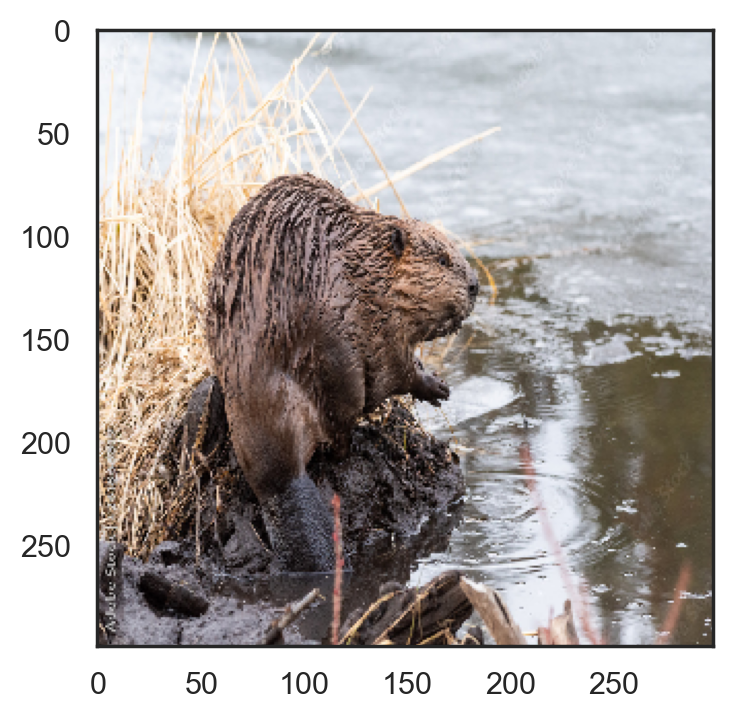

In [240]:
img = image.load_img("./sample_images/beaver_2.jpg", target_size=(299, 299))
plt.imshow(img)

x = image.img_to_array(img)
x = x.reshape((1, x.shape[0], x.shape[1], x.shape[2]))
x = preprocess_input(x)
preds = xception.predict(x)
print(decode_predictions(preds))

### 7-5. MobileNet

* `성능보다 모델의 크기 또는 연산 속도 감소`
* Depthwise conv와 Pointwise conv 사이에도 batch normalization과 ReLU를 삽입
* Conv layer를 활용한 모델과 정확도는 비슷하면서 계산량은 9배, 파라미터 수는 7배 줄임

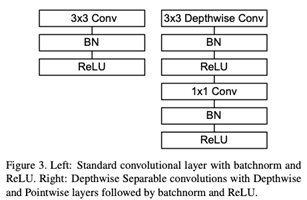

In [241]:
from tensorflow.keras.applications.mobilenet import (MobileNet, 
                                                    preprocess_input, 
                                                    decode_predictions)

mobilenet = MobileNet(include_top=True, weights="imagenet",
                      input_tensor=None, input_shape=None,
                      pooling=None, classes=1000)

mobilenet.summary()

Model: "mobilenet_1.00_224"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_17 (InputLayer)       [(None, 224, 224, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 112, 112, 32)      864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 112, 112, 32)     128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 112, 112, 32)      0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)     288       
                                                                 
 conv_dw_1_bn (BatchNormaliz  (None, 112, 112, 32)     128       
 ation)                                         

                                                                 
 conv_pw_8_bn (BatchNormaliz  (None, 14, 14, 512)      2048      
 ation)                                                          
                                                                 
 conv_pw_8_relu (ReLU)       (None, 14, 14, 512)       0         
                                                                 
 conv_dw_9 (DepthwiseConv2D)  (None, 14, 14, 512)      4608      
                                                                 
 conv_dw_9_bn (BatchNormaliz  (None, 14, 14, 512)      2048      
 ation)                                                          
                                                                 
 conv_dw_9_relu (ReLU)       (None, 14, 14, 512)       0         
                                                                 
 conv_pw_9 (Conv2D)          (None, 14, 14, 512)       262144    
                                                                 
 conv_pw_9

* crane.jpg 
- https://as1.ftcdn.net/v2/jpg/00/22/43/58/1000_F_22435844_WOsydnWjBjCfdAaGId0CxXk0ahEOWeqs.jpg

In [66]:
img_url = "https://as1.ftcdn.net/v2/jpg/00/22/43/58/1000_F_22435844_WOsydnWjBjCfdAaGId0CxXk0ahEOWeqs.jpg"

wget.download(img_url, out="./sample_images/crane.jpg")

'./sample_images/crane.jpg'

1/1 [==============================] - 1s 537ms/step
[[('n03126707', 'crane', 0.97686857), ('n03496892', 'harvester', 0.014801623), ('n04461696', 'tow_truck', 0.0026283609), ('n04428191', 'thresher', 0.002381843), ('n03240683', 'drilling_platform', 0.0012047522)]]


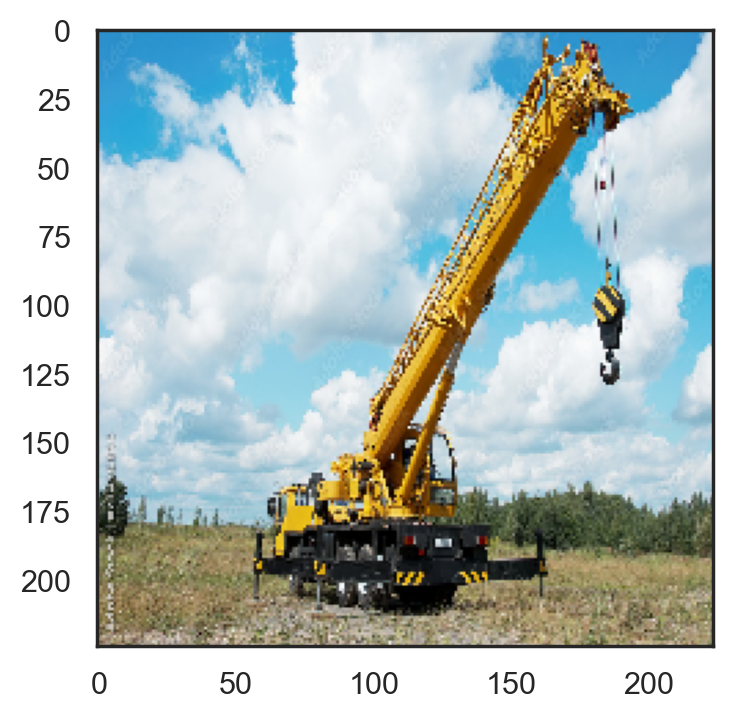

In [242]:
img = image.load_img("./sample_images/crane.jpg", target_size=(224, 224))
plt.imshow(img)

x = image.img_to_array(img)
x = x.reshape((1, x.shape[0], x.shape[1], x.shape[2]))
x = preprocess_input(x)
preds = mobilenet.predict(x)
print(decode_predictions(preds))

### 7-6. DenseNet

* 각 층은 모든 앞 단계에서 올 수 있는 지름길 연결 구성
* 특징지도의 크기를 줄이기 위해 풀링 연산 적용 필요
* 밀집 블록(dense block)과 전이층(transition layer)으로 구성
* 전이층 : 1x1 컨볼루션과 평균값 풀링(APool)으로 구성   

<img src="https://oi.readthedocs.io/en/latest/_images/cnn_vs_resnet_vs_densenet.png" width="700">

In [243]:
from tensorflow.keras.applications.densenet import (DenseNet201, 
                                                   preprocess_input,
                                                   decode_predictions)

densenet = DenseNet201(include_top=True, weights="imagenet",
                     input_tensor=None, input_shape=None,
                     pooling=None, classes=1000)

densenet.summary()

Model: "densenet201"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_18 (InputLayer)          [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d_10 (ZeroPadding  (None, 230, 230, 3)  0          ['input_18[0][0]']               
 2D)                                                                                              
                                                                                                  
 conv1/conv (Conv2D)            (None, 112, 112, 64  9408        ['zero_padding2d_10[0][0]']      
                                )                                                       

 conv2_block4_0_relu (Activatio  (None, 56, 56, 160)  0          ['conv2_block4_0_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv2_block4_1_conv (Conv2D)   (None, 56, 56, 128)  20480       ['conv2_block4_0_relu[0][0]']    
                                                                                                  
 conv2_block4_1_bn (BatchNormal  (None, 56, 56, 128)  512        ['conv2_block4_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv2_block4_1_relu (Activatio  (None, 56, 56, 128)  0          ['conv2_block4_1_bn[0][0]']      
 n)                                                                                               
          

                                                                                                  
 conv3_block2_0_relu (Activatio  (None, 28, 28, 160)  0          ['conv3_block2_0_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv3_block2_1_conv (Conv2D)   (None, 28, 28, 128)  20480       ['conv3_block2_0_relu[0][0]']    
                                                                                                  
 conv3_block2_1_bn (BatchNormal  (None, 28, 28, 128)  512        ['conv3_block2_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv3_block2_1_relu (Activatio  (None, 28, 28, 128)  0          ['conv3_block2_1_bn[0][0]']      
 n)       

 ization)                                                                                         
                                                                                                  
 conv3_block6_1_relu (Activatio  (None, 28, 28, 128)  0          ['conv3_block6_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv3_block6_2_conv (Conv2D)   (None, 28, 28, 32)   36864       ['conv3_block6_1_relu[0][0]']    
                                                                                                  
 conv3_block6_concat (Concatena  (None, 28, 28, 320)  0          ['conv3_block5_concat[0][0]',    
 te)                                                              'conv3_block6_2_conv[0][0]']    
                                                                                                  
 conv3_blo

 conv3_block10_concat (Concaten  (None, 28, 28, 448)  0          ['conv3_block9_concat[0][0]',    
 ate)                                                             'conv3_block10_2_conv[0][0]']   
                                                                                                  
 conv3_block11_0_bn (BatchNorma  (None, 28, 28, 448)  1792       ['conv3_block10_concat[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv3_block11_0_relu (Activati  (None, 28, 28, 448)  0          ['conv3_block11_0_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv3_block11_1_conv (Conv2D)  (None, 28, 28, 128)  57344       ['conv3_block11_0_relu[0][0]']   
          

                                                                                                  
 conv4_block2_concat (Concatena  (None, 14, 14, 320)  0          ['conv4_block1_concat[0][0]',    
 te)                                                              'conv4_block2_2_conv[0][0]']    
                                                                                                  
 conv4_block3_0_bn (BatchNormal  (None, 14, 14, 320)  1280       ['conv4_block2_concat[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv4_block3_0_relu (Activatio  (None, 14, 14, 320)  0          ['conv4_block3_0_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_blo

 conv4_block7_0_relu (Activatio  (None, 14, 14, 448)  0          ['conv4_block7_0_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv4_block7_1_conv (Conv2D)   (None, 14, 14, 128)  57344       ['conv4_block7_0_relu[0][0]']    
                                                                                                  
 conv4_block7_1_bn (BatchNormal  (None, 14, 14, 128)  512        ['conv4_block7_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv4_block7_1_relu (Activatio  (None, 14, 14, 128)  0          ['conv4_block7_1_bn[0][0]']      
 n)                                                                                               
          

                                                                                                  
 conv4_block11_1_relu (Activati  (None, 14, 14, 128)  0          ['conv4_block11_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block11_2_conv (Conv2D)  (None, 14, 14, 32)   36864       ['conv4_block11_1_relu[0][0]']   
                                                                                                  
 conv4_block11_concat (Concaten  (None, 14, 14, 608)  0          ['conv4_block10_concat[0][0]',   
 ate)                                                             'conv4_block11_2_conv[0][0]']   
                                                                                                  
 conv4_block12_0_bn (BatchNorma  (None, 14, 14, 608)  2432       ['conv4_block11_concat[0][0]']   
 lization)

 ate)                                                             'conv4_block15_2_conv[0][0]']   
                                                                                                  
 conv4_block16_0_bn (BatchNorma  (None, 14, 14, 736)  2944       ['conv4_block15_concat[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block16_0_relu (Activati  (None, 14, 14, 736)  0          ['conv4_block16_0_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block16_1_conv (Conv2D)  (None, 14, 14, 128)  94208       ['conv4_block16_0_relu[0][0]']   
                                                                                                  
 conv4_blo

                                                                                                  
 conv4_block20_1_conv (Conv2D)  (None, 14, 14, 128)  110592      ['conv4_block20_0_relu[0][0]']   
                                                                                                  
 conv4_block20_1_bn (BatchNorma  (None, 14, 14, 128)  512        ['conv4_block20_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block20_1_relu (Activati  (None, 14, 14, 128)  0          ['conv4_block20_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block20_2_conv (Conv2D)  (None, 14, 14, 32)   36864       ['conv4_block20_1_relu[0][0]']   
          

 on)                                                                                              
                                                                                                  
 conv4_block24_2_conv (Conv2D)  (None, 14, 14, 32)   36864       ['conv4_block24_1_relu[0][0]']   
                                                                                                  
 conv4_block24_concat (Concaten  (None, 14, 14, 1024  0          ['conv4_block23_concat[0][0]',   
 ate)                           )                                 'conv4_block24_2_conv[0][0]']   
                                                                                                  
 conv4_block25_0_bn (BatchNorma  (None, 14, 14, 1024  4096       ['conv4_block24_concat[0][0]']   
 lization)                      )                                                                 
                                                                                                  
 conv4_blo

 conv4_block29_0_bn (BatchNorma  (None, 14, 14, 1152  4608       ['conv4_block28_concat[0][0]']   
 lization)                      )                                                                 
                                                                                                  
 conv4_block29_0_relu (Activati  (None, 14, 14, 1152  0          ['conv4_block29_0_bn[0][0]']     
 on)                            )                                                                 
                                                                                                  
 conv4_block29_1_conv (Conv2D)  (None, 14, 14, 128)  147456      ['conv4_block29_0_relu[0][0]']   
                                                                                                  
 conv4_block29_1_bn (BatchNorma  (None, 14, 14, 128)  512        ['conv4_block29_1_conv[0][0]']   
 lization)                                                                                        
          

                                                                                                  
 conv4_block33_1_bn (BatchNorma  (None, 14, 14, 128)  512        ['conv4_block33_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block33_1_relu (Activati  (None, 14, 14, 128)  0          ['conv4_block33_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block33_2_conv (Conv2D)  (None, 14, 14, 32)   36864       ['conv4_block33_1_relu[0][0]']   
                                                                                                  
 conv4_block33_concat (Concaten  (None, 14, 14, 1312  0          ['conv4_block32_concat[0][0]',   
 ate)     

 conv4_block37_2_conv (Conv2D)  (None, 14, 14, 32)   36864       ['conv4_block37_1_relu[0][0]']   
                                                                                                  
 conv4_block37_concat (Concaten  (None, 14, 14, 1440  0          ['conv4_block36_concat[0][0]',   
 ate)                           )                                 'conv4_block37_2_conv[0][0]']   
                                                                                                  
 conv4_block38_0_bn (BatchNorma  (None, 14, 14, 1440  5760       ['conv4_block37_concat[0][0]']   
 lization)                      )                                                                 
                                                                                                  
 conv4_block38_0_relu (Activati  (None, 14, 14, 1440  0          ['conv4_block38_0_bn[0][0]']     
 on)                            )                                                                 
          

                                                                                                  
 conv4_block42_0_relu (Activati  (None, 14, 14, 1568  0          ['conv4_block42_0_bn[0][0]']     
 on)                            )                                                                 
                                                                                                  
 conv4_block42_1_conv (Conv2D)  (None, 14, 14, 128)  200704      ['conv4_block42_0_relu[0][0]']   
                                                                                                  
 conv4_block42_1_bn (BatchNorma  (None, 14, 14, 128)  512        ['conv4_block42_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv4_block42_1_relu (Activati  (None, 14, 14, 128)  0          ['conv4_block42_1_bn[0][0]']     
 on)      

 lization)                                                                                        
                                                                                                  
 conv4_block46_1_relu (Activati  (None, 14, 14, 128)  0          ['conv4_block46_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv4_block46_2_conv (Conv2D)  (None, 14, 14, 32)   36864       ['conv4_block46_1_relu[0][0]']   
                                                                                                  
 conv4_block46_concat (Concaten  (None, 14, 14, 1728  0          ['conv4_block45_concat[0][0]',   
 ate)                           )                                 'conv4_block46_2_conv[0][0]']   
                                                                                                  
 conv4_blo

 conv5_block2_1_conv (Conv2D)   (None, 7, 7, 128)    118784      ['conv5_block2_0_relu[0][0]']    
                                                                                                  
 conv5_block2_1_bn (BatchNormal  (None, 7, 7, 128)   512         ['conv5_block2_1_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv5_block2_1_relu (Activatio  (None, 7, 7, 128)   0           ['conv5_block2_1_bn[0][0]']      
 n)                                                                                               
                                                                                                  
 conv5_block2_2_conv (Conv2D)   (None, 7, 7, 32)     36864       ['conv5_block2_1_relu[0][0]']    
                                                                                                  
 conv5_blo

                                                                                                  
 conv5_block6_2_conv (Conv2D)   (None, 7, 7, 32)     36864       ['conv5_block6_1_relu[0][0]']    
                                                                                                  
 conv5_block6_concat (Concatena  (None, 7, 7, 1088)  0           ['conv5_block5_concat[0][0]',    
 te)                                                              'conv5_block6_2_conv[0][0]']    
                                                                                                  
 conv5_block7_0_bn (BatchNormal  (None, 7, 7, 1088)  4352        ['conv5_block6_concat[0][0]']    
 ization)                                                                                         
                                                                                                  
 conv5_block7_0_relu (Activatio  (None, 7, 7, 1088)  0           ['conv5_block7_0_bn[0][0]']      
 n)       

 lization)                                                                                        
                                                                                                  
 conv5_block11_0_relu (Activati  (None, 7, 7, 1216)  0           ['conv5_block11_0_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv5_block11_1_conv (Conv2D)  (None, 7, 7, 128)    155648      ['conv5_block11_0_relu[0][0]']   
                                                                                                  
 conv5_block11_1_bn (BatchNorma  (None, 7, 7, 128)   512         ['conv5_block11_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv5_blo

 conv5_block15_1_bn (BatchNorma  (None, 7, 7, 128)   512         ['conv5_block15_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv5_block15_1_relu (Activati  (None, 7, 7, 128)   0           ['conv5_block15_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv5_block15_2_conv (Conv2D)  (None, 7, 7, 32)     36864       ['conv5_block15_1_relu[0][0]']   
                                                                                                  
 conv5_block15_concat (Concaten  (None, 7, 7, 1376)  0           ['conv5_block14_concat[0][0]',   
 ate)                                                             'conv5_block15_2_conv[0][0]']   
          

                                                                                                  
 conv5_block19_concat (Concaten  (None, 7, 7, 1504)  0           ['conv5_block18_concat[0][0]',   
 ate)                                                             'conv5_block19_2_conv[0][0]']   
                                                                                                  
 conv5_block20_0_bn (BatchNorma  (None, 7, 7, 1504)  6016        ['conv5_block19_concat[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv5_block20_0_relu (Activati  (None, 7, 7, 1504)  0           ['conv5_block20_0_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv5_blo

 conv5_block24_0_relu (Activati  (None, 7, 7, 1632)  0           ['conv5_block24_0_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv5_block24_1_conv (Conv2D)  (None, 7, 7, 128)    208896      ['conv5_block24_0_relu[0][0]']   
                                                                                                  
 conv5_block24_1_bn (BatchNorma  (None, 7, 7, 128)   512         ['conv5_block24_1_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 conv5_block24_1_relu (Activati  (None, 7, 7, 128)   0           ['conv5_block24_1_bn[0][0]']     
 on)                                                                                              
          

                                                                                                  
 conv5_block28_1_relu (Activati  (None, 7, 7, 128)   0           ['conv5_block28_1_bn[0][0]']     
 on)                                                                                              
                                                                                                  
 conv5_block28_2_conv (Conv2D)  (None, 7, 7, 32)     36864       ['conv5_block28_1_relu[0][0]']   
                                                                                                  
 conv5_block28_concat (Concaten  (None, 7, 7, 1792)  0           ['conv5_block27_concat[0][0]',   
 ate)                                                             'conv5_block28_2_conv[0][0]']   
                                                                                                  
 conv5_block29_0_bn (BatchNorma  (None, 7, 7, 1792)  7168        ['conv5_block28_concat[0][0]']   
 lization)

 ate)                                                             'conv5_block32_2_conv[0][0]']   
                                                                                                  
 bn (BatchNormalization)        (None, 7, 7, 1920)   7680        ['conv5_block32_concat[0][0]']   
                                                                                                  
 relu (Activation)              (None, 7, 7, 1920)   0           ['bn[0][0]']                     
                                                                                                  
 avg_pool (GlobalAveragePooling  (None, 1920)        0           ['relu[0][0]']                   
 2D)                                                                                              
                                                                                                  
 predictions (Dense)            (None, 1000)         1921000     ['avg_pool[0][0]']               
          

In [70]:
from tensorflow.keras.utils import plot_model

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.475077 to fit



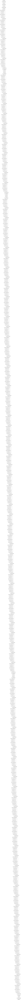

In [72]:
plot_model(densenet)

* zebra.jpg
- https://as1.ftcdn.net/v2/jpg/05/55/22/24/1000_F_555222454_epLY6iW0D3MIZiXTx4zIz91pg4dut3Kh.jpg

In [73]:
img_url = "https://as1.ftcdn.net/v2/jpg/05/55/22/24/1000_F_555222454_epLY6iW0D3MIZiXTx4zIz91pg4dut3Kh.jpg"

wget.download(img_url, out="./sample_images/zebra.jpg")

'./sample_images/zebra.jpg'

1/1 [==============================] - 3s 3s/step
[[('n02391049', 'zebra', 0.9888053), ('n02130308', 'cheetah', 0.0023408143), ('n02129604', 'tiger', 0.0021024288), ('n02128925', 'jaguar', 0.0020817905), ('n02128385', 'leopard', 0.0020248652)]]


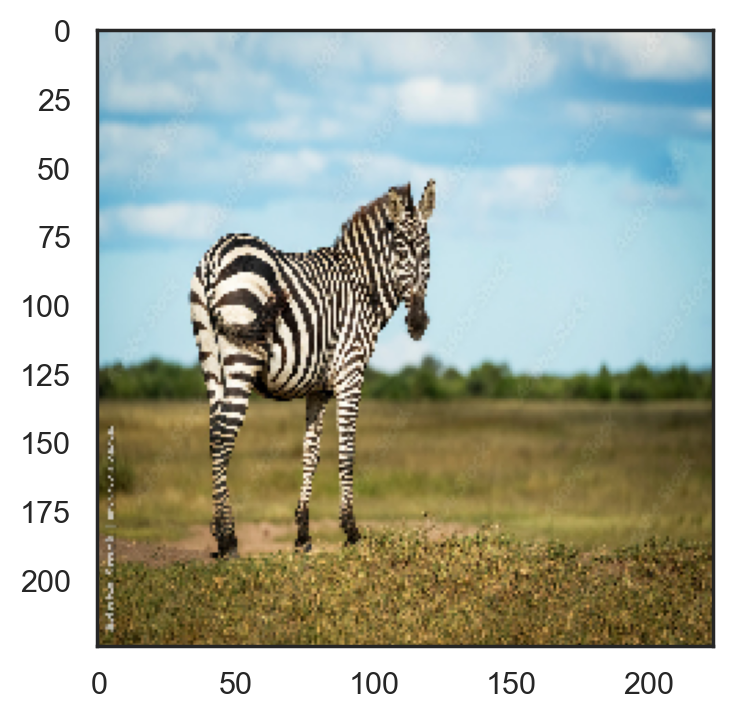

In [244]:
img = image.load_img("./sample_images/zebra.jpg", target_size=(224, 224))
plt.imshow(img)

x = image.img_to_array(img)
x = x.reshape((1, x.shape[0], x.shape[1], x.shape[2]))
x = preprocess_input(x)
preds = densenet.predict(x)
print(decode_predictions(preds))

### 7-7. NasNet

* 신경망 구조를 사람이 설계하지 않고, complete search를 통해 `자동으로 구조를 찾아냄`
* 네트워크를 구성하는 layer를 하나씩 탐색하는 NAS 방법 대신, NasNet은 Convolution cell 단위를 먼저 추정하고, 이들을 조합하여 전체 네트워크 구성
* `성능은 높지만, 파라미터 수와 연산량은 절반 정도로 감소`

In [245]:
from tensorflow.keras.applications.nasnet import (NASNetLarge, 
                                                  preprocess_input,
                                                  decode_predictions)

nasnet = NASNetLarge(include_top=True, weights="imagenet",
                     input_tensor=None, input_shape=None,
                     pooling=None, classes=1000)

nasnet.summary()

Model: "NASNet"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_19 (InputLayer)          [(None, 331, 331, 3  0           []                               
                                )]                                                                
                                                                                                  
 stem_conv1 (Conv2D)            (None, 165, 165, 96  2592        ['input_19[0][0]']               
                                )                                                                 
                                                                                                  
 stem_bn1 (BatchNormalization)  (None, 165, 165, 96  384         ['stem_conv1[0][0]']             
                                )                                                            

                                                                                                  
 separable_conv_1_pad_reduction  (None, 169, 169, 96  0          ['activation_715[0][0]']         
 _right3_stem_1 (ZeroPadding2D)  )                                                                
                                                                                                  
 activation_717 (Activation)    (None, 83, 83, 42)   0           ['reduction_add_1_stem_1[0][0]'] 
                                                                                                  
 separable_conv_1_bn_reduction_  (None, 83, 83, 42)  168         ['separable_conv_1_reduction_righ
 right2_stem_1 (BatchNormalizat                                  t2_stem_1[0][0]']                
 ion)                                                                                             
                                                                                                  
 separable

 add_32 (Add)                   (None, 83, 83, 42)   0           ['reduction_add_2_stem_1[0][0]', 
                                                                  'reduction_left4_stem_1[0][0]'] 
                                                                                                  
 reduction_add4_stem_1 (Add)    (None, 83, 83, 42)   0           ['separable_conv_2_bn_reduction_l
                                                                 eft4_stem_1[0][0]',              
                                                                  'reduction_right5_stem_1[0][0]']
                                                                                                  
 cropping2d_8 (Cropping2D)      (None, 165, 165, 96  0           ['zero_padding2d_12[0][0]']      
                                )                                                                 
                                                                                                  
 reduction

 separable_conv_2_bn_reduction_  (None, 42, 42, 84)  336         ['separable_conv_2_reduction_righ
 right1_stem_2 (BatchNormalizat                                  t1_stem_2[0][0]']                
 ion)                                                                                             
                                                                                                  
 separable_conv_1_pad_reduction  (None, 89, 89, 84)  0           ['activation_724[0][0]']         
 _right2_stem_2 (ZeroPadding2D)                                                                   
                                                                                                  
 activation_726 (Activation)    (None, 83, 83, 84)   0           ['adjust_bn_stem_2[0][0]']       
                                                                                                  
 reduction_add_1_stem_2 (Add)   (None, 42, 42, 84)   0           ['separable_conv_2_bn_reduction_l
          

                                                                                                  
 separable_conv_2_bn_reduction_  (None, 42, 42, 84)  336         ['separable_conv_2_reduction_left
 left4_stem_2 (BatchNormalizati                                  4_stem_2[0][0]']                 
 on)                                                                                              
                                                                                                  
 reduction_right5_stem_2 (MaxPo  (None, 42, 42, 84)  0           ['reduction_pad_1_stem_2[0][0]'] 
 oling2D)                                                                                         
                                                                                                  
 zero_padding2d_13 (ZeroPadding  (None, 84, 84, 168)  0          ['adjust_relu_1_0[0][0]']        
 2D)                                                                                              
          

 separable_conv_1_bn_normal_lef  (None, 42, 42, 168)  672        ['separable_conv_1_normal_left2_0
 t2_0 (BatchNormalization)                                       [0][0]']                         
                                                                                                  
 separable_conv_1_bn_normal_rig  (None, 42, 42, 168)  672        ['separable_conv_1_normal_right2_
 ht2_0 (BatchNormalization)                                      0[0][0]']                        
                                                                                                  
 separable_conv_1_bn_normal_lef  (None, 42, 42, 168)  672        ['separable_conv_1_normal_left5_0
 t5_0 (BatchNormalization)                                       [0][0]']                         
                                                                                                  
 activation_732 (Activation)    (None, 42, 42, 168)  0           ['separable_conv_1_bn_normal_left
          

 normal_concat_0 (Concatenate)  (None, 42, 42, 1008  0           ['adjust_bn_0[0][0]',            
                                )                                 'normal_add_1_0[0][0]',         
                                                                  'normal_add_2_0[0][0]',         
                                                                  'normal_add_3_0[0][0]',         
                                                                  'normal_add_4_0[0][0]',         
                                                                  'normal_add_5_0[0][0]']         
                                                                                                  
 activation_741 (Activation)    (None, 42, 42, 336)  0           ['reduction_concat_stem_2[0][0]']
                                                                                                  
 activation_742 (Activation)    (None, 42, 42, 1008  0           ['normal_concat_0[0][0]']        
          

                                                                                                  
 separable_conv_2_normal_left2_  (None, 42, 42, 168)  32424      ['activation_748[0][0]']         
 1 (SeparableConv2D)                                                                              
                                                                                                  
 separable_conv_2_normal_right2  (None, 42, 42, 168)  29736      ['activation_750[0][0]']         
 _1 (SeparableConv2D)                                                                             
                                                                                                  
 separable_conv_2_normal_left5_  (None, 42, 42, 168)  29736      ['activation_752[0][0]']         
 1 (SeparableConv2D)                                                                              
                                                                                                  
 separable

                                                                                                  
 activation_761 (Activation)    (None, 42, 42, 168)  0           ['adjust_bn_2[0][0]']            
                                                                                                  
 activation_763 (Activation)    (None, 42, 42, 168)  0           ['normal_bn_1_2[0][0]']          
                                                                                                  
 separable_conv_1_normal_left1_  (None, 42, 42, 168)  32424      ['activation_755[0][0]']         
 2 (SeparableConv2D)                                                                              
                                                                                                  
 separable_conv_1_normal_right1  (None, 42, 42, 168)  29736      ['activation_757[0][0]']         
 _2 (SeparableConv2D)                                                                             
          

 normal_right4_2 (AveragePoolin  (None, 42, 42, 168)  0          ['adjust_bn_2[0][0]']            
 g2D)                                                                                             
                                                                                                  
 separable_conv_2_bn_normal_lef  (None, 42, 42, 168)  672        ['separable_conv_2_normal_left5_2
 t5_2 (BatchNormalization)                                       [0][0]']                         
                                                                                                  
 normal_add_1_2 (Add)           (None, 42, 42, 168)  0           ['separable_conv_2_bn_normal_left
                                                                 1_2[0][0]',                      
                                                                  'separable_conv_2_bn_normal_righ
                                                                 t1_2[0][0]']                     
          

                                                                                                  
 separable_conv_1_bn_normal_rig  (None, 42, 42, 168)  672        ['separable_conv_1_normal_right2_
 ht2_3 (BatchNormalization)                                      3[0][0]']                        
                                                                                                  
 separable_conv_1_bn_normal_lef  (None, 42, 42, 168)  672        ['separable_conv_1_normal_left5_3
 t5_3 (BatchNormalization)                                       [0][0]']                         
                                                                                                  
 activation_768 (Activation)    (None, 42, 42, 168)  0           ['separable_conv_1_bn_normal_left
                                                                 1_3[0][0]']                      
                                                                                                  
 activatio

                                                                  'normal_add_2_3[0][0]',         
                                                                  'normal_add_3_3[0][0]',         
                                                                  'normal_add_4_3[0][0]',         
                                                                  'normal_add_5_3[0][0]']         
                                                                                                  
 activation_777 (Activation)    (None, 42, 42, 1008  0           ['normal_concat_2[0][0]']        
                                )                                                                 
                                                                                                  
 activation_778 (Activation)    (None, 42, 42, 1008  0           ['normal_concat_3[0][0]']        
                                )                                                                 
          

 separable_conv_2_normal_left2_  (None, 42, 42, 168)  32424      ['activation_784[0][0]']         
 4 (SeparableConv2D)                                                                              
                                                                                                  
 separable_conv_2_normal_right2  (None, 42, 42, 168)  29736      ['activation_786[0][0]']         
 _4 (SeparableConv2D)                                                                             
                                                                                                  
 separable_conv_2_normal_left5_  (None, 42, 42, 168)  29736      ['activation_788[0][0]']         
 4 (SeparableConv2D)                                                                              
                                                                                                  
 separable_conv_2_bn_normal_lef  (None, 42, 42, 168)  672        ['separable_conv_2_normal_left1_4
 t1_4 (Bat

 activation_797 (Activation)    (None, 42, 42, 168)  0           ['adjust_bn_5[0][0]']            
                                                                                                  
 activation_799 (Activation)    (None, 42, 42, 168)  0           ['normal_bn_1_5[0][0]']          
                                                                                                  
 separable_conv_1_normal_left1_  (None, 42, 42, 168)  32424      ['activation_791[0][0]']         
 5 (SeparableConv2D)                                                                              
                                                                                                  
 separable_conv_1_normal_right1  (None, 42, 42, 168)  29736      ['activation_793[0][0]']         
 _5 (SeparableConv2D)                                                                             
                                                                                                  
 separable

 g2D)                                                                                             
                                                                                                  
 separable_conv_2_bn_normal_lef  (None, 42, 42, 168)  672        ['separable_conv_2_normal_left5_5
 t5_5 (BatchNormalization)                                       [0][0]']                         
                                                                                                  
 normal_add_1_5 (Add)           (None, 42, 42, 168)  0           ['separable_conv_2_bn_normal_left
                                                                 1_5[0][0]',                      
                                                                  'separable_conv_2_bn_normal_righ
                                                                 t1_5[0][0]']                     
                                                                                                  
 normal_ad

 t1_reduce_6 (SeparableConv2D)                                                                    
                                                                                                  
 separable_conv_2_reduction_rig  (None, 21, 21, 336)  129360     ['activation_806[0][0]']         
 ht1_reduce_6 (SeparableConv2D)                                                                   
                                                                                                  
 activation_807 (Activation)    (None, 42, 42, 336)  0           ['adjust_bn_reduce_6[0][0]']     
                                                                                                  
 separable_conv_2_bn_reduction_  (None, 21, 21, 336)  1344       ['separable_conv_2_reduction_left
 left1_reduce_6 (BatchNormaliza                                  1_reduce_6[0][0]']               
 tion)                                                                                            
          

                                )                                                                 
                                                                                                  
 reduction_add_2_reduce_6 (Add)  (None, 21, 21, 336)  0          ['reduction_left2_reduce_6[0][0]'
                                                                 , 'separable_conv_2_bn_reduction_
                                                                 right2_reduce_6[0][0]']          
                                                                                                  
 reduction_left3_reduce_6 (Aver  (None, 21, 21, 336)  0          ['reduction_pad_1_reduce_6[0][0]'
 agePooling2D)                                                   ]                                
                                                                                                  
 separable_conv_2_bn_reduction_  (None, 21, 21, 336)  1344       ['separable_conv_2_reduction_righ
 right3_re

                                                                                                  
 separable_conv_1_normal_right1  (None, 21, 21, 336)  115920     ['activation_816[0][0]']         
 _7 (SeparableConv2D)                                                                             
                                                                                                  
 separable_conv_1_normal_left2_  (None, 21, 21, 336)  121296     ['activation_818[0][0]']         
 7 (SeparableConv2D)                                                                              
                                                                                                  
 separable_conv_1_normal_right2  (None, 21, 21, 336)  115920     ['activation_820[0][0]']         
 _7 (SeparableConv2D)                                                                             
                                                                                                  
 separable

                                                                 1_7[0][0]',                      
                                                                  'separable_conv_2_bn_normal_righ
                                                                 t1_7[0][0]']                     
                                                                                                  
 normal_add_2_7 (Add)           (None, 21, 21, 336)  0           ['separable_conv_2_bn_normal_left
                                                                 2_7[0][0]',                      
                                                                  'separable_conv_2_bn_normal_righ
                                                                 t2_7[0][0]']                     
                                                                                                  
 normal_add_3_7 (Add)           (None, 21, 21, 336)  0           ['normal_left3_7[0][0]',         
          

 activation_827 (Activation)    (None, 21, 21, 336)  0           ['separable_conv_1_bn_normal_left
                                                                 1_8[0][0]']                      
                                                                                                  
 activation_829 (Activation)    (None, 21, 21, 336)  0           ['separable_conv_1_bn_normal_righ
                                                                 t1_8[0][0]']                     
                                                                                                  
 activation_831 (Activation)    (None, 21, 21, 336)  0           ['separable_conv_1_bn_normal_left
                                                                 2_8[0][0]']                      
                                                                                                  
 activation_833 (Activation)    (None, 21, 21, 336)  0           ['separable_conv_1_bn_normal_righ
          

                                                                                                  
 activation_837 (Activation)    (None, 21, 21, 2016  0           ['normal_concat_8[0][0]']        
                                )                                                                 
                                                                                                  
 adjust_conv_projection_9 (Conv  (None, 21, 21, 336)  677376     ['activation_836[0][0]']         
 2D)                                                                                              
                                                                                                  
 normal_conv_1_9 (Conv2D)       (None, 21, 21, 336)  677376      ['activation_837[0][0]']         
                                                                                                  
 adjust_bn_9 (BatchNormalizatio  (None, 21, 21, 336)  1344       ['adjust_conv_projection_9[0][0]'
 n)       

 9 (SeparableConv2D)                                                                              
                                                                                                  
 separable_conv_2_bn_normal_lef  (None, 21, 21, 336)  1344       ['separable_conv_2_normal_left1_9
 t1_9 (BatchNormalization)                                       [0][0]']                         
                                                                                                  
 separable_conv_2_bn_normal_rig  (None, 21, 21, 336)  1344       ['separable_conv_2_normal_right1_
 ht1_9 (BatchNormalization)                                      9[0][0]']                        
                                                                                                  
 separable_conv_2_bn_normal_lef  (None, 21, 21, 336)  1344       ['separable_conv_2_normal_left2_9
 t2_9 (BatchNormalization)                                       [0][0]']                         
          

 separable_conv_1_normal_right1  (None, 21, 21, 336)  115920     ['activation_852[0][0]']         
 _10 (SeparableConv2D)                                                                            
                                                                                                  
 separable_conv_1_normal_left2_  (None, 21, 21, 336)  121296     ['activation_854[0][0]']         
 10 (SeparableConv2D)                                                                             
                                                                                                  
 separable_conv_1_normal_right2  (None, 21, 21, 336)  115920     ['activation_856[0][0]']         
 _10 (SeparableConv2D)                                                                            
                                                                                                  
 separable_conv_1_normal_left5_  (None, 21, 21, 336)  115920     ['activation_858[0][0]']         
 10 (Separ

                                                                  'separable_conv_2_bn_normal_righ
                                                                 t1_10[0][0]']                    
                                                                                                  
 normal_add_2_10 (Add)          (None, 21, 21, 336)  0           ['separable_conv_2_bn_normal_left
                                                                 2_10[0][0]',                     
                                                                  'separable_conv_2_bn_normal_righ
                                                                 t2_10[0][0]']                    
                                                                                                  
 normal_add_3_10 (Add)          (None, 21, 21, 336)  0           ['normal_left3_10[0][0]',        
                                                                  'adjust_bn_10[0][0]']           
          

                                                                 1_11[0][0]']                     
                                                                                                  
 activation_865 (Activation)    (None, 21, 21, 336)  0           ['separable_conv_1_bn_normal_righ
                                                                 t1_11[0][0]']                    
                                                                                                  
 activation_867 (Activation)    (None, 21, 21, 336)  0           ['separable_conv_1_bn_normal_left
                                                                 2_11[0][0]']                     
                                                                                                  
 activation_869 (Activation)    (None, 21, 21, 336)  0           ['separable_conv_1_bn_normal_righ
                                                                 t2_11[0][0]']                    
          

 activation_873 (Activation)    (None, 21, 21, 2016  0           ['normal_concat_11[0][0]']       
                                )                                                                 
                                                                                                  
 adjust_conv_projection_12 (Con  (None, 21, 21, 336)  677376     ['activation_872[0][0]']         
 v2D)                                                                                             
                                                                                                  
 normal_conv_1_12 (Conv2D)      (None, 21, 21, 336)  677376      ['activation_873[0][0]']         
                                                                                                  
 adjust_bn_12 (BatchNormalizati  (None, 21, 21, 336)  1344       ['adjust_conv_projection_12[0][0]
 on)                                                             ']                               
          

                                                                                                  
 separable_conv_2_bn_normal_lef  (None, 21, 21, 336)  1344       ['separable_conv_2_normal_left1_1
 t1_12 (BatchNormalization)                                      2[0][0]']                        
                                                                                                  
 separable_conv_2_bn_normal_rig  (None, 21, 21, 336)  1344       ['separable_conv_2_normal_right1_
 ht1_12 (BatchNormalization)                                     12[0][0]']                       
                                                                                                  
 separable_conv_2_bn_normal_lef  (None, 21, 21, 336)  1344       ['separable_conv_2_normal_left2_1
 t2_12 (BatchNormalization)                                      2[0][0]']                        
                                                                                                  
 separable

 separable_conv_1_reduction_lef  (None, 11, 11, 672)  468384     ['separable_conv_1_pad_reduction_
 t1_reduce_12 (SeparableConv2D)                                  left1_reduce_12[0][0]']          
                                                                                                  
 separable_conv_1_reduction_rig  (None, 11, 11, 672)  484512     ['separable_conv_1_pad_reduction_
 ht1_reduce_12 (SeparableConv2D                                  right1_reduce_12[0][0]']         
 )                                                                                                
                                                                                                  
 separable_conv_1_bn_reduction_  (None, 11, 11, 672)  2688       ['separable_conv_1_reduction_left
 left1_reduce_12 (BatchNormaliz                                  1_reduce_12[0][0]']              
 ation)                                                                                           
          

 oPadding2D)                                                     ]                                
                                                                                                  
 separable_conv_2_reduction_rig  (None, 11, 11, 672)  484512     ['activation_891[0][0]']         
 ht2_reduce_12 (SeparableConv2D                                                                   
 )                                                                                                
                                                                                                  
 activation_893 (Activation)    (None, 11, 11, 672)  0           ['separable_conv_1_bn_reduction_r
                                                                 ight3_reduce_12[0][0]']          
                                                                                                  
 activation_895 (Activation)    (None, 11, 11, 672)  0           ['separable_conv_1_bn_reduction_l
          

 ooling2D)                      )                                                                 
                                                                                                  
 adjust_conv_1_13 (Conv2D)      (None, 11, 11, 336)  677376      ['adjust_avg_pool_1_13[0][0]']   
                                                                                                  
 adjust_conv_2_13 (Conv2D)      (None, 11, 11, 336)  677376      ['adjust_avg_pool_2_13[0][0]']   
                                                                                                  
 activation_896 (Activation)    (None, 11, 11, 2688  0           ['reduction_concat_reduce_12[0][0
                                )                                ]']                              
                                                                                                  
 concatenate_15 (Concatenate)   (None, 11, 11, 672)  0           ['adjust_conv_1_13[0][0]',       
          

                                                                                                  
 separable_conv_2_normal_right2  (None, 11, 11, 672)  457632     ['activation_904[0][0]']         
 _13 (SeparableConv2D)                                                                            
                                                                                                  
 separable_conv_2_normal_left5_  (None, 11, 11, 672)  457632     ['activation_906[0][0]']         
 13 (SeparableConv2D)                                                                             
                                                                                                  
 separable_conv_2_bn_normal_lef  (None, 11, 11, 672)  2688       ['separable_conv_2_normal_left1_1
 t1_13 (BatchNormalization)                                      3[0][0]']                        
                                                                                                  
 separable

 activation_917 (Activation)    (None, 11, 11, 672)  0           ['normal_bn_1_14[0][0]']         
                                                                                                  
 separable_conv_1_normal_left1_  (None, 11, 11, 672)  468384     ['activation_909[0][0]']         
 14 (SeparableConv2D)                                                                             
                                                                                                  
 separable_conv_1_normal_right1  (None, 11, 11, 672)  457632     ['activation_911[0][0]']         
 _14 (SeparableConv2D)                                                                            
                                                                                                  
 separable_conv_1_normal_left2_  (None, 11, 11, 672)  468384     ['activation_913[0][0]']         
 14 (SeparableConv2D)                                                                             
          

 separable_conv_2_bn_normal_lef  (None, 11, 11, 672)  2688       ['separable_conv_2_normal_left5_1
 t5_14 (BatchNormalization)                                      4[0][0]']                        
                                                                                                  
 normal_add_1_14 (Add)          (None, 11, 11, 672)  0           ['separable_conv_2_bn_normal_left
                                                                 1_14[0][0]',                     
                                                                  'separable_conv_2_bn_normal_righ
                                                                 t1_14[0][0]']                    
                                                                                                  
 normal_add_2_14 (Add)          (None, 11, 11, 672)  0           ['separable_conv_2_bn_normal_left
                                                                 2_14[0][0]',                     
          

                                                                                                  
 separable_conv_1_bn_normal_lef  (None, 11, 11, 672)  2688       ['separable_conv_1_normal_left5_1
 t5_15 (BatchNormalization)                                      5[0][0]']                        
                                                                                                  
 activation_922 (Activation)    (None, 11, 11, 672)  0           ['separable_conv_1_bn_normal_left
                                                                 1_15[0][0]']                     
                                                                                                  
 activation_924 (Activation)    (None, 11, 11, 672)  0           ['separable_conv_1_bn_normal_righ
                                                                 t1_15[0][0]']                    
                                                                                                  
 activatio

                                                                  'normal_add_5_15[0][0]']        
                                                                                                  
 activation_931 (Activation)    (None, 11, 11, 4032  0           ['normal_concat_14[0][0]']       
                                )                                                                 
                                                                                                  
 activation_932 (Activation)    (None, 11, 11, 4032  0           ['normal_concat_15[0][0]']       
                                )                                                                 
                                                                                                  
 adjust_conv_projection_16 (Con  (None, 11, 11, 672)  2709504    ['activation_931[0][0]']         
 v2D)                                                                                             
          

 separable_conv_2_normal_right2  (None, 11, 11, 672)  457632     ['activation_940[0][0]']         
 _16 (SeparableConv2D)                                                                            
                                                                                                  
 separable_conv_2_normal_left5_  (None, 11, 11, 672)  457632     ['activation_942[0][0]']         
 16 (SeparableConv2D)                                                                             
                                                                                                  
 separable_conv_2_bn_normal_lef  (None, 11, 11, 672)  2688       ['separable_conv_2_normal_left1_1
 t1_16 (BatchNormalization)                                      6[0][0]']                        
                                                                                                  
 separable_conv_2_bn_normal_rig  (None, 11, 11, 672)  2688       ['separable_conv_2_normal_right1_
 ht1_16 (B

                                                                                                  
 separable_conv_1_normal_left1_  (None, 11, 11, 672)  468384     ['activation_945[0][0]']         
 17 (SeparableConv2D)                                                                             
                                                                                                  
 separable_conv_1_normal_right1  (None, 11, 11, 672)  457632     ['activation_947[0][0]']         
 _17 (SeparableConv2D)                                                                            
                                                                                                  
 separable_conv_1_normal_left2_  (None, 11, 11, 672)  468384     ['activation_949[0][0]']         
 17 (SeparableConv2D)                                                                             
                                                                                                  
 separable

 t5_17 (BatchNormalization)                                      7[0][0]']                        
                                                                                                  
 normal_add_1_17 (Add)          (None, 11, 11, 672)  0           ['separable_conv_2_bn_normal_left
                                                                 1_17[0][0]',                     
                                                                  'separable_conv_2_bn_normal_righ
                                                                 t1_17[0][0]']                    
                                                                                                  
 normal_add_2_17 (Add)          (None, 11, 11, 672)  0           ['separable_conv_2_bn_normal_left
                                                                 2_17[0][0]',                     
                                                                  'separable_conv_2_bn_normal_righ
          

 separable_conv_1_bn_normal_lef  (None, 11, 11, 672)  2688       ['separable_conv_1_normal_left5_1
 t5_18 (BatchNormalization)                                      8[0][0]']                        
                                                                                                  
 activation_958 (Activation)    (None, 11, 11, 672)  0           ['separable_conv_1_bn_normal_left
                                                                 1_18[0][0]']                     
                                                                                                  
 activation_960 (Activation)    (None, 11, 11, 672)  0           ['separable_conv_1_bn_normal_righ
                                                                 t1_18[0][0]']                    
                                                                                                  
 activation_962 (Activation)    (None, 11, 11, 672)  0           ['separable_conv_1_bn_normal_left
          

                                                                                                  
 activation_967 (Activation)    (None, 11, 11, 4032  0           ['normal_concat_18[0][0]']       
                                )                                                                 
                                                                                                  
 global_average_pooling2d_4 (Gl  (None, 4032)        0           ['activation_967[0][0]']         
 obalAveragePooling2D)                                                                            
                                                                                                  
 predictions (Dense)            (None, 1000)         4033000     ['global_average_pooling2d_4[0][0
                                                                 ]']                              
                                                                                                  
Total para

In [246]:
plot_model(nasnet, to_file="plot_nasnet.png")

* notebook.jpg 
- https://www.publicdomainpictures.net/pictures/160000/velka/poste-de-travail-pc-portable-cafe.jpg

In [81]:
img_url = "https://media.wired.com/photos/64daad6b4a854832b16fd3bc/master/w_960,c_limit/How-to-Choose-a-Laptop-August-2023-Gear.jpg"

wget.download(img_url, out="./sample_images/laptop.jpg")

'./sample_images/laptop.jpg'

1/1 [==============================] - 8s 8s/step
[[('n03832673', 'notebook', 0.65498596), ('n03642806', 'laptop', 0.09138992), ('n04264628', 'space_bar', 0.016105317), ('n04152593', 'screen', 0.015357552), ('n03777754', 'modem', 0.014852982)]]


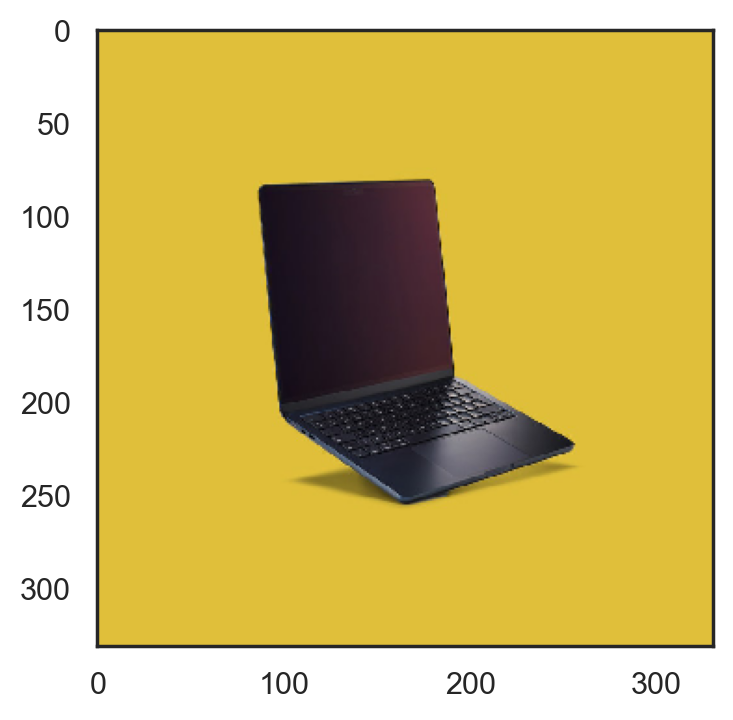

In [247]:
img = image.load_img("./sample_images/laptop.jpg", target_size=(331, 331))
plt.imshow(img)

x = image.img_to_array(img)
x = x.reshape((1, x.shape[0], x.shape[1], x.shape[2]))
x = preprocess_input(x)
preds = nasnet.predict(x)
print(decode_predictions(preds))

## 7-8. EfficientNet

* EfficientNetB0인 작은 모델에서 주어진 Task에 최적화된 구조로 수정해나가는 형태
* 복잡한 Task에 맞춰 모델의 Capacity를 늘리기 위해 Wide Scaling, Deep Scaling, 그리고 Resolution Scaling을 사용
* EfficientNet은 Wide, Deep, Resolution을 함께 고려하는 Compound Scaling을 사용

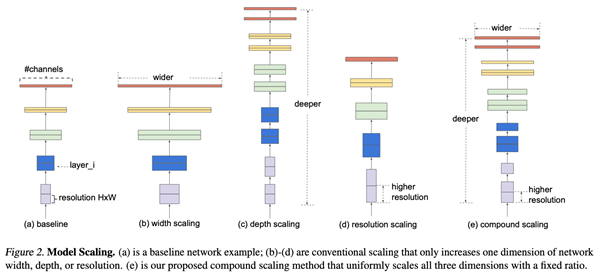

In [248]:
from tensorflow.keras.applications.efficientnet import (EfficientNetB1, 
                                                        preprocess_input,
                                                        decode_predictions)

effi_net = EfficientNetB1(include_top=True, weights="imagenet",
                          input_tensor=None, input_shape=None,
                          pooling=None, classes=1000)

effi_net.summary()

Model: "efficientnetb1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_20 (InputLayer)          [(None, 240, 240, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling_2 (Rescaling)        (None, 240, 240, 3)  0           ['input_20[0][0]']               
                                                                                                  
 normalization_1 (Normalization  (None, 240, 240, 3)  7          ['rescaling_2[0][0]']            
 )                                                                                                
                                                                                     

                                                                                                  
 block2a_expand_conv (Conv2D)   (None, 120, 120, 96  1536        ['block1b_add[0][0]']            
                                )                                                                 
                                                                                                  
 block2a_expand_bn (BatchNormal  (None, 120, 120, 96  384        ['block2a_expand_conv[0][0]']    
 ization)                       )                                                                 
                                                                                                  
 block2a_expand_activation (Act  (None, 120, 120, 96  0          ['block2a_expand_bn[0][0]']      
 ivation)                       )                                                                 
                                                                                                  
 block2a_d

 block2c_expand_activation (Act  (None, 60, 60, 144)  0          ['block2c_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block2c_dwconv (DepthwiseConv2  (None, 60, 60, 144)  1296       ['block2c_expand_activation[0][0]
 D)                                                              ']                               
                                                                                                  
 block2c_bn (BatchNormalization  (None, 60, 60, 144)  576        ['block2c_dwconv[0][0]']         
 )                                                                                                
                                                                                                  
 block2c_activation (Activation  (None, 60, 60, 144)  0          ['block2c_bn[0][0]']             
 )        

 )                                                                                                
                                                                                                  
 block3b_activation (Activation  (None, 30, 30, 240)  0          ['block3b_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block3b_se_squeeze (GlobalAver  (None, 240)         0           ['block3b_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block3b_se_reshape (Reshape)   (None, 1, 1, 240)    0           ['block3b_se_squeeze[0][0]']     
                                                                                                  
 block3b_s

 block4a_activation (Activation  (None, 15, 15, 240)  0          ['block4a_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block4a_se_squeeze (GlobalAver  (None, 240)         0           ['block4a_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block4a_se_reshape (Reshape)   (None, 1, 1, 240)    0           ['block4a_se_squeeze[0][0]']     
                                                                                                  
 block4a_se_reduce (Conv2D)     (None, 1, 1, 10)     2410        ['block4a_se_reshape[0][0]']     
                                                                                                  
 block4a_s

 block4c_se_expand (Conv2D)     (None, 1, 1, 480)    10080       ['block4c_se_reduce[0][0]']      
                                                                                                  
 block4c_se_excite (Multiply)   (None, 15, 15, 480)  0           ['block4c_activation[0][0]',     
                                                                  'block4c_se_expand[0][0]']      
                                                                                                  
 block4c_project_conv (Conv2D)  (None, 15, 15, 80)   38400       ['block4c_se_excite[0][0]']      
                                                                                                  
 block4c_project_bn (BatchNorma  (None, 15, 15, 80)  320         ['block4c_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block4c_d

 block5a_project_conv (Conv2D)  (None, 15, 15, 112)  53760       ['block5a_se_excite[0][0]']      
                                                                                                  
 block5a_project_bn (BatchNorma  (None, 15, 15, 112)  448        ['block5a_project_conv[0][0]']   
 lization)                                                                                        
                                                                                                  
 block5b_expand_conv (Conv2D)   (None, 15, 15, 672)  75264       ['block5a_project_bn[0][0]']     
                                                                                                  
 block5b_expand_bn (BatchNormal  (None, 15, 15, 672)  2688       ['block5b_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block5b_e

 block5d_expand_conv (Conv2D)   (None, 15, 15, 672)  75264       ['block5c_add[0][0]']            
                                                                                                  
 block5d_expand_bn (BatchNormal  (None, 15, 15, 672)  2688       ['block5d_expand_conv[0][0]']    
 ization)                                                                                         
                                                                                                  
 block5d_expand_activation (Act  (None, 15, 15, 672)  0          ['block5d_expand_bn[0][0]']      
 ivation)                                                                                         
                                                                                                  
 block5d_dwconv (DepthwiseConv2  (None, 15, 15, 672)  16800      ['block5d_expand_activation[0][0]
 D)                                                              ']                               
          

                                                                                                  
 block6b_dwconv (DepthwiseConv2  (None, 8, 8, 1152)  28800       ['block6b_expand_activation[0][0]
 D)                                                              ']                               
                                                                                                  
 block6b_bn (BatchNormalization  (None, 8, 8, 1152)  4608        ['block6b_dwconv[0][0]']         
 )                                                                                                
                                                                                                  
 block6b_activation (Activation  (None, 8, 8, 1152)  0           ['block6b_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block6b_s

 )                                                                                                
                                                                                                  
 block6d_activation (Activation  (None, 8, 8, 1152)  0           ['block6d_bn[0][0]']             
 )                                                                                                
                                                                                                  
 block6d_se_squeeze (GlobalAver  (None, 1152)        0           ['block6d_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block6d_se_reshape (Reshape)   (None, 1, 1, 1152)   0           ['block6d_se_squeeze[0][0]']     
                                                                                                  
 block6d_s

 block7a_se_squeeze (GlobalAver  (None, 1152)        0           ['block7a_activation[0][0]']     
 agePooling2D)                                                                                    
                                                                                                  
 block7a_se_reshape (Reshape)   (None, 1, 1, 1152)   0           ['block7a_se_squeeze[0][0]']     
                                                                                                  
 block7a_se_reduce (Conv2D)     (None, 1, 1, 48)     55344       ['block7a_se_reshape[0][0]']     
                                                                                                  
 block7a_se_expand (Conv2D)     (None, 1, 1, 1152)   56448       ['block7a_se_reduce[0][0]']      
                                                                                                  
 block7a_se_excite (Multiply)   (None, 8, 8, 1152)   0           ['block7a_activation[0][0]',     
          

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.982578 to fit



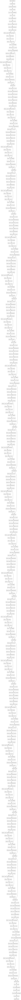

In [85]:
plot_model(effi_net)

* plane.jpg 
- https://c02.purpledshub.com/uploads/sites/41/2023/07/global-8000-Hero-8af5a4d.jpg?w=728&webp=1

In [87]:
img_url = "https://c02.purpledshub.com/uploads/sites/41/2023/07/global-8000-Hero-8af5a4d.jpg?w=728&webp=1"

wget.download(img_url, out="./sample_images/plane.jpg")

'./sample_images/plane.jpg'

1/1 [==============================] - 2s 2s/step
[[('n02690373', 'airliner', 0.5966165), ('n04552348', 'warplane', 0.07884412), ('n04592741', 'wing', 0.0730128), ('n04266014', 'space_shuttle', 0.039914917), ('n02692877', 'airship', 0.010541568)]]


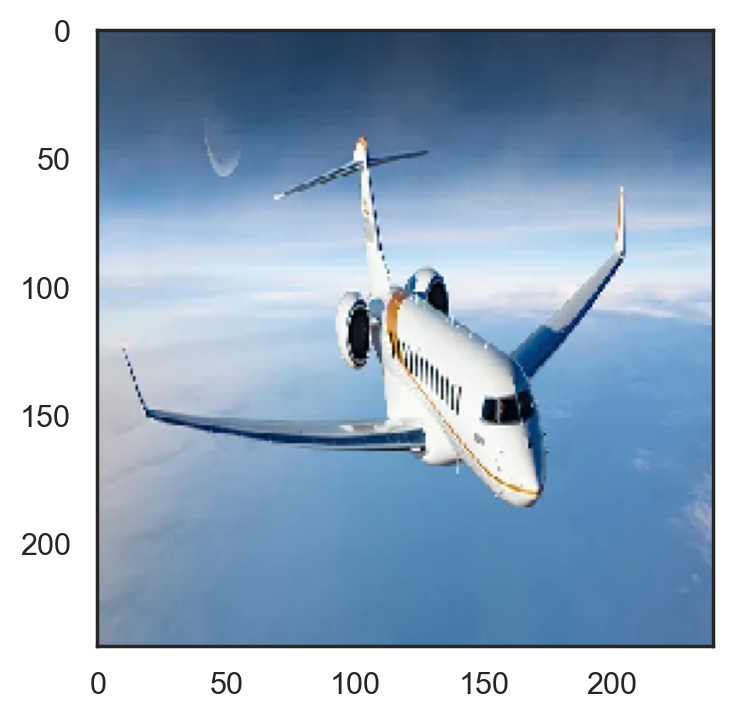

In [249]:
img = image.load_img("./sample_images/plane.jpg", target_size=(240, 240))
plt.imshow(img)

x = image.img_to_array(img)
x = x.reshape((1, x.shape[0], x.shape[1], x.shape[2]))
x = preprocess_input(x)
preds = effi_net.predict(x)
print(decode_predictions(preds))

### 7-9. CNN 모델의 예측 확률 비교

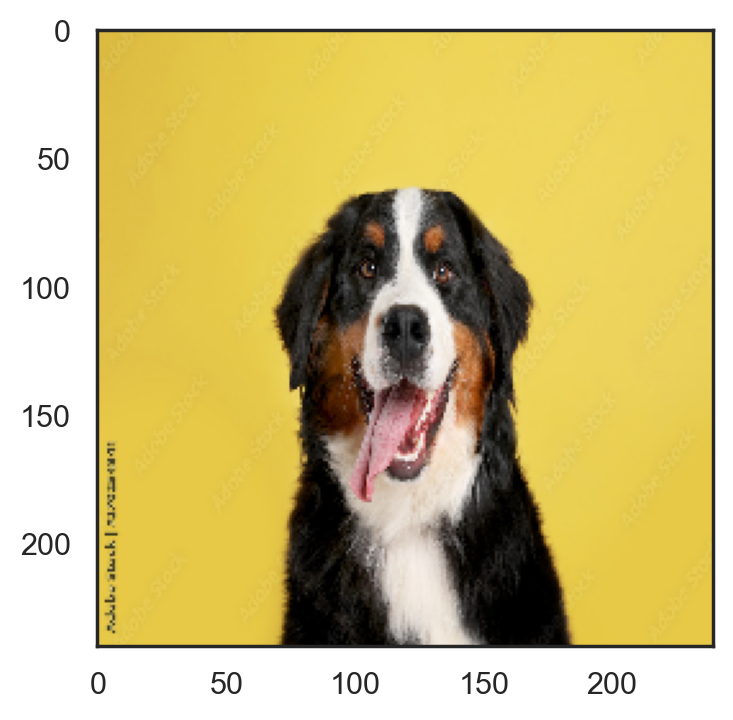

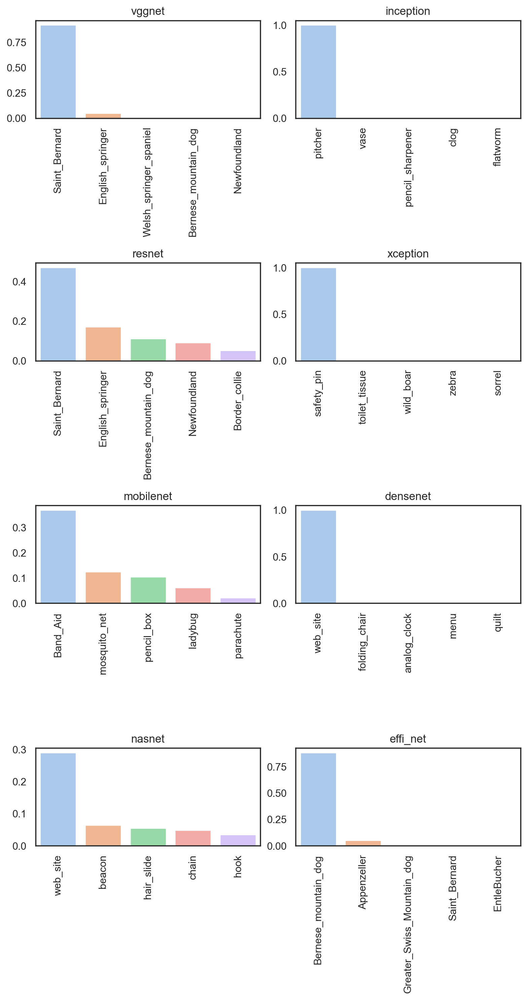

In [250]:
cnns = [vggnet, inception, resnet, xception, mobilenet, densenet, nasnet, effi_net]
cnns_names = ["vggnet", "inception", "resnet", 
              "xception", "mobilenet", "densenet", "nasnet", "effi_net"]

sample_img = "./sample_images/dog.jpg"
temp_img = image.load_img(sample_img, target_size=(240, 240))
plt.imshow(temp_img)

fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(8, 15))
axes = axes.flatten()

for i, m in enumerate(cnns) : 
    shape = tuple(m.input.get_shape())[1:-1]
    img = image.load_img(sample_img, target_size=shape)
    x = image.img_to_array(img)
    x = x.reshape((1, x.shape[0], x.shape[1], x.shape[2]))
    x = preprocess_input(x)
    preds = m.predict(x, verbose=0)
    proba_df = pd.DataFrame(decode_predictions(preds)[0], 
                            columns=["num", "cate", "proba"])
    ax = axes[i]
    g = sns.barplot(
        data=proba_df,
        x=proba_df["cate"],
        y=proba_df["proba"],
        palette="pastel",
        #height=3,
        #aspect=1,
        #kind="bar",
        ax=ax
    )
    g.set_xticklabels(proba_df["cate"], rotation=90, fontsize=11)
    g.set(title=f"{cnns_names[i]}", xlabel=None, ylabel=None)

plt.tight_layout()
plt.show() ; 

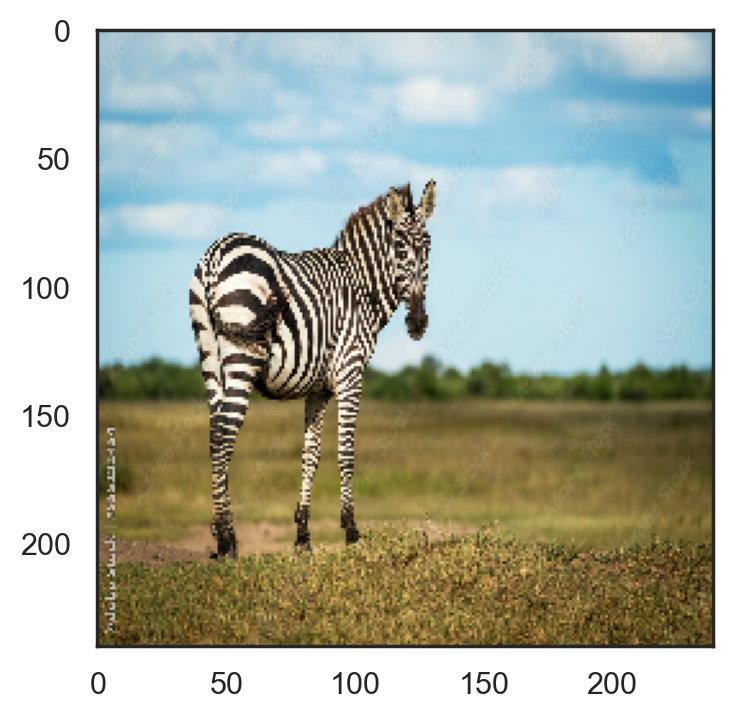

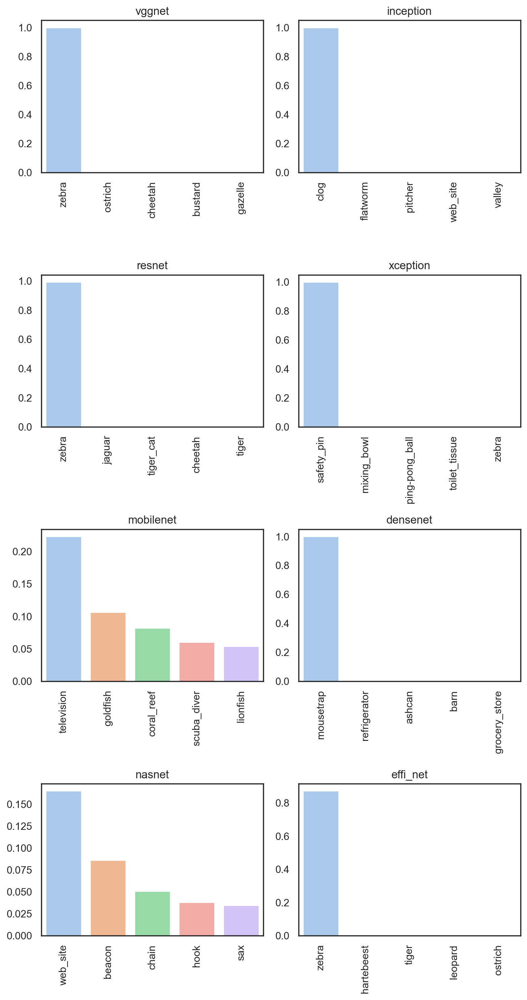

In [251]:
cnns = [vggnet, inception, resnet, xception, mobilenet, densenet, nasnet, effi_net]
cnns_names = ["vggnet", "inception", "resnet", 
              "xception", "mobilenet", "densenet", "nasnet", "effi_net"]

sample_img = "./sample_images/zebra.jpg"
temp_img = image.load_img(sample_img, target_size=(240, 240))
plt.imshow(temp_img)

fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(8, 15))
axes = axes.flatten()

for i, m in enumerate(cnns) : 
    shape = tuple(m.input.get_shape())[1:-1]
    img = image.load_img(sample_img, target_size=shape)
    x = image.img_to_array(img)
    x = x.reshape((1, x.shape[0], x.shape[1], x.shape[2]))
    x = preprocess_input(x)
    preds = m.predict(x, verbose=0)
    proba_df = pd.DataFrame(decode_predictions(preds)[0], 
                            columns=["num", "cate", "proba"])
    ax = axes[i]
    g = sns.barplot(
        data=proba_df,
        x=proba_df["cate"],
        y=proba_df["proba"],
        palette="pastel",
        #height=3,
        #aspect=1,
        #kind="bar",
        ax=ax
    )
    g.set_xticklabels(proba_df["cate"], rotation=90, fontsize=11)
    g.set(title=f"{cnns_names[i]}", xlabel=None, ylabel=None)

plt.tight_layout()
plt.show() ; 